# Innoplexus Online Hiring Hackathon: Sentiment Analysis

- https://datahack.analyticsvidhya.com/contest/innoplexus-online-hiring-hackathon/
- https://www.machinelearningplus.com/nlp/gensim-tutorial/  *Check out this tutorial on gensim*  

# Problem Statement

## Sentiment Analysis for drugs/medicines

Nowadays the narrative of a brand is not only built and controlled by the company that owns the brand. For this reason, companies are constantly looking out across Blogs, Forums, and other social media platforms, etc for checking the sentiment for their various products and also competitor products to learn how their brand resonates in the market. This kind of analysis helps them as part of their post-launch market research. This is relevant for a lot of industries including pharma and their drugs.
 

The challenge is that the language used in this type of content is not strictly grammatically correct. Some use sarcasm. Others cover several topics with different sentiments in one post. Other users post comments and reply and thereby indicating his/her sentiment around the topic.

Sentiment can be clubbed into 3 major buckets - Positive, Negative and Neutral Sentiments.

 

You are provided with data containing samples of text. This text can contain one or more drug mentions. Each row contains a unique combination of the text and the drug mention. Note that the same text can also have different sentiment for a different drug.

Given the text and drug name, the task is to predict the sentiment for texts contained in the test dataset. Given below is an example of text from the dataset:

 

Example:

*Stelara is still fairly new to Crohn's treatment. This is why you might not get a lot of replies. I've done some research, but most of the "time to work" answers are from Psoriasis boards. For Psoriasis, it seems to be about 4-12 weeks to reach a strong therapeutic level. The good news is, Stelara seems to be getting rave reviews from Crohn's patients. It seems to be the best med to come along since Remicade. I hope you have good success with it. My daughter was diagnosed Feb. 19/07, (13 yrs. old at the time of diagnosis), with Crohn's of the Terminal Illium. Has used Prednisone and Pentasa. Started Imuran (02/09), had an abdominal abscess (12/08). 2cm of Stricture. Started ​Remicade in Feb. 2014, along with 100mgs. of Imuran.*

For Stelara the above text is ​positive​ while for Remicade the above text is ​negative​.

*TRAIN DATA*  
unique_hash - 	Unique ID  
text	    -   text pertaining to the drugs  
drug	    -   drug name for which the sentiment is provided  
sentiment	-   (Target) 0-positive, 1-negative, 2-neutral  

# Tokenization
- http://feedproxy.google.com/~r/AnalyticsVidhya/~3/HijRs9SFo-8/?utm_source=feedburner&utm_medium=email

In [1]:
# more common imports
import pandas as pd
import numpy as np
from collections import Counter
import re

# languange processing imports
import nltk
from gensim.corpora import Dictionary
# preprocessing imports
from sklearn.preprocessing import LabelEncoder

# model imports
from gensim.models.ldamulticore import LdaMulticore
from gensim.models.word2vec import Word2Vec
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.linear_model import LogisticRegression
# hyperparameter training imports
from sklearn.model_selection import GridSearchCV
from sklearn.decomposition import LatentDirichletAllocation

# visualization imports
from IPython.display import display
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import base64
import io
%matplotlib inline
sns.set()  # defines the style of the plots to be seaborn style

##pretty print
import pprint as pp


C:\Users\tshrs\Anaconda3\lib\site-packages\gensim\utils.py:1197: UserWarning: detected Windows; aliasing chunkize to chunkize_serial
  warnings.warn("detected Windows; aliasing chunkize to chunkize_serial")
C:\Users\tshrs\Anaconda3\lib\site-packages\sklearn\ensemble\weight_boosting.py:29: DeprecationWarning: numpy.core.umath_tests is an internal NumPy module and should not be imported. It will be removed in a future NumPy release.
  from numpy.core.umath_tests import inner1d


In [2]:
import logging
logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.INFO)

In [3]:
pd.set_option('max_colwidth', -1)

In [4]:
data_train = pd.read_csv('train.csv')
print(data_train.shape)
data_train.head()

(5279, 4)


,unique_hash,text,drug,sentiment
0,2e180be4c9214c1f5ab51fd8cc32bc80c9f612e0,"Autoimmune diseases tend to come in clusters. As for Gilenya – if you feel good, don’t think about it, it won’t change anything but waste your time and energy. I’m taking Tysabri and feel amazing, no symptoms (other than dodgy color vision, but I’ve had it since always, so, don’t know) and I don’t know if it will last a month, a year, a decade, ive just decided to enjoy the ride, no point in worrying.",gilenya,2
1,9eba8f80e7e20f3a2f48685530748fbfa95943e4,"I can completely understand why you’d want to try it. But, results reported in lectures don’t always stand up to the scrutiny of peer-review during publication. There so much still to do before this is convincing. I hope that it does work out, I really do. And if you’re aware of and happy with the risks, then that’s great. I just think it’s important to present this in a balanced way, and to understand why we don’t move straight from the first show of promise in an animal study to using drugs on humans. There’s still a lot of animal data to gather, and human data to gather before anyone can tell if it’s safe or effective. I can’t tell you how many times animal studies don’t follow through to humans, but it’s one of the major attrition points in drug development. You’ve been through some of the unpredictability issues with Cladribine/Gilenya, where there was an interaction that wasn’t predicted. But once people try it, the doctors can see patterns and work out what’s going on. Clemastine/metformin is very exciting, and given what you’ve said about your current condition and your personal risk tolerance it makes sense to try it. It definitely wouldn’t be for everyone.",gilenya,2
2,fe809672251f6bd0d986e00380f48d047c7e7b76,"Interesting that it only targets S1P-1/5 receptors rather than 1-5 like Fingolimod. Hoping to soon see what the AEs and SAEs were Yes. I'm not sure what this means, exactly: Quote Nine patients reported serious adverse events (2 mg: 3/29 [10.3%], 1.25 mg: 1/43 [2.3%], 0.5 mg: 4/29 [13.8%], and 0.25 mg: 1/50 [2.0%]; no serious adverse event was reported for more than 1 patient and no new safety signals occurred compared with the BOLD Study. If there were 9 patients reporting SAEs, how can it be stated that ""no serious adverse event was reported for more than 1 patient...""? Maybe I haven't read this right, or maybe there's a misprint. I'm very pleased that something is being developed for SPMS, and it's encouraging that siponimod doesn't linger for very long in the body.",fingolimod,2
3,bd22104dfa9ec80db4099523e03fae7a52735eb6,"Very interesting, grand merci. Now I wonder where lemtrada and ocrevus sales would go, if they prove anti-cd20 are induction",ocrevus,2
4,b227688381f9b25e5b65109dd00f7f895e838249,"Hi everybody, My latest MRI results for Brain and Cervical Cord are in and my next Neurologist appointment is in the next couple of weeks. There’re no new lesions in Brain/Cord and I’ve had no relapses while I was on Gilenya. This was a good sign. But there was one line in the cervical cord review that concerned me. It goes : “Lesions at C2-3 and T2 now show hypointensity on the post gadolinium T1 images only. This could represent artifact or early axonal loss.” That was bothersome to read. What are the kind of symptoms from C2-C3 lesion should I be aware of ? Would it result in change of my DMT ? Thanks.",gilenya,1


# 1- Feature Inspection  

In [5]:
# check if there's missing data
data_train.isnull().sum()

unique_hash    0
text           0
drug           0
sentiment      0
dtype: int64

In [6]:
len(data_train.drug.value_counts().index)

102

### Inspect Sentiment variable

In [7]:
data_train.sentiment.value_counts()

2    3825
1    837 
0    617 
Name: sentiment, dtype: int64

### Inspect text variable

In [8]:
document_lengths = np.array(list(map(len, data_train.text.str.split(' '))))

print("The average number of words in a document is: {}.".format(np.mean(document_lengths)))
print("The minimum number of words in a document is: {}.".format(min(document_lengths)))
print("The maximum number of words in a document is: {}.".format(max(document_lengths)))

The average number of words in a document is: 344.986550483046.
The minimum number of words in a document is: 2.
The maximum number of words in a document is: 19890.


Note how there's actually a document with just two words. That is going to be interesting to classify. Let's dig in a little bit deeper and see the distribution of the number of words in a document.

In [9]:
document_lengths

array([ 76, 206, 135, ...,   9, 117,  95])

C:\Users\tshrs\Anaconda3\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


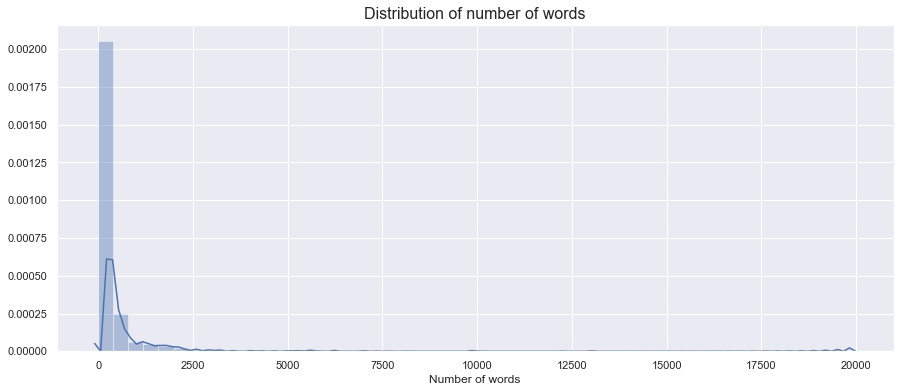

In [10]:
fig, ax = plt.subplots(figsize=(15,6))

ax.set_title("Distribution of number of words", fontsize=16)
ax.set_xlabel("Number of words")
sns.distplot(document_lengths, bins=50, ax=ax);


In [11]:
print("There are {} documents with over 500 words.".format(sum(document_lengths > 500)))

shorter_documents = document_lengths[document_lengths <= 500]

There are 738 documents with over 500 words.


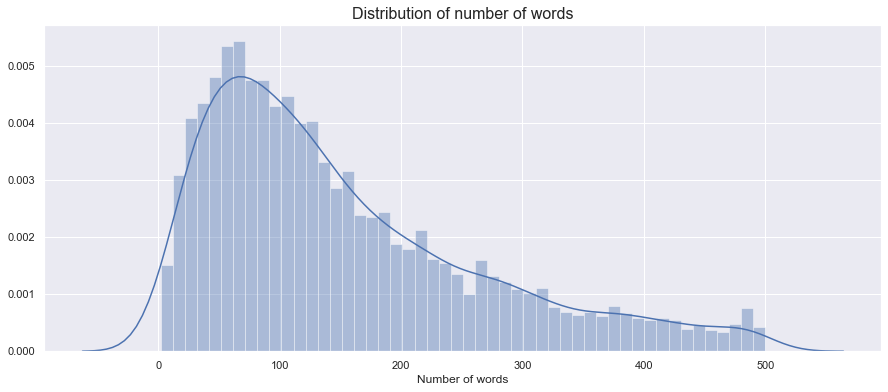

In [12]:
fig, ax = plt.subplots(figsize=(15,6))

ax.set_title("Distribution of number of words", fontsize=16)
ax.set_xlabel("Number of words")
sns.distplot(shorter_documents, bins=50, ax=ax);

This makes it a bit clearer. The shorter documents will probably be harder to classify since we'll have less words to cling to. LDA for example tries to find topics in documents, but if the documents are so short, perhaps it will find it hard to really find a topic in a two-word document.
Apparently there's actually quite some short documents. Let's just have a quick peek at some of these documents.

In [13]:
print("There are {} documents with tops 5 words.".format(sum(document_lengths <= 5)))

There are 11 documents with tops 5 words.


In [14]:
data_train[document_lengths == 2]

,unique_hash,text,drug,sentiment
2301,6df111aa3032069076b12f81bd87a9d72dc795ad,Sandy,opdivo,2
3525,65fb06982b3518557c8244b947fb36ae33b15534,Chuck,opdivo,2


In [15]:
data_train[document_lengths == 3]

,unique_hash,text,drug,sentiment
285,b99f30b5a448c9063469f2c8b1fa0221ab570532,Apologies it's Gilenya,gilenya,2
1973,ae868203b1cebf2c75722bc38c1f7611ad706ab0,Be well......,tarceva,1
3446,f57ddcc186c8557ad4201bb252244bba749f23cf,Any advice?,opdivo,2


In [16]:
data_train[document_lengths == 4]

,unique_hash,text,drug,sentiment
1270,e0cb10f541366d9cd194af5abbe4e2ff3da468dc,Sorry should read ozurdex,ozurdex,2
2782,f9ea8531605bc0ddd0d1cdee05aba8a2bdb5322c,Keytruda Carboplatin and Alimta,keytruda,2
3720,c40d519b9b37c577ff6b385d3c639ef483525f07,There is hope!,opdivo,2
4158,9a52142fc09639e7670adbf6ab2d1610f0777463,"Birmingham, AL: Exploring Ocrevus",ocrevus,2


In [17]:
data_train[document_lengths == 5]

,unique_hash,text,drug,sentiment
2306,8a268ffc0892e1cc2f1e9af5de0369adcd9a0ddb,Are you on cladribine now?,cladribine,2
2884,a2d4b7597101841c2a4b0fd6d6d2ba3a039ca7f1,yay for Bob and durvalumab!,durvalumab,2


Looks like there are is rarely a random sentence.

# 2- Feature Creation / Cleansing

The most common steps to take in order to achieve this cleansing.

1- **Tokenize** the text; split sentences in (good) words. Thus watch out for punctuation.  
2- **Remove words** that mean little; these are usually words that occur very frequently or words that occur very infrequently. Also, punctuation can be removed, but perhaps you'd like to keep some punctuation in, like exclamation marks or question marks since maybe one writer uses them more than others.  
3- **Stemming**; this basically means joining words that mean the same. Take for example the words running and runs, the stem of both words is run. Thus with stemming you'd group these words together and give them the same meaning for the model.  
4- **Vectorize** words; since we can't input plain words into a model and expect it to learn from it, we have to vectorize the words. This basically means create unit vectors for all words.
  
For LDA you'd like to perform all four steps. However, for w2v you'd only want to tokenize and remove some punctuation. The w2v model can determine by itself what words are important and what are not, but we'll get back to that later on.

## 2.1 - Tokenize the text

ASCII, pronounced ask-ee, stands for the American Standard Code for Information Interchange. ASCII was originally based on the English alphabet and consists of 128 characters including A-Z, 0-9, punctuation, spaces, and other control codes that can be found on a standard English keyboard. These 128 characters are then assigned a number from 0 to 127 to represent them in data_train transfer from one computer to the other.  

Non-ASCII  
http://heima.olivant.fo/~styrheim/tools/non-ascii.html  
®  
ᛋᛏᚤᚱᚼᛂᛁᛘ

In [19]:
# # find and remove non-ascii words
# # I stored our special word in a variable for later use
# our_special_word = 'qwerty'

# def remove_ascii_words(df):
#     """ removes non-ascii characters from the 'text' column in df.
#     It returns the words containig non-ascii characers.
#     """
#     non_ascii_words = []
#     for i in range(len(df)):
#         for word in df.loc[i, 'text'].split(' '):
#             if any([ord(character) >= 128 for character in word]):
#                 non_ascii_words.append(word)
#                 df.loc[i, 'text'] = df.loc[i, 'text'].replace(word, our_special_word)
#     return non_ascii_words

# non_ascii_words = remove_ascii_words(data_train)

# print("Replaced {} words with characters with an ordinal >= 128 in the train data_train.".format(
#     len(non_ascii_words)))

In [20]:
data_train.head()

,unique_hash,text,drug,sentiment
0,2e180be4c9214c1f5ab51fd8cc32bc80c9f612e0,"Autoimmune diseases tend to come in clusters. As for Gilenya – if you feel good, don’t think about it, it won’t change anything but waste your time and energy. I’m taking Tysabri and feel amazing, no symptoms (other than dodgy color vision, but I’ve had it since always, so, don’t know) and I don’t know if it will last a month, a year, a decade, ive just decided to enjoy the ride, no point in worrying.",gilenya,2
1,9eba8f80e7e20f3a2f48685530748fbfa95943e4,"I can completely understand why you’d want to try it. But, results reported in lectures don’t always stand up to the scrutiny of peer-review during publication. There so much still to do before this is convincing. I hope that it does work out, I really do. And if you’re aware of and happy with the risks, then that’s great. I just think it’s important to present this in a balanced way, and to understand why we don’t move straight from the first show of promise in an animal study to using drugs on humans. There’s still a lot of animal data to gather, and human data to gather before anyone can tell if it’s safe or effective. I can’t tell you how many times animal studies don’t follow through to humans, but it’s one of the major attrition points in drug development. You’ve been through some of the unpredictability issues with Cladribine/Gilenya, where there was an interaction that wasn’t predicted. But once people try it, the doctors can see patterns and work out what’s going on. Clemastine/metformin is very exciting, and given what you’ve said about your current condition and your personal risk tolerance it makes sense to try it. It definitely wouldn’t be for everyone.",gilenya,2
2,fe809672251f6bd0d986e00380f48d047c7e7b76,"Interesting that it only targets S1P-1/5 receptors rather than 1-5 like Fingolimod. Hoping to soon see what the AEs and SAEs were Yes. I'm not sure what this means, exactly: Quote Nine patients reported serious adverse events (2 mg: 3/29 [10.3%], 1.25 mg: 1/43 [2.3%], 0.5 mg: 4/29 [13.8%], and 0.25 mg: 1/50 [2.0%]; no serious adverse event was reported for more than 1 patient and no new safety signals occurred compared with the BOLD Study. If there were 9 patients reporting SAEs, how can it be stated that ""no serious adverse event was reported for more than 1 patient...""? Maybe I haven't read this right, or maybe there's a misprint. I'm very pleased that something is being developed for SPMS, and it's encouraging that siponimod doesn't linger for very long in the body.",fingolimod,2
3,bd22104dfa9ec80db4099523e03fae7a52735eb6,"Very interesting, grand merci. Now I wonder where lemtrada and ocrevus sales would go, if they prove anti-cd20 are induction",ocrevus,2
4,b227688381f9b25e5b65109dd00f7f895e838249,"Hi everybody, My latest MRI results for Brain and Cervical Cord are in and my next Neurologist appointment is in the next couple of weeks. There’re no new lesions in Brain/Cord and I’ve had no relapses while I was on Gilenya. This was a good sign. But there was one line in the cervical cord review that concerned me. It goes : “Lesions at C2-3 and T2 now show hypointensity on the post gadolinium T1 images only. This could represent artifact or early axonal loss.” That was bothersome to read. What are the kind of symptoms from C2-C3 lesion should I be aware of ? Would it result in change of my DMT ? Thanks.",gilenya,1


In [21]:
import string
def remove_punct(text):
    text  = "".join([char for char in text if char not in string.punctuation])
    text = re.sub('[0-9]+', '', text)
    return text

In [22]:
string.punctuation

'!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~'

In [23]:
def get_good_tokens(sentence):
    replaced_punctation = list(map(lambda token: re.sub('[^0-9A-Za-z!?]+', '', token), sentence))
    removed_punctation = list(filter(lambda token: token, replaced_punctation))
    return removed_punctation

In [24]:
# import spacy   
# # Load the language model and parse your document.
# nlp = spacy.load('en')  # en for English; others available.

# # data_train['new_col'] = data_train['text'].apply(lambda x: nlp(x))

In [25]:
# Here we get transform the documents into sentences for the word2vecmodel
# we made a function such that later on when we make the submission, we don't need to write duplicate code
def w2v_preprocessing(df):
    """ All the preprocessing steps for word2vec are done in this function.
    All mutations are done on the data_trainframe itself. So this function returns
    nothing.
    """
    df['text'] = df.text.str.lower()
    df['document_sentences'] = df.text.str.split('.')  # split texts into individual sentences
    df['tokenized_sentences_1'] = list(map(lambda sentences:
                                         list(map(remove_punct, sentences))
                                         ,df.document_sentences)) #remove punctuations
    df['tokenized_sentences_2'] = list(map(lambda sentences:
                                         list(map(nltk.word_tokenize, sentences)),
                                         df.tokenized_sentences_1))  # tokenize sentences    
    df['tokenized_sentences_3'] = list(map(lambda sentences:
                                         list(map(get_good_tokens, sentences)),
                                         df.tokenized_sentences_2))  # remove unwanted characters
    df['tokenized_sentences_4'] = list(map(lambda sentences:
                                         list(filter(lambda lst: lst, sentences)),
                                         df.tokenized_sentences_3))  # remove empty lists
    df['tokenized_sentences']   = df['tokenized_sentences_4'] #copy to create a new column

w2v_preprocessing(data_train)

In [26]:
#print index/row 4 with the columns mentioned

data_train.loc[[4] , ['text','document_sentences' , 'tokenized_sentences_1' 
                      , 'tokenized_sentences_2' , 'tokenized_sentences_3'
                      , 'tokenized_sentences_4']]

,text,document_sentences,tokenized_sentences_1,tokenized_sentences_2,tokenized_sentences_3,tokenized_sentences_4
4,"hi everybody, my latest mri results for brain and cervical cord are in and my next neurologist appointment is in the next couple of weeks. there’re no new lesions in brain/cord and i’ve had no relapses while i was on gilenya. this was a good sign. but there was one line in the cervical cord review that concerned me. it goes : “lesions at c2-3 and t2 now show hypointensity on the post gadolinium t1 images only. this could represent artifact or early axonal loss.” that was bothersome to read. what are the kind of symptoms from c2-c3 lesion should i be aware of ? would it result in change of my dmt ? thanks.","[hi everybody, my latest mri results for brain and cervical cord are in and my next neurologist appointment is in the next couple of weeks, there’re no new lesions in brain/cord and i’ve had no relapses while i was on gilenya, this was a good sign, but there was one line in the cervical cord review that concerned me, it goes : “lesions at c2-3 and t2 now show hypointensity on the post gadolinium t1 images only, this could represent artifact or early axonal loss, ” that was bothersome to read, what are the kind of symptoms from c2-c3 lesion should i be aware of ? would it result in change of my dmt ? thanks, ]","[hi everybody my latest mri results for brain and cervical cord are in and my next neurologist appointment is in the next couple of weeks, there’re no new lesions in braincord and i’ve had no relapses while i was on gilenya, this was a good sign, but there was one line in the cervical cord review that concerned me, it goes “lesions at c and t now show hypointensity on the post gadolinium t images only, this could represent artifact or early axonal loss, ” that was bothersome to read, what are the kind of symptoms from cc lesion should i be aware of would it result in change of my dmt thanks, ]","[[hi, everybody, my, latest, mri, results, for, brain, and, cervical, cord, are, in, and, my, next, neurologist, appointment, is, in, the, next, couple, of, weeks], [there, ’, re, no, new, lesions, in, braincord, and, i, ’, ve, had, no, relapses, while, i, was, on, gilenya], [this, was, a, good, sign], [but, there, was, one, line, in, the, cervical, cord, review, that, concerned, me], [it, goes, “, lesions, at, c, and, t, now, show, hypointensity, on, the, post, gadolinium, t, images, only], [this, could, represent, artifact, or, early, axonal, loss], [”, that, was, bothersome, to, read], [what, are, the, kind, of, symptoms, from, cc, lesion, should, i, be, aware, of, would, it, result, in, change, of, my, dmt, thanks], []]","[[hi, everybody, my, latest, mri, results, for, brain, and, cervical, cord, are, in, and, my, next, neurologist, appointment, is, in, the, next, couple, of, weeks], [there, re, no, new, lesions, in, braincord, and, i, ve, had, no, relapses, while, i, was, on, gilenya], [this, was, a, good, sign], [but, there, was, one, line, in, the, cervical, cord, review, that, concerned, me], [it, goes, lesions, at, c, and, t, now, show, hypointensity, on, the, post, gadolinium, t, images, only], [this, could, represent, artifact, or, early, axonal, loss], [that, was, bothersome, to, read], [what, are, the, kind, of, symptoms, from, cc, lesion, should, i, be, aware, of, would, it, result, in, change, of, my, dmt, thanks], []]","[[hi, everybody, my, latest, mri, results, for, brain, and, cervical, cord, are, in, and, my, next, neurologist, appointment, is, in, the, next, couple, of, weeks], [there, re, no, new, lesions, in, braincord, and, i, ve, had, no, relapses, while, i, was, on, gilenya], [this, was, a, good, sign], [but, there, was, one, line, in, the, cervical, cord, review, that, concerned, me], [it, goes, lesions, at, c, and, t, now, show, hypointensity, on, the, post, gadolinium, t, images, only], [this, could, represent, artifact, or, early, axonal, loss], [that, was, bothersome, to, read], [wh

In [27]:
pp.pprint(data_train.loc[[4] , ['text']]) #df[text]
pp.pprint(data_train.loc[[4] , ['document_sentences']]) #df[document_sentences]
pp.pprint(data_train.loc[[4] , ['tokenized_sentences_1']]) #df[document_sentences_1]
pp.pprint(data_train.loc[[4] , ['tokenized_sentences_2']]) #df[tokenized_sentences_2]
pp.pprint(data_train.loc[[4] , ['tokenized_sentences_3']]) #df[tokenized_sentences_3]
pp.pprint(data_train.loc[[4] , ['tokenized_sentences_4']]) #df[tokenized_sentences_4]

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                   text
4  hi everybody, my latest mri results for brain and cervical cord are in and my next neurologist appointment is in the next couple of weeks. there’re no new lesions in brain/cord and i’ve had no relapses while i was on gilenya. this was a good sign. but there was one line in the cervical cord review that concerned me. it goes : “lesions at c2-3 and t2 now show hypointensity on the

In [28]:
data_train.head(1)

,unique_hash,text,drug,sentiment,document_sentences,tokenized_sentences_1,tokenized_sentences_2,tokenized_sentences_3,tokenized_sentences_4,tokenized_sentences
0,2e180be4c9214c1f5ab51fd8cc32bc80c9f612e0,"autoimmune diseases tend to come in clusters. as for gilenya – if you feel good, don’t think about it, it won’t change anything but waste your time and energy. i’m taking tysabri and feel amazing, no symptoms (other than dodgy color vision, but i’ve had it since always, so, don’t know) and i don’t know if it will last a month, a year, a decade, ive just decided to enjoy the ride, no point in worrying.",gilenya,2,"[autoimmune diseases tend to come in clusters, as for gilenya – if you feel good, don’t think about it, it won’t change anything but waste your time and energy, i’m taking tysabri and feel amazing, no symptoms (other than dodgy color vision, but i’ve had it since always, so, don’t know) and i don’t know if it will last a month, a year, a decade, ive just decided to enjoy the ride, no point in worrying, ]","[autoimmune diseases tend to come in clusters, as for gilenya – if you feel good don’t think about it it won’t change anything but waste your time and energy, i’m taking tysabri and feel amazing no symptoms other than dodgy color vision but i’ve had it since always so don’t know and i don’t know if it will last a month a year a decade ive just decided to enjoy the ride no point in worrying, ]","[[autoimmune, diseases, tend, to, come, in, clusters], [as, for, gilenya, –, if, you, feel, good, don, ’, t, think, about, it, it, won, ’, t, change, anything, but, waste, your, time, and, energy], [i, ’, m, taking, tysabri, and, feel, amazing, no, symptoms, other, than, dodgy, color, vision, but, i, ’, ve, had, it, since, always, so, don, ’, t, know, and, i, don, ’, t, know, if, it, will, last, a, month, a, year, a, decade, ive, just, decided, to, enjoy, the, ride, no, point, in, worrying], []]","[[autoimmune, diseases, tend, to, come, in, clusters], [as, for, gilenya, if, you, feel, good, don, t, think, about, it, it, won, t, change, anything, but, waste, your, time, and, energy], [i, m, taking, tysabri, and, feel, amazing, no, symptoms, other, than, dodgy, color, vision, but, i, ve, had, it, since, always, so, don, t, know, and, i, don, t, know, if, it, will, last, a, month, a, year, a, decade, ive, just, decided, to, enjoy, the, ride, no, point, in, worrying], []]","[[autoimmune, diseases, tend, to, come, in, clusters], [as, for, gilenya, if, you, feel, good, don, t, think, about, it, it, won, t, change, anything, but, waste, your, time, and, energy], [i, m, taking, tysabri, and, feel, amazing, no, symptoms, other, than, dodgy, color, vision, but, i, ve, had, it, since, always, so, don, t, know, and, i, don, t, know, if, it, will, last, a, month, a, year, a, decade, ive, just, decided, to, enjoy, the, ride, no, point, in, worrying]]","[[autoimmune, diseases, tend, to, come, in, clusters], [as, for, gilenya, if, you, feel, good, don, t, think, about, it, it, won, t, change, anything, but, waste, your, time, and, energy], [i, m, taking, tysabri, and, feel, amazing, no, symptoms, other, than, dodgy, color, vision, but, i, ve, had, it, since, always, so, don, t, know, and, i, don, t, know, if, it, will, last, a, month, a, year, a, decade, ive, just, decided, to, enjoy, the, ride, no, point, in, worrying]]"


So we're actually already finished the word2vec preprocessing! All the following steps are preprocessing steps for LDA.

In [29]:
def lda_get_good_tokens(df):
    df['text'] = df.text.str.lower()
    df['tokenized_text_1'] = list(map(remove_punct, df.text))
    df['tokenized_text_2'] = list(map(nltk.word_tokenize, df.tokenized_text_1))
    df['tokenized_text_3'] = list(map(get_good_tokens, df.tokenized_text_2))
    df['tokenized_text']   = df['tokenized_text_3']

lda_get_good_tokens(data_train)

In [30]:
data_train.loc[[4] , ['text', 'tokenized_text_1' 
                      , 'tokenized_text_2' , 'tokenized_text_3']]

,text,tokenized_text_1,tokenized_text_2,tokenized_text_3
4,"hi everybody, my latest mri results for brain and cervical cord are in and my next neurologist appointment is in the next couple of weeks. there’re no new lesions in brain/cord and i’ve had no relapses while i was on gilenya. this was a good sign. but there was one line in the cervical cord review that concerned me. it goes : “lesions at c2-3 and t2 now show hypointensity on the post gadolinium t1 images only. this could represent artifact or early axonal loss.” that was bothersome to read. what are the kind of symptoms from c2-c3 lesion should i be aware of ? would it result in change of my dmt ? thanks.",hi everybody my latest mri results for brain and cervical cord are in and my next neurologist appointment is in the next couple of weeks there’re no new lesions in braincord and i’ve had no relapses while i was on gilenya this was a good sign but there was one line in the cervical cord review that concerned me it goes “lesions at c and t now show hypointensity on the post gadolinium t images only this could represent artifact or early axonal loss” that was bothersome to read what are the kind of symptoms from cc lesion should i be aware of would it result in change of my dmt thanks,"[hi, everybody, my, latest, mri, results, for, brain, and, cervical, cord, are, in, and, my, next, neurologist, appointment, is, in, the, next, couple, of, weeks, there, ’, re, no, new, lesions, in, braincord, and, i, ’, ve, had, no, relapses, while, i, was, on, gilenya, this, was, a, good, sign, but, there, was, one, line, in, the, cervical, cord, review, that, concerned, me, it, goes, “, lesions, at, c, and, t, now, show, hypointensity, on, the, post, gadolinium, t, images, only, this, could, represent, artifact, or, early, axonal, loss, ”, that, was, bothersome, to, read, what, are, the, kind, of, ...]","[hi, everybody, my, latest, mri, results, for, brain, and, cervical, cord, are, in, and, my, next, neurologist, appointment, is, in, the, next, couple, of, weeks, there, re, no, new, lesions, in, braincord, and, i, ve, had, no, relapses, while, i, was, on, gilenya, this, was, a, good, sign, but, there, was, one, line, in, the, cervical, cord, review, that, concerned, me, it, goes, lesions, at, c, and, t, now, show, hypointensity, on, the, post, gadolinium, t, images, only, this, could, represent, artifact, or, early, axonal, loss, that, was, bothersome, to, read, what, are, the, kind, of, symptoms, from, cc, lesion, ...]"


In [31]:
pp.pprint(data_train.loc[[4] , ['text']]) 
pp.pprint(data_train.loc[[4] , ['tokenized_text_1']]) 
pp.pprint(data_train.loc[[4] , ['tokenized_text_2']]) 
pp.pprint(data_train.loc[[4] , ['tokenized_text_3']]) 

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                   text
4  hi everybody, my latest mri results for brain and cervical cord are in and my next neurologist appointment is in the next couple of weeks. there’re no new lesions in brain/cord and i’ve had no relapses while i was on gilenya. this was a good sign. but there was one line in the cervical cord review that concerned me. it goes : “lesions at c2-3 and t2 now show hypointensity on the

In [32]:
data_train.head(1)

,unique_hash,text,drug,sentiment,document_sentences,tokenized_sentences_1,tokenized_sentences_2,tokenized_sentences_3,tokenized_sentences_4,tokenized_sentences,tokenized_text_1,tokenized_text_2,tokenized_text_3,tokenized_text
0,2e180be4c9214c1f5ab51fd8cc32bc80c9f612e0,"autoimmune diseases tend to come in clusters. as for gilenya – if you feel good, don’t think about it, it won’t change anything but waste your time and energy. i’m taking tysabri and feel amazing, no symptoms (other than dodgy color vision, but i’ve had it since always, so, don’t know) and i don’t know if it will last a month, a year, a decade, ive just decided to enjoy the ride, no point in worrying.",gilenya,2,"[autoimmune diseases tend to come in clusters, as for gilenya – if you feel good, don’t think about it, it won’t change anything but waste your time and energy, i’m taking tysabri and feel amazing, no symptoms (other than dodgy color vision, but i’ve had it since always, so, don’t know) and i don’t know if it will last a month, a year, a decade, ive just decided to enjoy the ride, no point in worrying, ]","[autoimmune diseases tend to come in clusters, as for gilenya – if you feel good don’t think about it it won’t change anything but waste your time and energy, i’m taking tysabri and feel amazing no symptoms other than dodgy color vision but i’ve had it since always so don’t know and i don’t know if it will last a month a year a decade ive just decided to enjoy the ride no point in worrying, ]","[[autoimmune, diseases, tend, to, come, in, clusters], [as, for, gilenya, –, if, you, feel, good, don, ’, t, think, about, it, it, won, ’, t, change, anything, but, waste, your, time, and, energy], [i, ’, m, taking, tysabri, and, feel, amazing, no, symptoms, other, than, dodgy, color, vision, but, i, ’, ve, had, it, since, always, so, don, ’, t, know, and, i, don, ’, t, know, if, it, will, last, a, month, a, year, a, decade, ive, just, decided, to, enjoy, the, ride, no, point, in, worrying], []]","[[autoimmune, diseases, tend, to, come, in, clusters], [as, for, gilenya, if, you, feel, good, don, t, think, about, it, it, won, t, change, anything, but, waste, your, time, and, energy], [i, m, taking, tysabri, and, feel, amazing, no, symptoms, other, than, dodgy, color, vision, but, i, ve, had, it, since, always, so, don, t, know, and, i, don, t, know, if, it, will, last, a, month, a, year, a, decade, ive, just, decided, to, enjoy, the, ride, no, point, in, worrying], []]","[[autoimmune, diseases, tend, to, come, in, clusters], [as, for, gilenya, if, you, feel, good, don, t, think, about, it, it, won, t, change, anything, but, waste, your, time, and, energy], [i, m, taking, tysabri, and, feel, amazing, no, symptoms, other, than, dodgy, color, vision, but, i, ve, had, it, since, always, so, don, t, know, and, i, don, t, know, if, it, will, last, a, month, a, year, a, decade, ive, just, decided, to, enjoy, the, ride, no, point, in, worrying]]","[[autoimmune, diseases, tend, to, come, in, clusters], [as, for, gilenya, if, you, feel, good, don, t, think, about, it, it, won, t, change, anything, but, waste, your, time, and, energy], [i, m, taking, tysabri, and, feel, amazing, no, symptoms, other, than, dodgy, color, vision, but, i, ve, had, it, since, always, so, don, t, know, and, i, don, t, know, if, it, will, last, a, month, a, year, a, decade, ive, just, decided, to, enjoy, the, ride, no, point, in, worrying]]",autoimmune diseases tend to come in clusters as for gilenya – if you feel good don’t think about it it won’t change anything but waste your time and energy i’m taking tysabri and feel amazing no symptoms other than dodgy color vision but i’ve had it since always so don’t know and i don’t know if it will last a month a year a decade ive just decided to enjoy the ride no point in worrying,"[autoimmune, diseases, tend, to, come, in, clusters, as, for, gilenya, –, if, you, feel, good, don, ’, t, think, about, it, it, won, ’, t, change, anything, but, waste, your,

 
Let's view at the top word frequencies now and get an idea of the words that are used mostly. 
  

In [33]:
tokenized_only_dict = Counter(np.concatenate(data_train.tokenized_text.values))

tokenized_only_df = pd.DataFrame.from_dict(tokenized_only_dict, orient='index')
tokenized_only_df.rename(columns={0: 'count'}, inplace=True)

In [34]:
tokenized_only_df.sort_values('count', ascending=False, inplace=True)
tokenized_only_df

,count
the,69029
of,44569
and,44272
to,44195
a,32870
in,31916
i,28157
for,21975
is,19916
with,19566


In [1]:
# I made a function out of this since I will use it again later on 
def word_frequency_barplot(df, nr_top_words=50):
    """ df should have a column named count.
    """
    fig, ax = plt.subplots(1,1,figsize=(20,5))

    sns.barplot(list(range(nr_top_words)), df['count'].values[:nr_top_words], palette='hls', ax=ax)

    ax.set_xticks(list(range(nr_top_words)))
    ax.set_xticklabels(df.index[:nr_top_words], fontsize=14, rotation=90)
    return ax
    
ax = word_frequency_barplot(tokenized_only_df)
ax.set_title("Word Frequencies", fontsize=16);

NameError: name 'tokenized_only_df' is not defined

It was to be expected that simple words like 'the', 'of' and 'to' are words that are used often. Unless you think that one author would preferably use on of these words more often than other authors, it's safe to remove these words. Like we stated in point 2 above, we will remove frequent words and stopwords since they probably bring little meaning and maybe even create noise when we want to classify later on

## 2.2) Remove words that mean little
As stated above, words the have little meaning to the model are words we'd like to remove. Moreover, these words can create noise which can make it harder to classify the texts later on.

In [36]:
def remove_stopwords(df):
    """ Removes stopwords based on a known set of stopwords
    available in the nltk package. In addition, we include our
    made up word in here.
    """
    # Luckily nltk already has a set of stopwords that we can remove from the texts.
    stopwords = nltk.corpus.stopwords.words('english')
    # we'll add our own special word in here 'qwerty'
    #stopwords.append(our_special_word)

    df['stopwords_removed'] = list(map(lambda doc:
                                       [word for word in doc if word not in stopwords],
                                       df['tokenized_text']))

remove_stopwords(data_train)

In [37]:
data_train.head(1)

,unique_hash,text,drug,sentiment,document_sentences,tokenized_sentences_1,tokenized_sentences_2,tokenized_sentences_3,tokenized_sentences_4,tokenized_sentences,tokenized_text_1,tokenized_text_2,tokenized_text_3,tokenized_text,stopwords_removed
0,2e180be4c9214c1f5ab51fd8cc32bc80c9f612e0,"autoimmune diseases tend to come in clusters. as for gilenya – if you feel good, don’t think about it, it won’t change anything but waste your time and energy. i’m taking tysabri and feel amazing, no symptoms (other than dodgy color vision, but i’ve had it since always, so, don’t know) and i don’t know if it will last a month, a year, a decade, ive just decided to enjoy the ride, no point in worrying.",gilenya,2,"[autoimmune diseases tend to come in clusters, as for gilenya – if you feel good, don’t think about it, it won’t change anything but waste your time and energy, i’m taking tysabri and feel amazing, no symptoms (other than dodgy color vision, but i’ve had it since always, so, don’t know) and i don’t know if it will last a month, a year, a decade, ive just decided to enjoy the ride, no point in worrying, ]","[autoimmune diseases tend to come in clusters, as for gilenya – if you feel good don’t think about it it won’t change anything but waste your time and energy, i’m taking tysabri and feel amazing no symptoms other than dodgy color vision but i’ve had it since always so don’t know and i don’t know if it will last a month a year a decade ive just decided to enjoy the ride no point in worrying, ]","[[autoimmune, diseases, tend, to, come, in, clusters], [as, for, gilenya, –, if, you, feel, good, don, ’, t, think, about, it, it, won, ’, t, change, anything, but, waste, your, time, and, energy], [i, ’, m, taking, tysabri, and, feel, amazing, no, symptoms, other, than, dodgy, color, vision, but, i, ’, ve, had, it, since, always, so, don, ’, t, know, and, i, don, ’, t, know, if, it, will, last, a, month, a, year, a, decade, ive, just, decided, to, enjoy, the, ride, no, point, in, worrying], []]","[[autoimmune, diseases, tend, to, come, in, clusters], [as, for, gilenya, if, you, feel, good, don, t, think, about, it, it, won, t, change, anything, but, waste, your, time, and, energy], [i, m, taking, tysabri, and, feel, amazing, no, symptoms, other, than, dodgy, color, vision, but, i, ve, had, it, since, always, so, don, t, know, and, i, don, t, know, if, it, will, last, a, month, a, year, a, decade, ive, just, decided, to, enjoy, the, ride, no, point, in, worrying], []]","[[autoimmune, diseases, tend, to, come, in, clusters], [as, for, gilenya, if, you, feel, good, don, t, think, about, it, it, won, t, change, anything, but, waste, your, time, and, energy], [i, m, taking, tysabri, and, feel, amazing, no, symptoms, other, than, dodgy, color, vision, but, i, ve, had, it, since, always, so, don, t, know, and, i, don, t, know, if, it, will, last, a, month, a, year, a, decade, ive, just, decided, to, enjoy, the, ride, no, point, in, worrying]]","[[autoimmune, diseases, tend, to, come, in, clusters], [as, for, gilenya, if, you, feel, good, don, t, think, about, it, it, won, t, change, anything, but, waste, your, time, and, energy], [i, m, taking, tysabri, and, feel, amazing, no, symptoms, other, than, dodgy, color, vision, but, i, ve, had, it, since, always, so, don, t, know, and, i, don, t, know, if, it, will, last, a, month, a, year, a, decade, ive, just, decided, to, enjoy, the, ride, no, point, in, worrying]]",autoimmune diseases tend to come in clusters as for gilenya – if you feel good don’t think about it it won’t change anything but waste your time and energy i’m taking tysabri and feel amazing no symptoms other than dodgy color vision but i’ve had it since always so don’t know and i don’t know if it will last a month a year a decade ive just decided to enjoy the ride no point in worrying,"[autoimmune, diseases, tend, to, come, in, clusters, as, for, gilenya, –, if, you, feel, good, don, ’, t, think, about, it, it, won, ’, t, change, anything,

## 2.3) Stemming
For the stemming part, we'll start with lemmatization, this will stem words like leaves to leaf. Afterwards, we'll apply the porterstemmer which in turn will complete the stemming by converting words like running to run.

In [38]:
def stem_words(df):
    lemm = nltk.stem.WordNetLemmatizer()
    df['lemmatized_text'] = list(map(lambda sentence:
                                     list(map(lemm.lemmatize, sentence)),
                                     df.stopwords_removed))

    p_stemmer = nltk.stem.porter.PorterStemmer()
    df['stemmed_text'] = list(map(lambda sentence:
                                  list(map(p_stemmer.stem, sentence)),
                                  df.lemmatized_text))

stem_words(data_train)

In [39]:
data_train.head(1)

,unique_hash,text,drug,sentiment,document_sentences,tokenized_sentences_1,tokenized_sentences_2,tokenized_sentences_3,tokenized_sentences_4,tokenized_sentences,tokenized_text_1,tokenized_text_2,tokenized_text_3,tokenized_text,stopwords_removed,lemmatized_text,stemmed_text
0,2e180be4c9214c1f5ab51fd8cc32bc80c9f612e0,"autoimmune diseases tend to come in clusters. as for gilenya – if you feel good, don’t think about it, it won’t change anything but waste your time and energy. i’m taking tysabri and feel amazing, no symptoms (other than dodgy color vision, but i’ve had it since always, so, don’t know) and i don’t know if it will last a month, a year, a decade, ive just decided to enjoy the ride, no point in worrying.",gilenya,2,"[autoimmune diseases tend to come in clusters, as for gilenya – if you feel good, don’t think about it, it won’t change anything but waste your time and energy, i’m taking tysabri and feel amazing, no symptoms (other than dodgy color vision, but i’ve had it since always, so, don’t know) and i don’t know if it will last a month, a year, a decade, ive just decided to enjoy the ride, no point in worrying, ]","[autoimmune diseases tend to come in clusters, as for gilenya – if you feel good don’t think about it it won’t change anything but waste your time and energy, i’m taking tysabri and feel amazing no symptoms other than dodgy color vision but i’ve had it since always so don’t know and i don’t know if it will last a month a year a decade ive just decided to enjoy the ride no point in worrying, ]","[[autoimmune, diseases, tend, to, come, in, clusters], [as, for, gilenya, –, if, you, feel, good, don, ’, t, think, about, it, it, won, ’, t, change, anything, but, waste, your, time, and, energy], [i, ’, m, taking, tysabri, and, feel, amazing, no, symptoms, other, than, dodgy, color, vision, but, i, ’, ve, had, it, since, always, so, don, ’, t, know, and, i, don, ’, t, know, if, it, will, last, a, month, a, year, a, decade, ive, just, decided, to, enjoy, the, ride, no, point, in, worrying], []]","[[autoimmune, diseases, tend, to, come, in, clusters], [as, for, gilenya, if, you, feel, good, don, t, think, about, it, it, won, t, change, anything, but, waste, your, time, and, energy], [i, m, taking, tysabri, and, feel, amazing, no, symptoms, other, than, dodgy, color, vision, but, i, ve, had, it, since, always, so, don, t, know, and, i, don, t, know, if, it, will, last, a, month, a, year, a, decade, ive, just, decided, to, enjoy, the, ride, no, point, in, worrying], []]","[[autoimmune, diseases, tend, to, come, in, clusters], [as, for, gilenya, if, you, feel, good, don, t, think, about, it, it, won, t, change, anything, but, waste, your, time, and, energy], [i, m, taking, tysabri, and, feel, amazing, no, symptoms, other, than, dodgy, color, vision, but, i, ve, had, it, since, always, so, don, t, know, and, i, don, t, know, if, it, will, last, a, month, a, year, a, decade, ive, just, decided, to, enjoy, the, ride, no, point, in, worrying]]","[[autoimmune, diseases, tend, to, come, in, clusters], [as, for, gilenya, if, you, feel, good, don, t, think, about, it, it, won, t, change, anything, but, waste, your, time, and, energy], [i, m, taking, tysabri, and, feel, amazing, no, symptoms, other, than, dodgy, color, vision, but, i, ve, had, it, since, always, so, don, t, know, and, i, don, t, know, if, it, will, last, a, month, a, year, a, decade, ive, just, decided, to, enjoy, the, ride, no, point, in, worrying]]",autoimmune diseases tend to come in clusters as for gilenya – if you feel good don’t think about it it won’t change anything but waste your time and energy i’m taking tysabri and feel amazing no symptoms other than dodgy color vision but i’ve had it since always so don’t know and i don’t know if it will last a month a year a decade ive just decided to enjoy the ride no point in worrying,"[autoimmune, diseases, tend, to, come, in, clusters, as, for, gilenya, –, if, you, feel, good, don, ’, t, think, about, it, it,

## 2.4) Vectorize words
Here we create a dictionary for the model. Since a computer can't reallly understand what a word means, we need to transform it into some number the model will be able to work with. We use gensim.corpora.Dictionary for this.

In [40]:
#create dictionary from the stemmed text, it will assign a unqiue if to each word/token

dictionary = Dictionary(documents=data_train.stemmed_text.values)

print("Found {} words.".format(len(dictionary.values())))

2019-07-26 15:08:48,659 : INFO : adding document #0 to Dictionary(0 unique tokens: [])
2019-07-26 15:08:50,382 : INFO : built Dictionary(33230 unique tokens: ['alway', 'amaz', 'anyth', 'autoimmun', 'chang']...) from 5279 documents (total 999505 corpus positions)


Found 33230 words.


In [41]:
dictionary.filter_extremes(no_above=0.8, no_below=3)

# no_below - words atleast present in n documents 
# no_above - fraction of total corpus

dictionary.compactify()  # Reindexes the remaining words after filtering
print("Left with {} words.".format(len(dictionary.values())))

2019-07-26 15:08:50,455 : INFO : discarding 22041 tokens: [('cladribinegilenya', 1), ('clemastinemetformin', 1), ('misprint', 1), ('braincord', 1), ('httpwwwcrohnscolitisfoundationorgassetspdfsunderstandingibdmedsnovpdf', 1), ('infocrohnscolitisfoundationorg', 1), ('jess', 2), ('jesszidek', 1), ('birdsa', 1), ('concernsbut', 1)]...
2019-07-26 15:08:50,456 : INFO : keeping 11189 tokens which were in no less than 3 and no more than 4223 (=80.0%) documents
2019-07-26 15:08:50,478 : INFO : resulting dictionary: Dictionary(11189 unique tokens: ['alway', 'amaz', 'anyth', 'autoimmun', 'chang']...)


Left with 11189 words.


In [245]:
#Make a BOW for every document
#This BOW will contain unique id and frequency
#It's equivaent to document term matrix

def document_to_bow(df):
    df['bow']       = list(map(lambda doc: dictionary.doc2bow(doc), df.stemmed_text))
    #pp.pprint(df['bow'])
    
document_to_bow(data_train)
#data_train.head(1)

In [246]:
from gensim import corpora, models
tfidf = models.TfidfModel(data_train['bow'] , smartirs='ntc')


2019-07-26 20:44:18,848 : INFO : collecting document frequencies
2019-07-26 20:44:18,849 : INFO : PROGRESS: processing document #0
2019-07-26 20:44:18,941 : INFO : calculating IDF weights for 5279 documents and 11188 features (521084 matrix non-zeros)


In [257]:

corpus_tfidf = tfidf[data_train['bow']]
print(len(tfidf[data_train['bow']]))
data_train['tfidf'] = corpus_tfidf

for doc in corpus_tfidf:
    print(doc)
    break

5279
[(0, 0.13254619923929772), (1, 0.20505875980463278), (2, 0.13825923156819214), (3, 0.19046411455732526), (4, 0.10098086288689768), (5, 0.3218802868423695), (6, 0.23321535089285267), (7, 0.1062422743743721), (8, 0.22868406591041454), (9, 0.14922163411681066), (10, 0.07732767465680512), (11, 0.3633142030362167), (12, 0.19726611290509327), (13, 0.21473594237148513), (14, 0.18257715140387296), (15, 0.10457317474101309), (16, 0.07880907103667166), (17, 0.1340111181570001), (18, 0.15177226167361588), (19, 0.09018476159999227), (20, 0.06471205277278362), (21, 0.12705688957562433), (22, 0.26439952558588337), (23, 0.08366095613560695), (24, 0.10005347766649368), (25, 0.06498442072868042), (26, 0.20322650337824547), (27, 0.08337154977985159), (28, 0.061965031360898606), (29, 0.13693599693172512), (30, 0.16563349810593347), (31, 0.26300754394837633), (32, 0.1634459176350063), (33, 0.051958660632786965)]


In [258]:
data_train.head(1)

,unique_hash,text,drug,sentiment,document_sentences,tokenized_sentences_1,tokenized_sentences_2,tokenized_sentences_3,tokenized_sentences_4,tokenized_sentences,tokenized_text_1,tokenized_text_2,tokenized_text_3,tokenized_text,stopwords_removed,lemmatized_text,stemmed_text,bow,w2v_features,tfidf
0,2e180be4c9214c1f5ab51fd8cc32bc80c9f612e0,"autoimmune diseases tend to come in clusters. as for gilenya – if you feel good, don’t think about it, it won’t change anything but waste your time and energy. i’m taking tysabri and feel amazing, no symptoms (other than dodgy color vision, but i’ve had it since always, so, don’t know) and i don’t know if it will last a month, a year, a decade, ive just decided to enjoy the ride, no point in worrying.",gilenya,2,"[autoimmune diseases tend to come in clusters, as for gilenya – if you feel good, don’t think about it, it won’t change anything but waste your time and energy, i’m taking tysabri and feel amazing, no symptoms (other than dodgy color vision, but i’ve had it since always, so, don’t know) and i don’t know if it will last a month, a year, a decade, ive just decided to enjoy the ride, no point in worrying, ]","[autoimmune diseases tend to come in clusters, as for gilenya – if you feel good don’t think about it it won’t change anything but waste your time and energy, i’m taking tysabri and feel amazing no symptoms other than dodgy color vision but i’ve had it since always so don’t know and i don’t know if it will last a month a year a decade ive just decided to enjoy the ride no point in worrying, ]","[[autoimmune, diseases, tend, to, come, in, clusters], [as, for, gilenya, –, if, you, feel, good, don, ’, t, think, about, it, it, won, ’, t, change, anything, but, waste, your, time, and, energy], [i, ’, m, taking, tysabri, and, feel, amazing, no, symptoms, other, than, dodgy, color, vision, but, i, ’, ve, had, it, since, always, so, don, ’, t, know, and, i, don, ’, t, know, if, it, will, last, a, month, a, year, a, decade, ive, just, decided, to, enjoy, the, ride, no, point, in, worrying], []]","[[autoimmune, diseases, tend, to, come, in, clusters], [as, for, gilenya, if, you, feel, good, don, t, think, about, it, it, won, t, change, anything, but, waste, your, time, and, energy], [i, m, taking, tysabri, and, feel, amazing, no, symptoms, other, than, dodgy, color, vision, but, i, ve, had, it, since, always, so, don, t, know, and, i, don, t, know, if, it, will, last, a, month, a, year, a, decade, ive, just, decided, to, enjoy, the, ride, no, point, in, worrying], []]","[[autoimmune, diseases, tend, to, come, in, clusters], [as, for, gilenya, if, you, feel, good, don, t, think, about, it, it, won, t, change, anything, but, waste, your, time, and, energy], [i, m, taking, tysabri, and, feel, amazing, no, symptoms, other, than, dodgy, color, vision, but, i, ve, had, it, since, always, so, don, t, know, and, i, don, t, know, if, it, will, last, a, month, a, year, a, decade, ive, just, decided, to, enjoy, the, ride, no, point, in, worrying]]","[[autoimmune, diseases, tend, to, come, in, clusters], [as, for, gilenya, if, you, feel, good, don, t, think, about, it, it, won, t, change, anything, but, waste, your, time, and, energy], [i, m, taking, tysabri, and, feel, amazing, no, symptoms, other, than, dodgy, color, vision, but, i, ve, had, it, since, always, so, don, t, know, and, i, don, t, know, if, it, will, last, a, month, a, year, a, decade, ive, just, decided, to, enjoy, the, ride, no, point, in, worrying]]",autoimmune diseases tend to come in clusters as for gilenya – if you feel good don’t think about it it won’t change anything but waste your time and energy i’m taking tysabri and feel amazing no symptoms other than dodgy color vision but i’ve had it since always so don’t know and i don’t know if it will last a month a year a decade ive just decided to enjoy the ride no point in worrying,"[autoimmune, diseases, tend, to, come, in, clusters, as, for, gilenya, –, if, you, feel, good, don, ’, t

In [46]:
# we make a function such that later on when we make the submission, we don't need to write duplicate code
def lda_preprocessing(df):
    """ All the preprocessing steps for LDA are combined in this function.
    All mutations are done on the data_trainframe itself. So this function returns
    nothing.
    """
    lda_get_good_tokens(df)
    remove_stopwords(df)
    stem_words(df)
    document_to_bow(df)

### Visualize the cleansed words frequencies
Excellent! We cleansed our data_train and are ready to continue with LDA and Word2Vec, but before we do that, I would like to visualize the cleansed results and see what we created so far.

In [47]:
cleansed_words_df = pd.DataFrame.from_dict(dictionary.token2id, orient='index')
cleansed_words_df.rename(columns={0: 'id'}, inplace=True)

cleansed_words_df['count'] = list(map(lambda id_: dictionary.dfs.get(id_), cleansed_words_df.id))
del cleansed_words_df['id']

In [48]:
cleansed_words_df.sort_values('count', ascending=False, inplace=True)

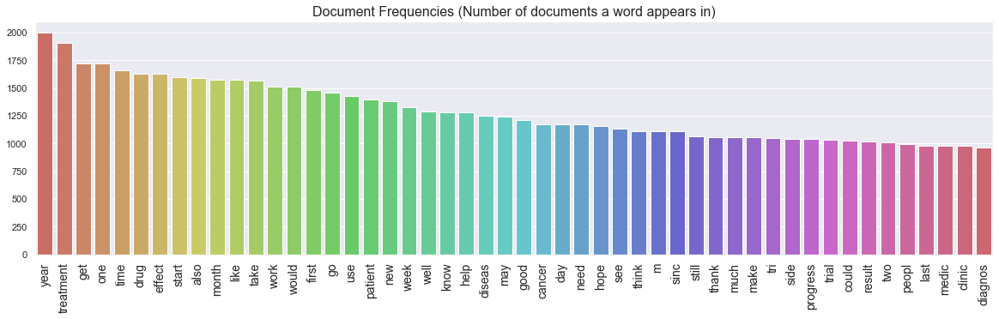

In [49]:
ax = word_frequency_barplot(cleansed_words_df)
ax.set_title("Document Frequencies (Number of documents a word appears in)", fontsize=16);

In [50]:
tokenized_only_dict = Counter(np.concatenate(data_train.stemmed_text.values))

tokenized_only_df = pd.DataFrame.from_dict(tokenized_only_dict, orient='index')
tokenized_only_df.rename(columns={0: 'count'}, inplace=True)

In [51]:
tokenized_only_df.sort_values('count', ascending=False, inplace=True)
tokenized_only_df

,count
patient,9233
cancer,8548
treatment,7757
use,5497
may,5460
drug,5383
m,5124
year,4896
diseas,4711
effect,4593


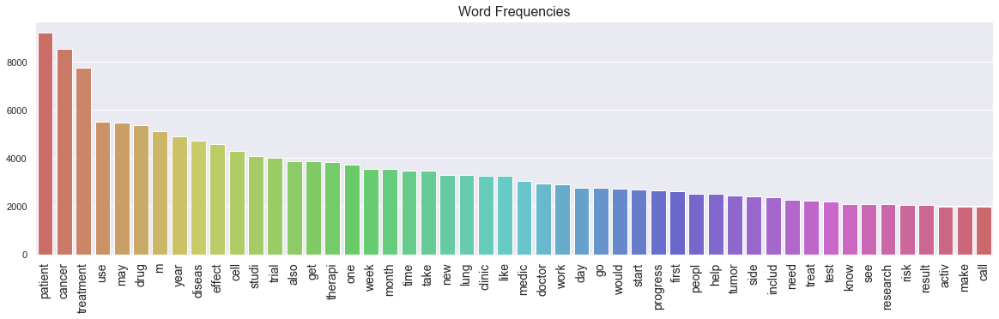

In [52]:
# I made a function out of this since I will use it again later on 
def word_frequency_barplot(df, nr_top_words=50):
    """ df should have a column named count.
    """
    fig, ax = plt.subplots(1,1,figsize=(20,5))

    sns.barplot(list(range(nr_top_words)), df['count'].values[:nr_top_words], palette='hls', ax=ax)

    ax.set_xticks(list(range(nr_top_words)))
    ax.set_xticklabels(df.index[:nr_top_words], fontsize=14, rotation=90)
    return ax
    
ax = word_frequency_barplot(tokenized_only_df)
ax.set_title("Word Frequencies", fontsize=16);

# 3) Model Training

# Word2Vec

In [53]:
data_train.head(1)

,unique_hash,text,drug,sentiment,document_sentences,tokenized_sentences_1,tokenized_sentences_2,tokenized_sentences_3,tokenized_sentences_4,tokenized_sentences,tokenized_text_1,tokenized_text_2,tokenized_text_3,tokenized_text,stopwords_removed,lemmatized_text,stemmed_text,bow
0,2e180be4c9214c1f5ab51fd8cc32bc80c9f612e0,"autoimmune diseases tend to come in clusters. as for gilenya – if you feel good, don’t think about it, it won’t change anything but waste your time and energy. i’m taking tysabri and feel amazing, no symptoms (other than dodgy color vision, but i’ve had it since always, so, don’t know) and i don’t know if it will last a month, a year, a decade, ive just decided to enjoy the ride, no point in worrying.",gilenya,2,"[autoimmune diseases tend to come in clusters, as for gilenya – if you feel good, don’t think about it, it won’t change anything but waste your time and energy, i’m taking tysabri and feel amazing, no symptoms (other than dodgy color vision, but i’ve had it since always, so, don’t know) and i don’t know if it will last a month, a year, a decade, ive just decided to enjoy the ride, no point in worrying, ]","[autoimmune diseases tend to come in clusters, as for gilenya – if you feel good don’t think about it it won’t change anything but waste your time and energy, i’m taking tysabri and feel amazing no symptoms other than dodgy color vision but i’ve had it since always so don’t know and i don’t know if it will last a month a year a decade ive just decided to enjoy the ride no point in worrying, ]","[[autoimmune, diseases, tend, to, come, in, clusters], [as, for, gilenya, –, if, you, feel, good, don, ’, t, think, about, it, it, won, ’, t, change, anything, but, waste, your, time, and, energy], [i, ’, m, taking, tysabri, and, feel, amazing, no, symptoms, other, than, dodgy, color, vision, but, i, ’, ve, had, it, since, always, so, don, ’, t, know, and, i, don, ’, t, know, if, it, will, last, a, month, a, year, a, decade, ive, just, decided, to, enjoy, the, ride, no, point, in, worrying], []]","[[autoimmune, diseases, tend, to, come, in, clusters], [as, for, gilenya, if, you, feel, good, don, t, think, about, it, it, won, t, change, anything, but, waste, your, time, and, energy], [i, m, taking, tysabri, and, feel, amazing, no, symptoms, other, than, dodgy, color, vision, but, i, ve, had, it, since, always, so, don, t, know, and, i, don, t, know, if, it, will, last, a, month, a, year, a, decade, ive, just, decided, to, enjoy, the, ride, no, point, in, worrying], []]","[[autoimmune, diseases, tend, to, come, in, clusters], [as, for, gilenya, if, you, feel, good, don, t, think, about, it, it, won, t, change, anything, but, waste, your, time, and, energy], [i, m, taking, tysabri, and, feel, amazing, no, symptoms, other, than, dodgy, color, vision, but, i, ve, had, it, since, always, so, don, t, know, and, i, don, t, know, if, it, will, last, a, month, a, year, a, decade, ive, just, decided, to, enjoy, the, ride, no, point, in, worrying]]","[[autoimmune, diseases, tend, to, come, in, clusters], [as, for, gilenya, if, you, feel, good, don, t, think, about, it, it, won, t, change, anything, but, waste, your, time, and, energy], [i, m, taking, tysabri, and, feel, amazing, no, symptoms, other, than, dodgy, color, vision, but, i, ve, had, it, since, always, so, don, t, know, and, i, don, t, know, if, it, will, last, a, month, a, year, a, decade, ive, just, decided, to, enjoy, the, ride, no, point, in, worrying]]",autoimmune diseases tend to come in clusters as for gilenya – if you feel good don’t think about it it won’t change anything but waste your time and energy i’m taking tysabri and feel amazing no symptoms other than dodgy color vision but i’ve had it since always so don’t know and i don’t know if it will last a month a year a decade ive just decided to enjoy the ride no point in worrying,"[autoimmune, diseases, tend, to, come, in, clusters, as, for, gilenya, –, if, you, feel, good, don, ’, t, think, about, it,

In [70]:
sentences = []
for sentence_group in data_train.stemmed_text:
    sentences.extend(sentence_group)

print("Number of sentences: {}.".format(len(sentences)))
print("Number of texts: {}.".format(len(data_train)))

Number of sentences: 999505.
Number of texts: 5279.


In [71]:
sentences[0]

'autoimmun'

In [56]:
import multiprocessing

In [57]:
cores = multiprocessing.cpu_count() # Count the number of cores in a computer
cores

8

In [72]:
%%time
# Set values for various parameters
num_features = 200    # Word vector dimensionality
min_word_count = 3    # Minimum word count
num_workers = 8       # Number of threads to run in parallel
context = 6           # Context window size
downsampling = 1e-3   # Downsample setting for frequent words

# Initialize and train the model
W2Vmodel = Word2Vec(sentences=sentences,
                    sg=1,
                    hs=0,
                    workers=num_workers,
                    size=num_features,
                    min_count=min_word_count,
                    window=context,
                    sample=downsampling,
                    negative=5,
                    iter=6)

2019-07-26 15:16:50,252 : INFO : collecting all words and their counts
2019-07-26 15:16:50,254 : WARNING : Each 'sentences' item should be a list of words (usually unicode strings). First item here is instead plain <class 'str'>.
2019-07-26 15:16:50,256 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2019-07-26 15:16:50,281 : INFO : PROGRESS: at sentence #10000, processed 57813 words, keeping 26 word types
2019-07-26 15:16:50,297 : INFO : PROGRESS: at sentence #20000, processed 112786 words, keeping 26 word types
2019-07-26 15:16:50,323 : INFO : PROGRESS: at sentence #30000, processed 167784 words, keeping 26 word types
2019-07-26 15:16:50,340 : INFO : PROGRESS: at sentence #40000, processed 224638 words, keeping 26 word types
2019-07-26 15:16:50,361 : INFO : PROGRESS: at sentence #50000, processed 278219 words, keeping 26 word types
2019-07-26 15:16:50,374 : INFO : PROGRESS: at sentence #60000, processed 333094 words, keeping 26 word types
2019-07-26 15:16:5

2019-07-26 15:16:51,624 : INFO : PROGRESS: at sentence #730000, processed 4090257 words, keeping 26 word types
2019-07-26 15:16:51,641 : INFO : PROGRESS: at sentence #740000, processed 4148570 words, keeping 26 word types
2019-07-26 15:16:51,664 : INFO : PROGRESS: at sentence #750000, processed 4205112 words, keeping 26 word types
2019-07-26 15:16:51,678 : INFO : PROGRESS: at sentence #760000, processed 4265411 words, keeping 26 word types
2019-07-26 15:16:51,696 : INFO : PROGRESS: at sentence #770000, processed 4323615 words, keeping 26 word types
2019-07-26 15:16:51,711 : INFO : PROGRESS: at sentence #780000, processed 4377416 words, keeping 26 word types
2019-07-26 15:16:51,728 : INFO : PROGRESS: at sentence #790000, processed 4433392 words, keeping 26 word types
2019-07-26 15:16:51,739 : INFO : PROGRESS: at sentence #800000, processed 4489564 words, keeping 26 word types
2019-07-26 15:16:51,754 : INFO : PROGRESS: at sentence #810000, processed 4545538 words, keeping 26 word types
2

2019-07-26 15:17:06,463 : INFO : worker thread finished; awaiting finish of 3 more threads
2019-07-26 15:17:06,464 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-07-26 15:17:06,465 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-07-26 15:17:06,466 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-07-26 15:17:06,467 : INFO : EPOCH - 4 : training on 5592513 raw words (949952 effective words) took 3.5s, 273404 effective words/s
2019-07-26 15:17:07,484 : INFO : EPOCH 5 - PROGRESS: at 30.71% examples, 290159 words/s, in_qsize 16, out_qsize 0
2019-07-26 15:17:08,487 : INFO : EPOCH 5 - PROGRESS: at 60.34% examples, 285451 words/s, in_qsize 15, out_qsize 0
2019-07-26 15:17:09,493 : INFO : EPOCH 5 - PROGRESS: at 88.98% examples, 280698 words/s, in_qsize 16, out_qsize 3
2019-07-26 15:17:09,761 : INFO : worker thread finished; awaiting finish of 7 more threads
2019-07-26 15:17:09,768 : INFO : worker thread finished; awaiting f

Wall time: 23 s


In [59]:
# from time import time
# t = time()

# W2Vmodel.train(sentences, total_examples=W2Vmodel.corpus_count, epochs=30, report_delay=1)

# print('Time to train the model: {} mins'.format(round((time() - t) / 60, 2)))

In [60]:
# from time import time  # To time our operations

# w2v_model = Word2Vec(min_count=20,
#                      window=2,
#                      size=300,
#                      sample=6e-5, 
#                      alpha=0.03, 
#                      min_alpha=0.0007, 
#                      negative=20,
#                      workers=cores-1)

# t = time()

# w2v_model.build_vocab(sentences, progress_per=10000)

# print('Time to build vocab: {} mins'.format(round((time() - t) / 60, 2)))

In [61]:
# t = time()

# w2v_model.train(sentences, total_examples=w2v_model.corpus_count, epochs=30, report_delay=1)

# print('Time to train the model: {} mins'.format(round((time() - t) / 60, 2)))

In [185]:
new = data_train[['tokenized_sentences']].iloc[0].copy()

In [180]:
new.tokenized_sentences

[['autoimmune', 'diseases', 'tend', 'to', 'come', 'in', 'clusters'],
 ['as',
  'for',
  'gilenya',
  'if',
  'you',
  'feel',
  'good',
  'don',
  't',
  'think',
  'about',
  'it',
  'it',
  'won',
  't',
  'change',
  'anything',
  'but',
  'waste',
  'your',
  'time',
  'and',
  'energy'],
 ['i',
  'm',
  'taking',
  'tysabri',
  'and',
  'feel',
  'amazing',
  'no',
  'symptoms',
  'other',
  'than',
  'dodgy',
  'color',
  'vision',
  'but',
  'i',
  've',
  'had',
  'it',
  'since',
  'always',
  'so',
  'don',
  't',
  'know',
  'and',
  'i',
  'don',
  't',
  'know',
  'if',
  'it',
  'will',
  'last',
  'a',
  'month',
  'a',
  'year',
  'a',
  'decade',
  'ive',
  'just',
  'decided',
  'to',
  'enjoy',
  'the',
  'ride',
  'no',
  'point',
  'in',
  'worrying']]

In [191]:
def get_w2v_features(w2v_model, sentence_group):
    """ Transform a sentence_group (containing multiple lists
    of words) into a feature vector. It averages out all the
    word vectors of the sentence_group.
    """
    print('sentence_group : ', sentence_group)
    words = np.concatenate(sentence_group)  # words in text
    print('words : ', words)
    index2word_set = set(w2v_model.wv.vocab.keys())  # words known to model
#    pp.pprint(index2word_set)
    
    featureVec = np.zeros(w2v_model.vector_size, dtype="float32")
#    pp.pprint(featureVec)
    
    # Initialize a counter for number of words in a review
    nwords = 0
    # Loop over each word in the comment and, if it is in the model's vocabulary, add its feature vector to the total
    for word in words:
#    for word in sentence_group:
#        print('Word : ', word)
        if word in index2word_set:
#            print('index2word_set : ', index2word_set , 'Word : ', word)
            featureVec = np.add(featureVec, w2v_model[word])
            nwords += 1.
            break

    # Divide the result by the number of words to get the average
    if nwords > 0:
        featureVec = np.divide(featureVec, nwords)
    return featureVec

In [192]:
data_train['w2v_features'] = list(map(lambda sen_group:
                                      get_w2v_features(W2Vmodel, sen_group),
                                      data_train.tokenized_sentences))
#                                      new.tokenized_sentences))

sentence_group :  [['autoimmune', 'diseases', 'tend', 'to', 'come', 'in', 'clusters'], ['as', 'for', 'gilenya', 'if', 'you', 'feel', 'good', 'don', 't', 'think', 'about', 'it', 'it', 'won', 't', 'change', 'anything', 'but', 'waste', 'your', 'time', 'and', 'energy'], ['i', 'm', 'taking', 'tysabri', 'and', 'feel', 'amazing', 'no', 'symptoms', 'other', 'than', 'dodgy', 'color', 'vision', 'but', 'i', 've', 'had', 'it', 'since', 'always', 'so', 'don', 't', 'know', 'and', 'i', 'don', 't', 'know', 'if', 'it', 'will', 'last', 'a', 'month', 'a', 'year', 'a', 'decade', 'ive', 'just', 'decided', 'to', 'enjoy', 'the', 'ride', 'no', 'point', 'in', 'worrying']]
words :  ['autoimmune' 'diseases' 'tend' 'to' 'come' 'in' 'clusters' 'as' 'for'
 'gilenya' 'if' 'you' 'feel' 'good' 'don' 't' 'think' 'about' 'it' 'it'
 'won' 't' 'change' 'anything' 'but' 'waste' 'your' 'time' 'and' 'energy'
 'i' 'm' 'taking' 'tysabri' 'and' 'feel' 'amazing' 'no' 'symptoms' 'other'
 'than' 'dodgy' 'color' 'vision' 'but' 'i' 

C:\Users\tshrs\Anaconda3\lib\site-packages\ipykernel_launcher.py:23: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).


 this
Word :  drug
Word :  passes
Word :  into
Word :  breast
Word :  milk
Word :  similar
Word :  drugs
Word :  pass
Word :  into
Word :  breast
Word :  milk
Word :  consult
Word :  your
Word :  doctor
Word :  before
Word :  breastfeeding
Word :  our
Word :  humira
Word :  adalimumab
Word :  side
Word :  effects
Word :  drug
Word :  center
Word :  provides
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['well', 'the', 'theory', 'your', 'gi', 'is', 'telling', 'you', 'is', 'very', 'accurate', 'and', 'has', 'been', 'standard', 'practice', 'for', 'a', 'while', 'if', 'there', 'is', 'no', 'endoscopic', 'and', 'histologic', 'remission', 'more', 'needs', 'to', 'be', 'done'], ['while', 'more', 'scopes', 'suck', 'for', 'you', 'on', 'those', 'days', 'they', 'take', 'up', 'they', 'are', 'better', 'for', 'your', 'short', 'and', 'long', 'term', 'health'], ['pa

Word :  is
Word :  the
Word :  first
Word :  post
Word :  ive
Word :  made
Word :  i
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['conclusion', 'these', 'reallife', 'results', 'suggest', 'that', 'the', 'intravitreal', 'dexamethasone', 'implant', 'is', 'effective', 'and', 'safe', 'for', 'eyes', 'with', 'dme'], ['ophthalmologica', 'source', 'ophthalmologica']]
words :  ['conclusion' 'these' 'reallife' 'results' 'suggest' 'that' 'the'
 'intravitreal' 'dexamethasone' 'implant' 'is' 'effective' 'and' 'safe'
 'for' 'eyes' 'with' 'dme' 'ophthalmologica' 'source' 'ophthalmologica']
Word :  conclusion
Word :  these
Word :  reallife
Word :  results
Word :  suggest
Word :  that
Word :  the
Word :  intravitreal
Word :  dexamethasone
Word :  implant
Word :  is
Word :  effective
Word :  and
Word :  safe
Word :  for
Word :  eyes
Word :  with
Word :  dme
Word :  ophthal

Word :  so
Word :  one
Word :  would
Word :  assume
Word :  that
Word :  if
Word :  the
Word :  body
Word :  produces
Word :  antibodies
Word :  towards
Word :  one
Word :  why
Word :  not
Word :  the
Word :  other
Word :  since
Word :  they
Word :  are
Word :  in
Word :  the
Word :  same
Word :  family
Word :  of
Word :  drugs
Word :  to
Word :  my
Word :  knowledge
sentence_group :  [['thank', 'you', 'for', 'info'], ['jerry', 'took', 'first', 'treatment', 'friday', 'on', 'the', 'opdivo'], ['i', 'believe', 'it', 'is', 'doing', 'something'], ['he', 'has', 'been', 'runnung', 'a', 'low', 'grade', 'fever'], ['he', 'also', 'has', 'lost', 'appetite', 'and', 'is', 'weak'], ['i', 'hope', 'this', 'is', 'a', 'good', 'sign']]
words :  ['thank' 'you' 'for' 'info' 'jerry' 'took' 'first' 'treatment' 'friday'
 'on' 'the' 'opdivo' 'i' 'believe' 'it' 'is' 'doing' 'something' 'he'
 'has' 'been' 'runnung' 'a' 'low' 'grade' 'fever' 'he' 'also' 'has' 'lost'
 'appetite' 'and' 'is' 'weak' 'i' 'hope' 'this' 

words :  ['hi' 'my' 'question' 'is' 'about' 'my' 'brother' 'his' 'history'
 'diagnosed' 'nsclc' 'adeno' 'with' 'alk' 'and' 'started' 'cisplatin'
 'alimta' 'and' 'then' 'alimta' 'maintenance' 'had' 'a' 'very' 'good'
 'response' 'and' 'then' 'disease' 'progress' 'started' 'xalkori' 'and'
 'after' 'a' 'year' 'it' 'stops' 'working' 'and' 'again' 'went' 'back'
 'to' 'alimta' 'for' 'few' 'months' 'but' 'after' 'progression' 'he' 'has'
 'started' 'zykadia' 'it' 'works' 'very' 'well' 'from' 'last' 'months'
 'as' 'his' 'lymph' 'nodes' 'disappear' 'and' 'tumour' 'of' 'one' 'lung'
 'turns' 'into' 'scar' 'and' 'left' 'lung' 'tumour' 'reduced' 'in' 'size'
 'but' 'as' 'soon' 'as' 'he' 'got' 'report' 'he' 'had' 'a' 'bad' 'rash'
 'last' 'couple' 'of' 'weekson' 'his' 'face' 'and' 'body' 'and' 'then'
 'he' 'stop' 'taking' 'zykadia' 'and' 'dermatologist' 'gave' 'him'
 'medicine' 'for' 'rashes' 'but' 'suddenly' 'he' 'had' 'a' 'swear'
 'headache' 'and' 'by' 'taking' 'dexa' 'it' 'gets' 'normal' 'now' 'he'
 

Word :  the
Word :  proposed
Word :  product
Word :  and
Word :  the
Word :  original
Word :  product
Word :  not
Word :  to
Word :  independently
Word :  establish
Word :  the
Word :  safety
Word :  and
Word :  effectiveness
Word :  of
Word :  the
Word :  proposed
Word :  product
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['i', 'have', 'been', 'getting', 'keytruda', 'treatments', 'for', 'months', 'now'], ['treatment', 'every', 'weeks'], ['my', 'lung', 'cancer', 'dr'], ['called', 'me', 'today', 'and', 'gave', 'me', 'the', 'best', 'news', 'ever', 'after', 'my', 'pet', 'scan', 'yesterday', 'my', 'masses', 'in', 'both', 'lungs', 'are', 'shrinking', 'thank', 'you', 'jesus']]
words :  ['i' 'have' 'been' 'getting' 'keytruda' 'treatments' 'for' 'months' 'now'
 'treatment' 'every' 'weeks' 'my' 'lung' 'cancer' 'dr' 'called' 'me'
 'today' 'and' 'gave' '

index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['im', 'not', 'sure', 'if', 'im', 'navigating', 'this', 'site', 'correctly', 'but', 'i', 'know', 'im', 'looking', 'for', 'hope'], ['i', 'was', 'diagnosed', 'with', 'adenocarcinoma', 'stage', 'in', 'november', 'lungs', 'liver', 'brain', 'an', 'bones'], ['i', 'had', 'whole', 'brain', 'an', 'localize', 'radiation'], ['late', 'december', 'i', 'started', 'on', 'tarceva'], ['its', 'been', 'a', 'physical', 'and', 'emotional', 'roller', 'coaster'], ['i', 'try', 'to', 'keep', 'my', 'mind', 'from', 'going', 'too', 'far', 'forward', 'but', 'its', 'difficult'], ['my', 'nature', 'is', 'to', 'problem', 'solve'], ['and', 'this', 'one', 'i', 'cant']]
words :  ['im' 'not' 'sure' 'if' 'im' 'navigating' 'this' 'site' 'correctly' 'but'
 'i' 'know' 'im' 'looking' 'for' 'hope' 'i' 'was' 'diagnosed' 'with'
 'adenocarcinoma' 'stage' '

words :  ['in' 'the' 'article' 'reducing' 'costs' 'while' 'enhancing' 'quality'
 'of' 'care' 'in' 'ms' 'kister' 'and' 'corboy' 'urge' 'neurologists' 'to'
 'do' 'their' 'part' 'to' 'improve' 'the' 'affordability' 'of' 'ms'
 'medications' 'the' 'unaffordability' 'of' 'ms' 'medications' 'is'
 'driven' 'by' 'the' 'outrageous' 'prices' 'that' 'are' 'in' 'no' 'way'
 'tied' 'to' 'the' 'benefits' 'these' 'medications' 'provide' 'the'
 'experiences' 'they' 'share' 'include' 'a' 'few' 'simple' 'strategies'
 'to' 'lower' 'costs' 'without' 'diminishing' 'quality' 'of' 'care' 'the'
 'one' 'with' 'the' 'most' 'impact' 'is' 'the' 'use' 'of' 'rituximab'
 'the' 'forerunner' 'to' 'ocrelizumab' 'that' 'will' 'likely' 'be' 'fda'
 'approved' 'and' 'available' 'for' 'a' 'ridiculously' 'high' 'price' 'in'
 'the' 'biggest' 'barriers' 'to' 'implementing' 'rituximab' 'use' 'are'
 'most' 'insurance' 'carriers' 'deny' 'coverage' 'because' 'it' 'is' 'not'
 'fda' 'approved' 'for' 'ms' 'neurologists' 'are' 'afraid' 

Word :  your
Word :  healthcare
Word :  system
Word :  it
Word :  is
Word :  incredibly
Word :  more
Word :  cost
Word :  efficient
Word :  and
Word :  we
Word :  still
Word :  get
Word :  all
Word :  the
Word :  same
Word :  high
Word :  quality
Word :  drugs
Word :  surgeries
Word :  and
Word :  treatments
Word :  that
Word :  you
Word :  guys
Word :  do
Word :  sorry
Word :  for
Word :  the
Word :  bluntness
Word :  but
Word :  it
Word :  just
Word :  makes
Word :  me
Word :  laugh
Word :  when
Word :  i
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['wow', 'that', 'all', 'really', 'really', 'sucks'], ['i', 'am', 'so', 'sorry', 'i', 'cant', 'even', 'imagine', 'how', 'frustrating', 'this', 'is'], ['cd', 'gastroparesis', 'fibro', 'arthritis', 'gerd', 'meds', 'remicade', 'for', 'this', 'thing', 'i', 'besought', 'the', 'lord', 'thrice', 'that', 'it', 'depar

 'sclerosis' 'funding' 'novartis' 'pharma' 'ag']
Word :  lancet
Word :  jan
Word :  oral
Word :  fingolimod
Word :  in
Word :  primary
Word :  progressive
Word :  multiple
Word :  sclerosis
Word :  informs
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['heeeey', 'my', 'fellow', 'chronies', 'im', 'julian', 'from', 'australia', 'melbourne', 'and', 'years', 'old'], ['this', 'is', 'my', 'first', 'time', 'posting', 'here', 'and', 'im', 'desperately', 'in', 'need', 'of', 'some', 'advice', 'with', 'how', 'i', 'should', 'approach', 'this'], ['before', 'i', 'started', 'remicade', 'i', 'was', 'taking', 'azathiorpine', 'and', 'allopurinol'], ['my', 'gastro', 'doctor', 'told', 'me', 'i', 'have', 'a', 'severe', 'case', 'of', 'crohns', 'disease', 'based', 'off', 'my', 'inflammation', 'via', 'colonoscopy', 'and', 'my', 'crp', 'levels', 'being', 'around', 'the',

words :  ['dear' 'jim' 'and' 'onthemark' 'thank' 'you' 'so' 'much' 'for' 'your'
 'kind' 'words' 'onthemark' 'as' 'to' 'my' 'wife' 's' 'maintenance' 'of'
 'energy' 'and' 'activity' 'i' 'can' 'mostly' 'attribute' 'that' 'to'
 'her' 'amazing' 'spirit' 'focus' 'and' 'resourcefulness' 'when' 'she'
 'first' 'found' 'out' 'about' 'the' 'diagnosis' 'she' 'looked' 'at' 'me'
 'and' 'said' 'i' 'plan' 'on' 'living' 'for' 'many' 'years' 'yet' 'and'
 'i' 'have' 'learned' 'that' 'when' 'she' 'gets' 'a' 'great' 'idea' 'in'
 'her' 'head' 'you' 'never' 'stand' 'in' 'her' 'way' 'the' 'carboplatin'
 'hit' 'pretty' 'hard' 'plummeting' 'the' 'rbcs' 'to' 'almost' 'but' 'not'
 'quite' 'the' 'point' 'of' 'needing' 'a' 'transfusion' 'and' 'the' 'wbcs'
 'enough' 'to' 'need' 'neulasta' 'but' 'outside' 'of' 'the' 'worst' 'days'
 'each' 'treatment' 'she' 'still' 'pretty' 'much' 'did' 'everything' 'she'
 'normally' 'does' 'the' 'opdivo' 'was' 'probably' 'most' 'difficult' 'it'
 'had' 'no' 'effect' 'and' 'caused' 'co

 'flaring' 'worse' 'right' 'now' 'mgs' 'of' 'pred']
Word :  hey
Word :  guys
Word :  i
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['from', 'whtc', 'radio', 'roche', 's', 'immunotherapy', 'tecentriq', 'given', 'with', 'its', 'older', 'drug', 'avastin', 'and', 'chemotherapy', 'improved', 'survival', 'of', 'advanced', 'lung', 'cancer', 'patients', 'by', 'about', 'percent', 'over', 'the', 'combination', 'without', 'tecentriq', 'according', 'to', 'interim', 'results', 'of', 'a', 'late', 'stage', 'trial', 'released', 'on', 'wednesday'], ['but', 'there', 'was', 'no', 'survival', 'benefit', 'for', 'tecentriq', 'plus', 'chemotherapy', 'over', 'an', 'avastin', 'and', 'chemotherapy', 'combination', 'in', 'the', 'brief', 'summary', 'of', 'data', 'that', 'became', 'available', 'on', 'wednesday'], ['the', 'phase', 'iii', 'study', 'involved', 'people', 'with', 'nonsqu

words :  ['no' 'i' 'haven' 't' 'had' 'regular' 'mri' 's' 'or' 'doctors' 'follows'
 'up' 'until' 'now' 'i' 'haven' 't' 'seen' 'a' 'doc' 'since' 'had' 'a'
 'brain' 'mri' 'in' 'had' 'lesions' 'that' 'was' 'up' 'from' 'in' 'i'
 'went' 'to' 'the' 'ms' 'doc' 'last' 'week' 'they' 'did' 'send' 'out'
 'blood' 'for' 'the' 'jc' 'virus' 'test' 'and' 'it' 's' 'not' 'back' 'yet'
 'i' 'am' 'my' 'ms' 'seems' 'to' 'flare' 'up' 'monthly' 'at' 'that' 'time'
 'of' 'the' 'of' 'the' 'month' 'my' 'friend' 'took' 'gilenya' 'started'
 'it' 'just' 'had' 'a' 'heart' 'attack' 'and' 'the' 'docs' 'said' 'it'
 'that' 'drug' 'contributed' 'to' 'his' 'heart' 'attack' 'he' 'just'
 'started' 'tecifedera' 'and' 'says' 'it' 'seems' 'to' 'be' 'working'
 'fine' 'for' 'him' 'he' 'is' 'i' 'can' 't' 'swallow' 'big' 'pills' 'and'
 'that' 'tec' 'capsule' 'is' 'huge' 'he' 'said' 'it' 'got' 'stuck' 'in'
 'his' 'throat' 'for' 'an' 'entire' 'day' 'i' 'm' 'afraid' 'of' 'any'
 'drug' 'that' 'has' 'a' 'pml' 'risk' 'what' 'do' 'you' 'me

Word :  reading
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['howd', 'it', 'go', 'are', 'you', 'still', 'giving', 'humira', 'more', 'time', 'or', 'did', 'you', 'decide', 'to', 'go', 'the', 'surgery', 'route', 'valli', 'said'], ['will', 'they', 'be', 'able', 'to', 'do', 'the', 'j', 'pouch', 'i', 'have', 'a', 'boyfriend', 'and', 'i', 'still', 'want', 'to', 'feel', 'sexy', 'around', 'him', 'he', 'says', 'those', 'things', 'don', 't', 'matter', 'but', 'to', 'me', 'they', 'do'], ['if', 'they', 'can', 't', 'create', 'the', 'pouch', 'what', 'will', 'life', 'be', 'like', 'afterwards', 'many', 'but', 'not', 'all', 'uc', 'patients', 'are', 'candidates', 'for', 'a', 'jpouch'], ['you', 'wont', 'know', 'for', 'absolutely', 'sure', 'until', 'after', 'the', 'colectomy'], ['after', 'the', 'colectomy', 'they', 'want', 'to', 'be', 'as', 'sure', 'as', 'they', 'ca

Word :  for
Word :  the
Word :  study
Word :  of
Word :  lung
Word :  cancer
Word :  th
Word :  world
Word :  conference
Word :  on
Word :  lung
Word :  cancer
Word :  abstract
Word :  pl
Word :  and
Word :  in
Word :  the
Word :  new
Word :  england
Word :  journal
Word :  of
Word :  medicine
Word :  by
Word :  antonia
Word :  et
Word :  al
Word :  the
Word :  phase
Word :  iii
Word :  pacific
Word :  trial
Word :  has
Word :  shown
Word :  significantly
Word :  improved
Word :  overall
Word :  survivala
Word :  coprimary
Word :  endpointwith
Word :  durvalumab
Word :  imfinzi
Word :  vs
Word :  placebo
Word :  after
Word :  chemoradiotherapy
Word :  in
Word :  unresectable
Word :  stage
Word :  iii
Word :  nonsmall
Word :  cell
Word :  lung
Word :  cancer
Word :  nsclc
Word :  an
Word :  earlier
Word :  report
Word :  from
Word :  the
Word :  trial
Word :  supported
Word :  the
Word :  approval
Word :  of
Word :  durvalumab
Word :  in
Word :  this
Word :  setting
Word :  in
Word :  f

Word :  data
Word :  with
Word :  regards
Word :  to
Word :  preferential
Word :  activity
Word :  of
Word :  afatinib
Word :  in
Word :  egfr
sentence_group :  [['a', 'nod', 'from', 'the', 'ema', 'should', 'convince', 'most', 'doubters', 'of', 'cladribines', 'beneficial', 'riskbenefit', 'profile', 'this', 'would', 'send', 'a', 'message', 'for', 'generic', 'uses', 'too', 'and', 'could', 'give', 'the', 'drug', 'truly', 'global', 'potential'], ['in', 'that', 'situation', 'a', 'trial', 'against', 'another', 'induction', 'treatment', 'would', 'potentially', 'be', 'redundant', 'in', 'terms', 'of', 'safety', 'and', 'efficacy', 'however', 'testing', 'generic', 'cladribine', 'versus', 'ocrelizumab', 'in', 'people', 'with', 'relapsing', 'ms', 'with', 'a', 'health', 'economics', 'outcome', 'could', 'be', 'of', 'interest']]
words :  ['a' 'nod' 'from' 'the' 'ema' 'should' 'convince' 'most' 'doubters' 'of'
 'cladribines' 'beneficial' 'riskbenefit' 'profile' 'this' 'would' 'send'
 'a' 'message' 'for

Word :  such
Word :  as
Word :  erlotinib
Word :  and
Word :  gefitinib
Word :  in
Word :  the
Word :  majority
Word :  of
Word :  patients
Word :  this
Word :  resistance
Word :  is
Word :  mediated
Word :  by
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['on', 'jan', 'pm', 'maryd', 'wrote', 'hi', 'i', 'have', 'stage', 'iv', 'lung', 'cancer', 'with', 'mets', 'to', 'brain', 'and', 'adrenaldiagnosed', 'july'], ['i', 'am'], ['i', 'started', 'with', 'chemotherapy', 'right', 'away', 'then', 'targeted', 'radiation'], ['i', 'was', 'determined', 'to', 'be', 'stable'], ['three', 'weeks', 'later', 'it', 'spread', 'to', 'my', 'brain'], ['after', 'completing', 'whole', 'brain', 'radiation', 'for', 'seven', 'tumors', 'i', 'was', 'finally', 'placed', 'on', 'nivolumab'], ['i', 'have', 'had', 'steady', 'but', 'slow', 'size', 'reduction', 'over', 'the', 'last',

Word :  of
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['chezy', 'now', 'i', 'understand', 'the', 'bad', 'moon', 'its', 'due', 'to', 'pediod', 'probably', 'yeah', 'good', 'and', 'bad', 'day', 'im', 'glad', 'i', 'never', 'got', 'a', 'relapse', 'since', 'i', 'started', 'gilenya', 'at', 'least']]
words :  ['chezy' 'now' 'i' 'understand' 'the' 'bad' 'moon' 'its' 'due' 'to'
 'pediod' 'probably' 'yeah' 'good' 'and' 'bad' 'day' 'im' 'glad' 'i'
 'never' 'got' 'a' 'relapse' 'since' 'i' 'started' 'gilenya' 'at' 'least']
Word :  chezy
Word :  now
Word :  i
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['paulmorrison', 'i', 'was', 'oms', 'for', 'about', 'months', 'i', 'didn', 't', 'really', 'get', 'the', 'meditation', 'part', 

Word :  september
Word :  she
Word :  is
Word :  efgr
Word :  and
Word :  tm
Word :  history
Word :  she
Word :  was
Word :  first
Word :  on
Word :  tarceva
Word :  then
Word :  carboplatinalimta
Word :  plus
Word :  tarceva
Word :  then
Word :  tagrisso
Word :  progression
Word :  on
Word :  tagrisso
Word :  started
Word :  in
Word :  december
Word :  she
Word :  then
Word :  tried
Word :  one
Word :  round
Word :  of
Word :  keytruda
Word :  because
Word :  her
Word :  pdl
Word :  expression
Word :  was
Word :  due
Word :  to
Word :  extreme
Word :  coughing
Word :  and
Word :  to
Word :  rule
Word :  out
Word :  pneumonitis
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['also', 'for', 'me', 'i', 'spent', 'about', 'a', 'yearyear', 'and', 'half', 'wallowing', 'and', 'just', 'seemed', 'to', 'get', 'worse', 'and', 'worse'], ['when', 'i', 'finally

Word :  jamie
Word :  i
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['in', 'a', 'review', 'of', 'the', 'literature', 'we', 'found', 'that', 'to', 'date', 'pembrolizumab', 'has', 'been', 'the', 'only', 'pd', 'or', 'pdli', 'inhibitor', 'to', 'show', 'a', 'significant', 'survival', 'benefit', 'over', 'chemotherapy', 'when', 'given', 'as', 'monotherapy', 'or', 'as', 'part', 'of', 'combination', 'therapy', 'for', 'metastatic', 'squamous', 'or', 'nonsquamous', 'nsclc', 'nonsmall', 'cell', 'lung', 'cancer'], ['that', 'statement', 'is', 'from', 'researchers', 'writing', 'in', 'the', 'new', 'england', 'journal', 'of', 'medicine', 'who', 'also', 'presented', 'new', 'data', 'at', 'the', 'iaslcs', 'th', 'world', 'conference', 'on', 'lung', 'cancer', 'in', 'toronto', 'canada', 'on', 'september'], ['based', 'on', 'their', 'data', 'merck', 'sharp', 'dohme', 'the', 'mak

Word :  functional
Word :  vision
Word :  changes
Word :  following
Word :  cataract
Word :  surgery
Word :  the
Word :  provision
Word :  study
Word :  joshua
Word :  barbosa
Word :  varun
Word :  chaudhary
Word :  marko
Word :  popovic
Word :  michael
Word :  mak
Word :  kaela
Word :  gusenbauer
Word :  s
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  s
sentence_group :  [['in', 'the', 'u'], ['s'], ['inflectra', 'ixifi', 'remicade', 'renflexis', 'available', 'dosage', 'forms', 'powder', 'for', 'solution', 'therapeutic', 'class', 'immunological', 'agent', 'pharmacologic', 'class', 'tumor', 'necrosis', 'factor', 'inhibitor', 'uses', 'for', 'infliximab', 'infliximab', 'injection', 'is', 'used', 'in', 'adults', 'to', 'treat', 'crohn', 'disease', 'ulcerative', 'colitis', 'rheumatoid', 'arthritis', 'ankylosing', 'spondylitis', 'psoriatic', 'arthritis', 'and', 'chronic', 'severe', '

Word :  history
Word :  of
Word :  chicken
Word :  pox
Word :  baseline
Word :  ecg
Word :  and
Word :  ophthalmologic
Word :  evaluation
Word :  observe
Word :  for
Word :  bradycardia
Word :  for
Word :  at
Word :  least
Word :  hours
Word :  after
Word :  first
Word :  dose
Word :  with
Word :  hourly
Word :  pulse
Word :  and
Word :  bp
Word :  obtain
Word :  ecg
Word :  prior
Word :  to
Word :  dosing
Word :  nad
Word :  at
Word :  end
Word :  of
Word :  observation
Word :  period
Word :  if
Word :  problems
Word :  occur
Word :  continue
Word :  monitoring
Word :  overnight
Word :  and
Word :  repeat
Word :  firstdose
Word :  monitoring
Word :  higher
Word :  risk
Word :  patients
Word :  should
Word :  be
Word :  monitored
Word :  overnight
Word :  ophthalmologic
Word :  evaluation
Word :  after
Word :  to
Word :  months
Word :  of
Word :  treatment
Word :  and
Word :  in
Word :  the
Word :  event
Word :  of
Word :  new
Word :  visual
Word :  symptoms
Word :  obtain
Word :  pft


Word :  on
Word :  your
Word :  pregnancy
Word :  i
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['i', 'am', 'a', 'year', 'old', 'male', 'just', 'recently', 'diagnosed', 'with', 'ms'], ['my', 'last', 'year', 'has', 'been', 'rough'], ['i', 'suffer', 'from', 'chronic', 'pain', 'due', 'to', 'a', 'bad', 'vasectomy', 'in', 'october'], ['that', 'left', 'me', 'trying', 'various', 'medications', 'including', 'high', 'doses', 'of', 'gabapentin'], ['sometime', 'during', 'spring', 'i', 'started', 'noticing', 'a', 'numb', 'sensation', 'in', 'my', 'left', 'handfingers'], ['since', 'i', 'was', 'in', 'a', 'car', 'crash', 'in', 'summer', 'the', 'doctors', 'and', 'myself', 'ascribed', 'it', 'to', 'a', 'possible', 'neck', 'injurie', 'prolapse'], ['in', 'august', 'i', 'had', 'the', 'vasectomy', 'reversed', 'several', 'hours', 'operation', 'under', 'full', 'narcosis'], ['a',

Word :  radiation
Word :  and
Word :  chemo
Word :  and
Word :  he
Word :  went
Word :  into
Word :  remission
Word :  for
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['the', 'producers', 'of', 'lucentis', 'and', 'eylea', 'claim', 'that', 'the', 'surplus', 'money', 'they', 'gain', 'is', 'used', 'for', 'research', 'into', 'more', 'or', 'better', 'eye', 'treatment', 'drugs'], ['the', 'producer', 'of', 'avastin', 'will', 'be', 'interested', 'in', 'cancer', 'treatment', 'rather', 'than', 'eye', 'care'], ['and', 'at', 'such', 'low', 'cost', 'would', 'there', 'be', 'anything', 'left', 'for', 'research']]
words :  ['the' 'producers' 'of' 'lucentis' 'and' 'eylea' 'claim' 'that' 'the'
 'surplus' 'money' 'they' 'gain' 'is' 'used' 'for' 'research' 'into'
 'more' 'or' 'better' 'eye' 'treatment' 'drugs' 'the' 'producer' 'of'
 'avastin' 'will' 'be' 'interest

words :  ['dear' 'plucky' 'you' 'brave' 'woman' 'i' 'admire' 'you' 'i' 'just'
 'cant' 'get' 'there' 'yet' 'even' 'though' 'im' 'still' 'abscessing'
 'blah' 'blah' 'blah' 'stelara' 'is' 'really' 'helping' 'me' 'not'
 'perfect' 'but' 'my' 'bms' 'are' 'formed' 'day' 'still' 'urgency' 'my'
 'gi' 'wants' 'me' 'to' 'be' 'on' 'it' 'for' 'at' 'least' 'months' 'to'
 'see' 'if' 'it' 'will' 'heal' 'the' 'fistulas' 'i' 'just' 'had' 'my' 'rd'
 'dose' 'days' 'ago' 'and' 'i' 'came' 'down' 'with' 'a' 'virus'
 'immediately' 'following' 'im' 'trying' 'to' 'have' 'some' 'sort' 'of'
 'life' 'and' 'am' 'doing' 'well' 'at' 'that' 'yesterday' 'i' 'took' 'a'
 'ferry' 'to' 'an' 'island' 'and' 'spent' 'the' 'day' 'at' 'the' 'beach'
 'even' 'public' 'transit' 'home' 'i' 'did' 'take' 'an' 'immodium'
 'because' 'of' 'the' 'urgency' 'and' 'not' 'have' 'near' 'by' 'access'
 'to' 'a' 'clean' 'bathroom' 'but' 'im' 'fine' 'with' 'that' 'today' 'im'
 'so' 'run' 'down' 'and' 'in' 'tears' 'i' 'knew' 'that' 'would' 'happen

words :  ['takeda' 'has' 'announced' ... 'develop' 'extraintestinal'
 'manifestations']
Word :  takeda
Word :  has
Word :  announced
Word :  that
Word :  the
Word :  phase
Word :  iii
Word :  visible
Word :  trial
Word :  of
Word :  investigational
Word :  subcutaneous
Word :  formulation
Word :  entyvio
Word :  vedolizumab
Word :  for
Word :  patients
Word :  with
Word :  ulcerative
Word :  colitis
Word :  has
Word :  met
Word :  its
Word :  primary
Word :  endpoint
Word :  the
Word :  trial
Word :  was
Word :  testing
Word :  entyvio
Word :  as
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['fluconazole', 'is', 'an', 'overthecounter', 'medication', 'here', 'in', 'the', 'uk', 'and', 'many', 'women', 'use', 'it', 'for', 'thrush'], ['it', 'is', 'therefore', 'vital', 'that', 'this', 'information', 'is', 'known', 'by', 'all', 'of', 'them', 'taking',

Word :  giving
Word :  up
Word :  remicade
Word :  i
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['but', 'are', 'these', 'drugs', 'really', 'cost', 'effective', 'they', 'provide', 'only', 'modest', 'efficacy'], ['also', 'only', 'work', 'in', 'of', 'people'], ['why', 'use', 'them', 'when', 'you', 'have', 'caldribine', 'a', 'much', 'more', 'effective', 'drug', 'and', 'a', 'induction', 'therapy'], ['i', 'think', 'its', 'time', 'to', 'clear', 'the', 'cupboard'], ['make', 'room', 'for', 'more', 'effective', 'therapies', 'on', 'the', 'horizon'], ['such', 'as', 'ocrelizumab', 'spinimod', 'ozanimond', 'posinmod', 'ofatumumab', 'etc']]
words :  ['but' 'are' 'these' 'drugs' 'really' 'cost' 'effective' 'they' 'provide'
 'only' 'modest' 'efficacy' 'also' 'only' 'work' 'in' 'of' 'people' 'why'
 'use' 'them' 'when' 'you' 'have' 'caldribine' 'a' 'much' 'more'
 'effecti

Word :  length
Word :  of
Word :  time
Word :  for
Word :  an
Word :  update
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['having', 'those', 'two', 'scans', 'will', 'get', 'you', 'to', 'a', 'complete', 'diagnosis'], ['though', 'having', 'an', 'effusion', 'automatically', 'makes', 'you', 'stage', 'iv', 'knowing', 'the', 'cancer', 'load', 'before', 'starting', 'tx', 'is', 'preferable', 'by', 'most', 'onc', 'i', 'know'], ['does', 'she', 'have', 'other', 'health', 'issues', 'adding', 'to', 'treatment', 'decisions', 'age', 'should', 'not', 'be', 'the', 'only', 'factor'], ['i', 'd', 'definitely', 'get', 'another', 'opinion'], ['the', 'good', 'news', 'is', 'that', 'alimta', 'continues', 'to', 'work', 'when', 'she', 'needs', 'it'], ['take', 'care', 'judy', 'stage', 'iiia', 'adeno', 'dx'], ['srs', 'then', 'chemo', 'carboalimta', 'x'], ['ned', 'as', 'of'

Word :  uc
Word :  both
Word :  literally
Word :  and
Word :  figuratively
Word :  suck
Word :  ouch
Word :  deuce
Word :  mucus
Word :  fed
Word :  lucifer
Word :  and
Word :  luck
Word :  post
Word :  edited
Word :  ipoop
Word :  pm
Word :  gmt
sentence_group :  [['dear', 'mo', 'i', 'hope', 'you', 'have', 'a', 'good', 'appointment', 'with', 'the', 'oncologist', 'on', 'friday', 'and', 'that', 'they', 'prove', 'to', 'be', 'a', 'real', 'asset', 'in', 'peters', 'care', 'team'], ['as', 'marmalade', 'says', 'if', 'peters', 'health', 'is', 'reasonable', 'he', 'will', 'hopefully', 'have', 'chemo', 'options'], ['i', 'dont', 'know', 'if', 'youve', 'come', 'across', 'the', 'ecog', 'performance', 'score', 'grades', 'theres', 'a', 'discussion', 'about', 'them', 'in', 'the', 'advanced', 'cancer', 'forum', 'but', 'there', 'are', 'grades', 'and', 'which', 'grade', 'you', 'are', 'influences', 'which', 'treatment', 'youre', 'given'], ['ecog', 'performance', 'status', 'grades', 'fully', 'active', 'able

words :  ['its' 'usually' 'water' 'weight' 'my' 'doctors' 'gave' 'me' 'lasix' 'to'
 'help' 'combat' 'it' 'however' 'i' 'turned' 'into' 'a' 'snack' 'werewolf'
 'i' 'never' 'had' 'such' 'cravings' 'in' 'my' 'entire' 'life' 'than' 'i'
 'have' 'while' 'on' 'prednisone' 'my' 'fiance' 'was' 'bringing' 'me'
 'steak' 'and' 'candy' 'and' 'fritos' 'thats' 'all' 'i' 'wanted' 'so'
 'yeah' 'im' 'sure' 'some' 'of' 'the' 'lbs' 'i' 'gained' 'while' 'in'
 'the' 'hospital' 'was' 'from' 'the' 'cravings' 'while' 'some' 'being'
 'from' 'the' 'water' 'weight' 'but' 'since' 'ive' 'been' 'off' 'of' 'it'
 'ive' 'lost' 'lbs' 'the' 'lasix' 'helped' 'a' 'lot' 'it' 'takes' 'a'
 'while' 'to' 'normalize' 'after' 'coming' 'off' 'of' 'prednisone' 'so'
 'dont' 'beat' 'yourself' 'up' 'i' 'had' 'moon' 'face' 'i' 'had' 'the'
 'weird' 'hump' 'back' 'lump' 'i' 'had' 'it' 'all' 'and' 'i' 'lost' 'it'
 'all' 'without' 'doing' 'much' 'its' 'been' 'about' 'weeks' 'on'
 'prednisone' 'for' 'me' 'and' 'snack' 'werewolf' 'is' 'the' 

words :  ['hospitals' 'in' 'england' 'will' 'see' 'their' 'm' 'annual' 'spend' 'on'
 'abbvie' 's' 'humira' 'slashed' 'by' 'around' 'over' 'the' 'next' 'three'
 'years' 'thanks' 'to' 'a' 'commissioning' 'deal' 'with' 'five'
 'biosimilar' 'manufacturers' 'nhs' 'england' 'chief' 'executive' 'simon'
 'stevens' 'said' 'the' 'new' 'deal' 'would' 'save' 'm' 'between' 'now'
 'and' 'the' 'largest' 'reduction' 'ever' 'negotiated' 'involving' 'a'
 'single' 'drug' 'and' 'is' 'enough' 'to' 'pay' 'for' 'more' 'community'
 'nurses' 'or' 'more' 'breast' 'cancer' 'treatments' 'for' 'patients'
 'humira' 'adalimumab' 'is' 'a' 'tnf' 'blocker' 'used' 'to' 'treat'
 'inflammatory' 'diseases' 'such' 'as' 'rheumatoid' 'arthritis'
 'psoriasis' 'and' 'inflammatory' 'bowel' 'disease' 'and' 'is' 'currently'
 'the' 'world' 's' 'topselling' 'medicine' 'adding' 'more' 'than' 'bn'
 'to' 'abbvie' 's' 'topline' 'last' 'year' 'mostly' 'in' 'the' 'us' 'but'
 'with' 'around' 'bn' 'from' 'the' 'rest' 'of' 'the' 'world' 'and

words :  ['ms' 'information' 'prescription' ... 's' 'helpline' 'at']
Word :  ms
Word :  information
Word :  prescription
Word :  assistance
Word :  programs
Word :  prescription
Word :  assistance
Word :  programs
Word :  prescription
Word :  assistance
Word :  programs
Word :  for
Word :  ms
Word :  diseasemodifying
Word :  therapies
Word :  treating
Word :  relapses
Word :  ms
Word :  symptom
Word :  management
Word :  prescription
Word :  assistance
Word :  programs
Word :  for
Word :  ms
Word :  diseasemodifying
Word :  therapies
Word :  aubagio
Word :  program
Word :  name
Word :  ms
Word :  one
Word :  to
Word :  one
Word :  phone
Word :  website
Word :  www
Word :  aubagio
Word :  com
Word :  ms
Word :  one
Word :  to
Word :  one
Word :  will
Word :  assist
Word :  patients
Word :  in
Word :  the
Word :  following
Word :  ways
Word :  individuals
Word :  with
Word :  no
Word :  insurance
Word :  or
Word :  with
Word :  only
Word :  medicare
Word :  part
Word :  a
index2word_set 

Word :  and
Word :  for
Word :  what
Word :  lenth
Word :  of
Word :  time
Word :  thanks
Word :  for
Word :  the
Word :  reply
Word :  s
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  s
sentence_group :  [['i', 'am', 'sorry', 'but', 'i', 'need', 'a', 'little', 'more', 'room'], ['i', 'have', 'not', 'read', 'the', 'posting', 'rules', 'due', 'to', 'a', 'lack', 'of', 'time', 'right', 'now'], ['so', 'i', 'will', 'apologize', 'if', 'its', 'against', 'site', 'rules', 'to', 'post', 'in', 'two', 'consecutive', 'boxes'], ['i', 'am', 'very', 'fearful', 'for', 'one', 'of', 'the', 'first', 'times', 'in', 'my', 'life'], ['i', 'lost', 'my', 'dad', 'the', 'day', 'before', 'my', 'mother', 'called', 'to', 'tell', 'me', 'she', 'had', 'lung', 'cancer'], ['i', 'myself', 'at', 'the', 'start', 'of', 'the', 'post', 'told', 'you', 'that', 'i', 'had', 'stage', 'head', 'and', 'neck', 'cancer', 'tonsil']

Word :  but
Word :  fell
Word :  short
Word :  on
Word :  k
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  k
sentence_group :  [['hi', 'everyone', 'month', 'later', 'from', 'druginduced', 'pneumonitis', 'and', 'having', 'stopped', 'tagrisso', 'for', 'weeks', 'now', 'restarted', 'afatinib', 'week', 'ago', 'the', 'lung', 'is', 'still', 'worsening', 'in', 'terms', 'of', 'disease', 'process'], ['can', 'this', 'still', 'be', 'due', 'to', 'pneumonitis', 'that', 'is', 'out', 'of', 'control', 'infections', 'have', 'been', 'ruled', 'out', 'due', 'to', 'unsuccessful', 'bronchoscopy', 'and', 'cultures', 'been', 'on', 'a', 'week', 'course', 'of', 'broad', 'spectrum', 'antibiotics', 'septra', 'for', 'unusual', 'infections', 'continue', 'to', 'be', 'on', 'high', 'dose', 'steroids', 'methylprednisone', 'with', 'gradual', 'decline', 'in', 'lung', 'functions'], ['the', 'hospital', 'team', 'seem

Word :  provides
Word :  an
Word :  overview
Word :  of
Word :  the
Word :  immunopathology
Word :  diagnosis
Word :  and
Word :  management
Word :  of
Word :  multiple
Word :  sclerosis
Word :  massimo
Word :  filippi
Word :  amit
Word :  baror
Word :  fredrik
Word :  piehl
Word :  paolo
Word :  preziosa
Word :  alessandra
Word :  solari
Word :  sandra
Word :  vukusic
Word :  maria
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['hi', 'waybags', 'i', 'had', 'to', 'stop', 'tysabri', 'after'], ['years', 'i', 'had', 'been', 'jc', 'positive', 'the', 'whole', 'time', 'but', 'my', 'levels', 'went', 'up', 'and', 'my', 'neuro', 'wasnt', 'happy'], ['after', 'a', 'washout', 'period', 'i', 'started', 'gilenya', 'i', 'did', 'have', 'a', 'relapse', 'at', 'the', 'start', 'i', 'then', 'had', 'good', 'years', 'followed', 'by', 'massive', 'relapses', 'and', 'am',

Word :  is
Word :  to
Word :  demonstrate
Word :  biosimilarity
Word :  between
Word :  the
Word :  proposed
Word :  product
Word :  and
Word :  the
Word :  original
Word :  product
Word :  not
Word :  to
Word :  independently
Word :  establish
Word :  the
Word :  safety
Word :  and
Word :  effectiveness
Word :  of
Word :  the
Word :  proposed
Word :  product
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['i', 'think', 'it', 'depends', 'on', 'a', 'lot', 'of', 'factors', 'but', 'i', 'have', 'stage', 'metastatic', 'melanoma', 'on', 'my', 'lower', 'right', 'lung', 'and', 'ive', 'been', 'on', 'opdivo', 'for', 'a', 'year', 'so', 'far'], ['its', 'been', 'amazing', 'for', 'me'], ['the', 'tumors', 'have', 'shrunk', 'more', 'than', 'to', 'percent'], ['but', 'there', 'are', 'side', 'effects', 'that', 'have', 'to', 'be', 'taken', 'under', 'consideration', '

Word :  scope
Word :  on
Word :  showed
Word :  no
Word :  inflammation
Word :  but
Word :  scarring
Word :  dexa
Word :  scan
Word :  on
Word :  showed
Word :  decreased
Word :  bone
Word :  density
Word :  again
sentence_group :  [['interesting', 'article'], ['i', 'just', 'can', 'not', 'make', 'the', 'link', 'between', 'neurodegeneration', 'occurring', 'first', 'that', 'the', 'immune', 'attack', 'and', 'the', 'positive', 'effect', 'of', 'treatments', 'such', 'as', 'natalizumab', 'hstc', 'cladribine', 'or', 'alemtuzumab', 'or', 'even', 'anticd', 'and', 'anticd', 'on', 'rrms', 'preventing', 'the', 'formation', 'of', 'new', 'lesions'], ['however', 'when', 'you', 'look', 'at', 'the', 'progressive', 'forms', 'of', 'ms', 'neurodegeneration', 'starting', 'first', 'it', 'seems', 'to', 'make', 'more', 'sense']]
words :  ['interesting' 'article' 'i' 'just' 'can' 'not' 'make' 'the' 'link'
 'between' 'neurodegeneration' 'occurring' 'first' 'that' 'the' 'immune'
 'attack' 'and' 'the' 'positive' '

Word :  is
Word :  to
Word :  take
Word :  dhea
Word :  while
Word :  on
Word :  prednisone
Word :  i
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['for', 'this', 'investigation', 'researchers', 'randomly', 'assigned', 'subjects', 'to', 'years', 'of', 'age', 'with', 'relapsing', 'multiple', 'sclerosis', 'in', 'a', 'ratio', 'to', 'receive', 'oral', 'fingolimod', 'at', 'a', 'dose', 'of'], ['mg', 'per', 'day'], ['mg', 'per', 'day', 'for', 'patients', 'with', 'a', 'body', 'weight', 'of', 'kg', 'or', 'intramuscular', 'interferon', 'betaa', 'at', 'a', 'dose', 'of', 'g', 'per', 'week', 'for', 'up', 'to', 'years'], ['the', 'annualized', 'relapse', 'rate', 'was', 'the', 'primary', 'end', 'point'], ['results', 'according', 'to', 'the', 'findings', 'obtained', 'out', 'of', 'patients', 'were', 'assigned', 'to', 'fingolimod', 'and', 'to', 'interferon', 'betaa'], ['yea

Word :  currently
Word :  flaring
Word :  or
Word :  in
Word :  remission
Word :  when
Word :  was
Word :  the
Word :  last
Word :  time
Word :  you
Word :  flared
Word :  how
Word :  long
Word :  does
Word :  it
Word :  usually
Word :  take
Word :  you
Word :  to
Word :  recover
Word :  from
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['before', 'genomic', 'analyses', 'for', 'egfr', 'even', 'existed', 'and', 'before', 'we', 'understood', 'why', 'or', 'how', 'drugs', 'like', 'iressa', 'and', 'tarceva', 'worked', 'our', 'laboratory', 'had', 'developed', 'the', 'evapcd', 'tar', 'get', 'platform', 'to', 'identify', 'clinical', 'responders', 'for', 'targeted', 'agents', 'at', 'the', 'functional', 'level'], ['weve', 'used', 'iressa', 'for', 'years', 'indeed', 'several', 'years', 'before', 'the', 'egfr', 'gene', 'mutations', 'were', 'discovered', 'in

Word :  emmad
Word :  i
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['weve', 'arrived', 'at', 'the', 'heavy', 'hitters', 'going', 'back', 'to', 'the', 'first', 'installment', 'of', 'ibd', 'academy', 'back', 'to', 'basics', 'remember', 'that', 'inflammatory', 'bowel', 'disease', 'is', 'fundamentally', 'an', 'autoimmune', 'disorder', 'in', 'which', 'the', 'immune', 'system', 'mistakingly', 'attacks', 'the', 'bodys', 'own', 'tissue'], ['to', 'inhibit', 'and', 'counteract', 'this', 'reaction', 'immunomodulators', 'and', 'biologics', 'are', 'used', 'to', 'dampen', 'the', 'autoimmune', 'response'], ['a', 'serious', 'concern', 'in', 'using', 'these', 'medications', 'is', 'that', 't', 'lymphocytes', 'the', 'white', 'blood', 'cells', 'at', 'the', 'center', 'of', 'autoiummunity', 'are', 'widespread', 'in', 'the', 'body'], ['targeting', 'them', 'induces', 'to', 'sy

Word :  an
Word :  induction
Word :  agent
Word :  like
Word :  alemtuzumab
Word :  this
Word :  is
Word :  great
Word :  news
Word :  for
Word :  safety
Word :  because
Word :  it
Word :  means
Word :  the
Word :  every
Word :  six
Word :  month
Word :  dosing
Word :  may
Word :  not
Word :  be
Word :  necessary
sentence_group :  [['reply', 'posted', 'for', 'jrwilson'], ['thanks', 'i', 'finally', 'made', 'it', 'back', 'on', 'here', 'to', 'read', 'more', 'closely', 'and', 'that', 'helps'], ['my', 'doc', 'is', 'basically', 'letting', 'me', 'pick', 'which', 'med', 'i', 'want', 'to', 'try', 'first', 'and', 'i', 'am', 'going', 'back', 'and', 'forth', 'because', 'of', 'potential', 'side', 'effects', 'and', 'worrying', 'about', 'whether', 'the', 'newer', 'meds', 'are', 'as', 'safe', 'etc'], ['humira', 'cimzia', 'and', 'remicade', 'are', 'the', 'options', 'she', 'mentioned', 'while', 'also', 'taking', 'azathioprine', 'for', 'six', 'months'], ['im', 'someone', 'who', 'hates', 'taking', 'medica

Word :  from
Word :  the
Word :  slog
Word :  fest
Word :  i
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['having', 'been', 'through', 'the', 'halo', 'version', 'of', 'srs', 'stereotactic', 'radiosurgery', 'and', 'the', 'fancy', 'new', 'frameless', 'edge', 'technology', 'i', 'definitely', 'prefer', 'the', 'latter'], ['this', 'time', 'they', 'didnt', 'need', 'to', 'numb', 'my', 'head', 'which', 'didnt', 'regain', 'full', 'sensation', 'for', 'about', 'months', 'or', 'puncture', 'four', 'spots', 'around', 'my', 'head', 'to', 'anchor', 'the', 'frame', 'leaving', 'bruising', 'and', 'swelling', 'plus', 'paralyzing', 'one', 'eyebrow', 'for', 'about', 'a', 'month'], ['instead', 'i', 'was', 'fitted', 'with', 'this', 'snug', 'little', 'mask', 'which', 'they', 'clamped', 'into', 'the', 'machine'], ['there', 'were', 'also', 'cameras', 'around', 'the', 'room', 'which

sentence_group :  [['dec', 'specialist', 'hopes', 'ocrelizumab', 'will', 'be', 'available', 'by', 'spring']]
words :  ['dec' 'specialist' 'hopes' 'ocrelizumab' 'will' 'be' 'available' 'by'
 'spring']
Word :  dec
Word :  specialist
Word :  hopes
Word :  ocrelizumab
Word :  will
Word :  be
Word :  available
Word :  by
Word :  spring
sentence_group :  [['shire', 'announced', 'that', 'the', 'fda', 'has', 'accepted', 'the', 'submission', 'of', 'a', 'new', 'drug', 'application', 'nda', 'for', 'shp', 'prucalopride'], ['prucalopride', 'is', 'being', 'evaluated', 'as', 'a', 'potential', 'oncedaily', 'treatment', 'option', 'for', 'chronic', 'idiopathic', 'constipation', 'cic', 'in', 'adults'], ['the', 'fda', 'is', 'expected', 'to', 'provide', 'a', 'decision', 'on', 'or', 'around', 'december', 'the', 'designated', 'prescription', 'drug', 'user', 'fee', 'act', 'pdufa', 'action', 'date', 'with', 'fda', 'noting', 'that', 'timelines', 'are', 'flexible', 'and', 'subject', 'to', 'change', 'based', 'on'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



words :  ['i' 'am' 'stable' 'on' 'tysabri' 'but' 'still' 'jcv' 'negative' 'i' 'am'
 'really' 'really' 'interested' 'in' 'doing' 'more' 'research' 'about'
 'this' 'i' 'am' 'nervous' 'to' 'address' 'this' 'idea' 'with' 'my'
 'neurologist' 'as' 'he' 'is' 'pretty' 'old' 'school' 'and' 'considering'
 'i' 'am' 'jcv' 'negative' 'im' 'worried' 'that' 'he' 'might' 'not' 'have'
 'any' 'interest' 'in' 'this' 'as' 'for' 'the' 'original' 'thread' 'the'
 'only' 'input' 'i' 'have' 'is' 'that' 'for' 'me' 'tysabri' 'has' 'been'
 'completely' 'sideeffect' 'freequote' 'hi' 'sara' 'there' 'are' 'a'
 'number' 'of' 'people' 'here' 'at' 'ms' 'world' 'who' 'would' 'echo'
 'for' 'them' 'tysabri' 'has' 'been' 'sideeffect' 'free' 'your'
 'inclinations' 'are' 'sound' 'why' 'take' 'more' 'of' 'a' 'medicine'
 'than' 'you' 'need' 'to' 'maintain' 'neda' 'i' 'know' 'all' 'too' 'well'
 'what' 'speaking' 'to' 'a' 'neurologist' 'is' 'like' 'on' 'an' 'issue'
 'such' 'as' 'dose' 'extension' 'you' 'have' 'my' 'deepest' 'emp

Word :  below
Word :  normal
Word :  please
Word :  note
Word :  that
Word :  plasma
Word :  cells
Word :  have
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['del', 'afatinib', 'simulations', 'clearly', 'suggests', 'a', 'significant', 'component', 'in', 'enhancing', 'the', 'binding', 'of', 'afatinib', 'to', 'egfr']]
words :  ['del' 'afatinib' 'simulations' 'clearly' 'suggests' 'a' 'significant'
 'component' 'in' 'enhancing' 'the' 'binding' 'of' 'afatinib' 'to' 'egfr']
Word :  del
Word :  afatinib
Word :  simulations
Word :  clearly
Word :  suggests
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['thanks', 'for', 'replying', 'they', 'talk', 'about', 'some', 'b', 'cells', 'expressing', 'il', 'which', 'is', 'i

index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['cellautologous', 'lung', 'tumor', 'vaccine', 'and', 'nivolumab', 'in', 'treating', 'patients', 'with', 'recurrent', 'glioblastoma']]
words :  ['cellautologous' 'lung' 'tumor' 'vaccine' 'and' 'nivolumab' 'in'
 'treating' 'patients' 'with' 'recurrent' 'glioblastoma']
Word :  cellautologous
Word :  lung
Word :  tumor
Word :  vaccine
Word :  and
Word :  nivolumab
Word :  in
Word :  treating
Word :  patients
Word :  with
Word :  recurrent
Word :  glioblastoma
sentence_group :  [['last', 'may', 'my', 'wife', 'started', 'the', 'combo', 'tafinlarmekinist'], ['this', 'combo', 'was', 'showing', 'great', 'promise', 'in', 'a', 'melanoma', 'trial', 'for', 'patients', 'with', 'the', 'braf', 've', 'mutation'], ['in', 'melanoma', 'some', 'of', 'the', 'mutations', 'are', 'of', 'the', 'braf', 've', 'type'], ['soon', 'a', 'smal

Word :  and
Word :  depending
Word :  on
Word :  your
Word :  tolerance
Word :  for
Word :  risk
Word :  doing
Word :  something
Word :  is
Word :  often
Word :  better
Word :  than
Word :  doing
Word :  nothing
Word :  theres
Word :  always
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['hey', 'just', 'wanted', 'to', 'say', 'thanks', 'everyone', 'for', 'your', 'advice'], ['seanachai', 'my', 'dad', 'hsct', 'about', 'years', 'ago', 'it', 'helped', 'in', 'some', 'ways', 'but', 'not', 'in', 'the', 'ways', 'we', 'had', 'hoped', 'for', 'others', 'there', 'with', 'him', 'who', 'he', 'has', 'stayed', 'in', 'contact', 'with', 'it', 'seems', 'to', 'have', 'helped', 'really', 'well', 'mmhhpp', 'that', 'is', 'a', 'good', 'way', 'to', 'look', 'at', 'it', 'to', 'be', 'honest', 'my', 'dad', 'does', 'really', 'well', 'just', 'getting', 'on', 'with', 'his', 'lif

index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['phase', 'trials', 'to', 'focus', 'on', 'port', 'delivery', 'system', 'for', 'amd', 'faricimab', 'for', 'dme', 'genentech', 'and', 'roche', 'announced', 'the', 'initiation', 'of', 'three', 'large', 'phase', 'clinical', 'trials', 'evaluating', 'the', 'port', 'delivery', 'system', 'with', 'ranibizumab', 'to', 'treat', 'wet', 'agerelated', 'macular', 'degeneration', 'and']]
words :  ['phase' 'trials' 'to' 'focus' 'on' 'port' 'delivery' 'system' 'for' 'amd'
 'faricimab' 'for' 'dme' 'genentech' 'and' 'roche' 'announced' 'the'
 'initiation' 'of' 'three' 'large' 'phase' 'clinical' 'trials'
 'evaluating' 'the' 'port' 'delivery' 'system' 'with' 'ranibizumab' 'to'
 'treat' 'wet' 'agerelated' 'macular' 'degeneration' 'and']
Word :  phase
Word :  trials
Word :  to
Word :  focus
Word :  on
Word :  port
Word :  delivery
Wor

Word :  term
Word :  doesnt
Word :  make
Word :  sense
Word :  to
Word :  me
Word :  you
Word :  should
Word :  be
Word :  on
Word :  both
Word :  oral
Word :  and
Word :  rectal
Word :  meds
Word :  at
Word :  the
Word :  same
Word :  time
Word :  once
Word :  you
Word :  are
Word :  in
Word :  remission
Word :  you
Word :  could
Word :  cut
Word :  back
Word :  on
Word :  the
Word :  rectal
Word :  meds
Word :  but
Word :  still
Word :  use
Word :  them
Word :  occasionally
Word :  for
Word :  maintenance
Word :  stay
Word :  on
Word :  the
Word :  oral
Word :  meds
Word :  daily
Word :  even
Word :  in
Word :  remission
Word :  when
Word :  you
Word :  were
Word :  on
Word :  lialda
Word :  how
Word :  much
Word :  were
Word :  you
Word :  taking
Word :  have
Word :  you
Word :  ever
Word :  had
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['

Word :  latter
Word :  we
Word :  need
Word :  to
Word :  target
Word :  httpmultiplesclerosisresearch
Word :  blogspot
Word :  comresearchspeakectrimshighlight
Word :  html
sentence_group :  [['my', 'father', 'in', 'law', 'went', 'through', 'the', 'same', 'treatment', 'chemo', 'pemetrexed', 'for', 'almost', 'months', 'and', 'the', 'tumor', 'shrunk', 'from', 'cm', 'to', 'cm'], ['then', 'he', 'got', 'the', 'flu', 'which', 'was', 'very', 'bad', 'please', 'make', 'sure', 'your', 'husband', 'doesnt', 'get', 'sick', 'from', 'other', 'diseases', 'particularly', 'flu', 'and', 'he', 'got', 'an', 'extra', 'small', 'lesions', 'in', 'the', 'lungs'], ['the', 'doctors', 'then', 'switched', 'him', 'to', 'erlotinib', 'tarceva', 'and', 'he', 'has', 'been', 'stable', 'ever', 'since'], ['regarding', 'the', 'vaxira', 'medicine', 'he', 'went', 'to', 'cuba', 'months', 'after', 'starting', 'chemo'], ['la', 'pradera', 'is', 'a', 'good', 'hospital'], ['since', 'then', 'he', 'has', 'also', 'been', 'on', 'vaxir

Word :  interesting
Word :  i
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['hi', 'kelybe', 'welcome', 'to', 'grace'], ['it', 's', 'terrific', 'to', 'hear', 'that', 'you', 'have', 'continued', 'to', 'be', 'ned'], ['one', 'of', 'the', 'problems', 'with', 'being', 'ned', 'while', 'on', 'a', 'continuing', 'treatment', 'such', 'as', 'tarceva', 'is', 'that', 'you', 'never', 'know', 'whether', 'you', 'continue', 'to', 'be', 'ned', 'because', 'tarceva', 'is', 'controlling', 'the', 'cancer', 'or', 'because', 'there', 'simply', 'are', 'no', 'more', 'cancer', 'cells', 'in', 'your', 'bloodstream'], ['unfortunately', 'with', 'present', 'technology', 'the', 'only', 'way', 'to', 'find', 'out', 'is', 'to', 'discontinue', 'treatment', 'and', 'see', 'if', 'the', 'cancer', 'reappears'], ['on', 'the', 'other', 'hand', 'if', 'you', 'stop', 'a', 'treatment', 'due', 'to', 'sid

index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['is', 'a', 'nutrient', 'found', 'in', 'food', 'and', 'dietary', 'supplements'], ['it', 'is', 'an', 'antioxidant', 'and', 'also', 'plays', 'a', 'key', 'role', 'in', 'making', 'collagen', 'see', 'question'], ['high', 'dose', 'vitamin', 'c', 'may', 'be', 'taken', 'by', 'mouth', 'or', 'given', 'by', 'an', 'intravenous', 'iv', 'infusion', 'through', 'a', 'vein', 'into', 'the', 'bloodstream'], ['when', 'taken', 'by', 'iv', 'infusion', 'vitamin', 'c', 'can', 'reach', 'higher', 'levels', 'in', 'the', 'blood', 'than', 'when', 'the', 'same', 'amount', 'is', 'taken', 'by', 'mouth', 'see', 'question'], ['some', 'studies', 'of', 'iv', 'highdose', 'vitamin', 'c', 'in', 'patients', 'with', 'cancer', 'have', 'shown', 'improved', 'quality', 'of', 'life', 'as', 'well', 'as', 'fewer', 'side', 'effects', 'see', 'question'], ['in'

Word :  therapeutics
Word :  details
Word :  rationale
Word :  ublituximab
Word :  is
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['thank', 'you', 'for', 'these', 'responses'], ['i', 'was', 'on', 'copaxone', 'before', 'mg', 'every', 'day', 'and', 'switched', 'of', 'to', 'gilenya', 'but', 'need', 'to', 'go', 'back', 'on', 'copaxone', 'because', 'of', 'an', 'infection', 'gilenya', 'caused', 'me', 'to', 'get'], ['hearing', 'the', 'positive', 'feedback', 'on', 'the', 'mg', 'is', 'reassuring'], ['i', 'was', 'prescribed', 'the', 'mg', 'rule', 'gently', 'and', 'am', 'awaiting', 'the', 'start']]
words :  ['thank' 'you' 'for' 'these' 'responses' 'i' 'was' 'on' 'copaxone'
 'before' 'mg' 'every' 'day' 'and' 'switched' 'of' 'to' 'gilenya' 'but'
 'need' 'to' 'go' 'back' 'on' 'copaxone' 'because' 'of' 'an' 'infection'
 'gilenya' 'caused' 'me' 'to' 'get' 'hea

Word :  squibb
Word :  has
Word :  lost
Word :  yet
Word :  more
Word :  ground
Word :  in
Word :  its
Word :  ongoing
Word :  cancer
Word :  immunotherapy
Word :  battle
Word :  with
Word :  rival
Word :  merck
Word :  along
Word :  with
Word :  its
Word :  earnings
Word :  the
Word :  pharma
Word :  firm
Word :  reported
Word :  thursday
Word :  that
Word :  it
Word :  has
Word :  pulled
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['here', 'is', 'an', 'interesting', 'piece', 'of', 'research', 'on', 'immune', 'checkpoint', 'inhibitors', 'and', 'resistance'], ['mutations', 'linked', 'to', 'immunotherapy', 'credit', 'national', 'cancer', 'institute', 'mutations', 'linked', 'to', 'immunotherapy', 'resistance', 'for', 'many', 'patients', 'with', 'melanoma', 'whose', 'tumors', 'shrink', 'after', 'treatment', 'with', 'a', 'class', 'of', 'immunothera

Word :  below
Word :  administered
Word :  via
Word :  eye
Word :  injection
Word :  with
Word :  lucentis
Word :  eylea
Word :  or
Word :  avastin
Word :  has
Word :  revolutionized
Word :  the
Word :  treatment
Word :  but
Word :  not
Word :  cure
Word :  of
Word :  wet
Word :  agerelated
Word :  macular
Word :  degeneration
Word :  amd
Word :  there
Word :  remain
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['l', 'tetraiodothyronine', 'tehtruhiohdohthyrohneen', 'a', 'hormone', 'that', 'is', 'made', 'by', 'the', 'thyroid', 'gland', 'and', 'contains', 'iodine'], ['l', 'tetraiodothyronine', 'increases', 'the', 'rate', 'of', 'chemical', 'reactions', 'in', 'cells', 'and', 'helps', 'control', 'growth', 'and', 'development'], ['l', 'tetraiodothyronine', 'can', 'also', 'be', 'made', 'in', 'the', 'laboratory', 'and', 'is', 'used', 'to', 'treat', 'thy

sentence_group :  [['jussi', 'you', 'are', 'trying', 'to', 'bring', 'up', 'your', 'bp', 'by', 'substituting', 'pazopanib', 'to', 'help', 'with', 'hypotension', 'or', 'trying', 'to', 'make', 'sure', 'delivery', 'of', 'the', 'opdivo', 'is', 'being', 'delivered', 'to', 'the', 'heart', 'tumor', 'by', 'treating', 'low', 'bp', 'how', 'long', 'after', 'the', 'monthly', 'dose', 'of', 'cediranib', 'do', 'you', 'revert', 'to', 'hypotension', 'you', 've', 'mentioned', 'you', 'are', 'normally', 'low', 'blood', 'pressured', 'what', 'did', 'your', 'bp', 'run', 'normally']]
words :  ['jussi' 'you' 'are' 'trying' 'to' 'bring' 'up' 'your' 'bp' 'by'
 'substituting' 'pazopanib' 'to' 'help' 'with' 'hypotension' 'or' 'trying'
 'to' 'make' 'sure' 'delivery' 'of' 'the' 'opdivo' 'is' 'being'
 'delivered' 'to' 'the' 'heart' 'tumor' 'by' 'treating' 'low' 'bp' 'how'
 'long' 'after' 'the' 'monthly' 'dose' 'of' 'cediranib' 'do' 'you'
 'revert' 'to' 'hypotension' 'you' 've' 'mentioned' 'you' 'are' 'normally'
 'low'

Word :  all
Word :  i
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['frankielideo', 'i', 'have', 'split', 'your', 'update', 'into', 'a', 'thread', 'in', 'its', 'own', 'right', 'as', 'its', 'going', 'in', 'a', 'slightly', 'different', 'direction'], ['anyway', 'all', 'the', 'disease', 'modifying', 'treatments', 'dmts', 'come', 'with', 'risks'], ['even', 'rebif', 'has', 'risks', 'but', 'these', 'risks', 'were', 'mitigated', 'by', 'regular', 'blood', 'tests', 'to', 'ensure', 'that', 'specific', 'markers', 'were', 'not', 'approaching', 'a', 'risky', 'level'], ['gilenya', 'is', 'the', 'same', 'regular', 'bloods', 'will', 'be', 'taken', 'to', 'ensure', 'the', 'pml', 'markers', 'are', 'well', 'within', 'acceptable', 'levels'], ['if', 'not', 'the', 'gilenya', 'will', 'be', 'stopped', 'and', 'another', 'treatment', 'offered'], ['i', 'm', 'sure', 'someone', 'with', 

Word :  well
Word :  in
Word :  very
Word :  many
Word :  other
Word :  cases
Word :  many
Word :  of
Word :  them
Word :  misdiagnosed
Word :  anyway
Word :  as
Word :  it
Word :  does
Word :  in
Word :  socalled
Word :  rrms
Word :  one
Word :  study
Word :  it
Word :  is
Word :  to
Word :  laugh
Word :  do
Word :  no
Word :  harm
Word :  i
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['hi', 'everyone', 'i', 'was', 'on', 'copaxone', 'for', 'years', 'and', 'had', 'very', 'few', 'issues', 'at', 'all'], ['i', 'decided', 'to', 'switch', 'to', 'gilenya', 'recently', 'since', 'my', 'body', 'was', 'just', 'tired', 'of', 'the', 'injections', 'and', 'i', 'heard', 'such', 'good', 'things', 'about', 'the', 'orals'], ['i', 'started', 'gilenya', 'month', 'ago'], ['all', 'was', 'well', 'for', 'the', 'first', 'couple', 'weeks', 'but', 'i', 'am', 'suddenly', 'suffering

 'supps' 'step' 'ilestomy' 'and' 'j' 'pouch' 'creation' 'aug' 'step' 'nov']
Word :  i
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['my', 'mum', 'yearsivstagesmall', 'meta', 'in', 'lymph', 'nodesegfrexongx', 'was', 'for', 'months', 'on', 'st', 'line', 'afatinib', 'first', 'reduction', 'last', 'three', 'months', 'with', 'slow', 'progression', 'after', 'that', 'she', 'was', 'on', 'pemetrexed', 'monotherapy', 'for', 'months', 'with', 'quite', 'significant', 'progression'], ['since', 'finishing', 'on', 'afatinib', 'liquid', 'biopsies', 'for', 'tm', 'have', 'been', 'done', 'with', 'no', 'outcome', 'not', 'even', 'the', 'original', 'mutation', 'showed'], ['tissue', 'biopsy', 'would', 'be', 'problematic'], ['also', 'one', 'month', 'ago', 'lesion', 'in', 'brain', 'was', 'detected', 'first', 'considered', 'to', 'be', 'a', 'brain', 'metastasis'], ['now', 'the', 'do

Word :  simply
Word :  having
Word :  no
Word :  further
Word :  treatment
Word :  for
Word :  the
Word :  disease
Word :  or
Word :  are
Word :  they
Word :  having
Word :  other
Word :  already
Word :  existing
Word :  treatments
Word :  or
Word :  are
Word :  they
Word :  waiting
Word :  for
Word :  ocrelizumab
Word :  based
Word :  on
Word :  the
Word :  inability
Word :  to
Word :  access
Word :  more
Word :  treatments
Word :  than
Word :  the
Word :  two
Word :  initial
Word :  treatments
Word :  are
Word :  neurologists
Word :  not
Word :  prescribing
Word :  lemtrada
sentence_group :  [['the', 'thing', 'about', 'being', 'tested', 'is', 'you', 'can', 'prepare', 'all', 'you', 'want', 'but', 'the', 'universe', 'probably', 'has', 'her', 'own', 'ideas', 'about', 'how', 'things', 'are', 'going', 'to', 'roll'], ['you', 've', 'probably', 'gone', 'through', 'times', 'like', 'this'], ['you', 'probably', 'have', 'gone', 'through', 'even', 'worse', 'times', 'too', 'times', 'where', 'you',

index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['caption', 'for', 'above', 'im', 'not', 'her', 'father', 'you', 'are', 'lionel', 'barrymores', 'character', 'rt', 'to', 'lon', 'chaneys', 'in', 'west', 'of', 'zanzibar'], ['ironically', 'chaney', 'did', 'not', 'end', 'up', 'in', 'a', 'wheelchairbut', 'by', 'barrymore', 'was', 'constantly', 'requiring', 'painkillers', 'and', 'not', 'in', 'great', 'physical', 'shape'], ['so', 'tecfidera', 'little', 'and', 'blue', 'has', 'proven', 'at', 'full', 'dose', 'to', 'be', 'quite', 'the', 'pain', 'in', 'the', 'intestine'], ['ive', 'never', 'had', 'stomach', 'side', 'effectsand', 'taking', 'two', 'doses', 'a', 'day', 'has', 'killed', 'me'], ['im', 'down', 'to', 'one', 'a', 'day', 'because', 'i', 'can', 'almost', 'tolerate', 'it', 'if', 'i', 'remember', 'to', 'eat', 'a', 'highfat', 'highcalorie', 'breakfast', 'and', 'ive', 

Word :  potential
Word :  to
Word :  stop
Word :  all
Word :  ms
Word :  deterioration
Word :  and
Word :  for
Word :  people
Word :  to
Word :  see
Word :  improvement
Word :  in
Word :  their
Word :  symptoms
Word :  i
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['i', 'went', 'to', 'my', 'retinal', 'specialist', 'this', 'morning', 'and', 'as', 'i', 'suspected', 'my', 'vision', 'has', 'got', 'worse'], ['the', 'edema', 'got', 'a', 'lot', 'worse', 'and', 'he', 'said', 'there', 'were', 'more', 'white', 'dots', 'on', 'my', 'retina', 'something', 'hed', 'never', 'mentioned', 'before'], ['i', 'saw', 'the', 'scan', 'and', 'the', 'edema', 'had', 'looked', 'like', 'a', 'small', 'circle', 'inside', 'the', 'macula', 'today', 'it', 'looked', 'a', 'lot', 'bigger', 'and', 'like', 'a', 'pimple', 'popping', 'out', 'of', 'the', 'macula'], ['i', 'was', 'alarmed'], ['inst

Word :  i
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['my', 'highlight', 'of', 'the', 'aan', 'meeting', 'was', 'not', 'ms', 'but', 'the', 'data', 'on', 'nusinersen', 'spinraza', 'for', 'the', 'treatment', 'of', 'spinal', 'muscular', 'atrophy', 'sma'], ['sma', 'is', 'a', 'severe', 'genetic', 'condition', 'that', 'leads', 'to', 'a', 'deficiency', 'in', 'the', 'spinal', 'motor', 'neuron', 'smn', 'protein', 'as', 'a', 'result', 'of', 'mutations', 'of', 'the', 'survival', 'motor', 'neuron', 'smn', 'gene'], ['the', 'severity', 'of', 'sma', 'correlates', 'with', 'the', 'amount', 'of', 'smn', 'protein', 'which', 'can', 'be', 'produced', 'from', 'either', 'the', 'smn', 'or', 'smn', 'genes'], ['in', 'a', 'controlled', 'study', 'in', 'which', 'infants', 'months', 'of', 'age', 'with', 'sma', 'were', 'given', 'nusinersen', 'via', 'a', 'lumbar', 'puncture', 'or', 'ha

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Word :  uc
Word :  there
Word :  can
Word :  be
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['hi', 'david', 'i', 'was', 'on', 'gilenya', 'for', 'years', 'had', 'a', 'break', 'to', 'have', 'a', 'baby', 'and', 'now', 'am', 'months', 'post', 'my', 'first', 'lemtrada', 'infusion'], ['gilenya', 'didnt', 'give', 'me', 'any', 'side', 'effects', 'and', 'kept', 'me', 'relapse', 'free', 'until', 'i', 'had', 'a', 'baby'], ['lemtrada', 'i', 'only', 'had', 'the', 'first', 'round', 'in', 'june', 'so', 'i', 'am', 'a', 'newbie', 'but', 'so', 'far', 'so', 'good'], ['no', 'side', 'effects', 'as', 'yet', 'but', 'you', 'have', 'to', 'be', 'monitored', 'for', 'years', 'if', 'you', 'want', 'to', 'chat', 'about', 'either', 'just', 'give', 'me', 'a', 'shout'], ['x']]
words :  ['hi' 'david' 'i' 'was' 'on' 'gilenya' 'for' 'years' 'had' 'a' 'break'
 'to' 'have' 'a' 'bab

Word :  stopped
Word :  taking
Word :  it
Word :  about
Word :  months
Word :  before
Word :  we
Word :  started
Word :  trying
Word :  throughout
Word :  her
Word :  pregnancy
Word :  she
Word :  said
Word :  that
Word :  she
Word :  had
Word :  never
Word :  felt
Word :  better
Word :  and
Word :  showed
Word :  no
Word :  symptoms
Word :  at
Word :  all
Word :  shortly
Word :  after
Word :  giving
Word :  birth
Word :  she
Word :  had
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['what', 'a', 'weekend', 'i', 'have', 'just', 'had'], ['i', 'have', 'been', 'on', 'tysabri', 'since', 'march', 'and', 'jc', 'positive', 'for', 'about', 'two', 'years', 'now'], ['one', 'of', 'the', 'consequences', 'of', 'that', 'is', 'i', 'have', 'more', 'regular', 'mris'], ['on', 'friday', 'the', 'th', 'i', 'went', 'for', 'a', 'scan', 'not', 'expecting', 'anything', '

Word :  meeting
Word :  on
Word :  sunday
Word :  june
Word :  data
Word :  from
Word :  the
Word :  keynote
Word :  study
Word :  previously
Word :  demonstrated
Word :  that
Word :  firstline
Word :  pembrolizumab
Word :  therapy
Word :  led
Word :  to
Word :  significantly
Word :  prolonged
Word :  progressionfree
Word :  survival
Word :  pfs
Word :  and
Word :  os
Word :  among
Word :  patients
Word :  with
Word :  metastatic
Word :  nsclc
Word :  study
Word :  participants
Word :  had
Word :  no
Word :  targetable
Word :  alterations
Word :  and
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['i', 'had', 'been', 'on', 'gilenya', 'years', 'when', 'i', 'too', 'had', 'my', 'first', 'ever', 'abnormal', 'pap'], ['biopsy', 'was', 'done', 'and', 'nothing', 'was', 'found', 'to', 'be', 'wrong'], ['next', 'one', 'months', 'later', 'was', 'normal'], ['i

Word :  or
Word :  little
Word :  smaller
Word :  the
Word :  biggest
Word :  one
Word :  is
Word :  now
Word :  cm
Word :  before
Word :  it
Word :  was
Word :  cm
Word :  other
Word :  tumors
Word :  shrank
Word :  less
Word :  there
Word :  is
Word :  veil
Word :  around
Word :  some
Word :  tumors
Word :  the
Word :  radiologist
Word :  thinks
Word :  it
Word :  is
Word :  necrosis
Word :  caused
Word :  by
Word :  radiation
Word :  but
Word :  it
Word :  doesnt
Word :  look
Word :  quite
Word :  right
Word :  to
Word :  be
Word :  necrosis
Word :  also
Word :  it
Word :  has
Word :  appeared
Word :  sooner
Word :  than
Word :  radiation
Word :  necrosis
Word :  usually
Word :  little
Word :  mets
Word :  are
Word :  stable
Word :  or
Word :  maybe
Word :  some
Word :  are
Word :  little
Word :  smaller
Word :  because
Word :  of
Word :  their
Word :  size
Word :  it
Word :  is
Word :  hard
Word :  to
Word :  say
Word :  radiologist
Word :  doesnt
Word :  say
Word :  if
Word :  sma

Word :  gillespie
Word :  character
Word :  in
Word :  the
Word :  ss
Word :  kildaregillespie
Word :  series
Word :  of
Word :  films
Word :  theres
Word :  been
Word :  some
Word :  work
Word :  done
Word :  out
Word :  there
Word :  on
Word :  the
Word :  impact
Word :  barrymores
Word :  wheelchair
Word :  use
Word :  in
Word :  films
Word :  he
Word :  worked
Word :  almost
Word :  exclusively
Word :  in
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['hi', 'me', 'again', 'so', 'would', 'i', 'be', 'right', 'to', 'say', 'that', 'off', 'label', 'clad', 'could', 'be', 'secured', 'for', 'someone', 'who', 'probably', 'wont', 'fit', 'the', 'the', 'usual', 'restricted', 'criteria', 'which', 'will', 'accompany', 'mavenclad', 'but', 'who', 'would', 'still', 'benefit']]
words :  ['hi' 'me' 'again' 'so' 'would' 'i' 'be' 'right' 'to' 'say' 'that' 'off'
 

Word :  control
Word :  protein
Word :  should
Word :  be
Word :  secukinumab
Word :  mgml
Word :  ixekizumab
Word :  mgml
Word :  adalimumab
Word :  mgml
Word :  ustekinumab
Word :  mgml
Word :  infliximab
Word :  which
Word :  is
Word :  mentioned
Word :  in
Word :  that
Word :  se
Word :  ction
Word :  was
Word :  not
Word :  used
Word :  in
Word :  the
Word :  study
Word :  source
Word :  dermatology
Word :  and
Word :  therapy
sentence_group :  [['i', 'am', 'thinking', 'that', 'i', 'may', 'have', 'to', 'agree', 'with', 'you'], ['i', 'stopped', 'taking', 'gilyena', 'in', 'april', 'of', 'this', 'year', 'after', 'having', 'been', 'on', 'it', 'since'], ['i', 'never', 'felt', 'good', 'while', 'taking', 'it', 'and', 'the', 'fatigue', 'has', 'gotten', 'worse', 'if', 'that', 'was', 'possible'], ['starting', 'last', 'fall', 'i', 'started', 'having', 'horrible', 'headaches', 'think', 'migraine', 'and', 'blinding', 'sensitivity', 'to', 'light'], ['i', 'had', 'to', 'have', 'a', 'tooth', 'extr

Word :  and
Word :  weighs
Word :  lbs
Word :  has
Word :  nsclc
Word :  with
Word :  metastatic
Word :  right
Word :  hilar
Word :  lymph
Word :  nodes
Word :  and
Word :  metastatic
Word :  tumor
Word :  on
Word :  left
Word :  adrenal
Word :  gland
Word :  surgery
Word :  was
Word :  not
Word :  an
Word :  option
Word :  and
Word :  the
Word :  adrenal
Word :  tumor
Word :  was
Word :  too
Word :  large
Word :  for
Word :  radiation
Word :  he
Word :  has
Word :  received
Word :  two
Word :  keytruda
Word :  infusions
Word :  and
Word :  two
Word :  chemo
Word :  infusions
Word :  with
Word :  pemetrexed
Word :  and
Word :  alimta
Word :  today
Word :  he
Word :  has
Word :  noticeable
Word :  pain
Word :  in
Word :  his
Word :  achilles
Word :  tendon
Word :  with
Word :  skin
Word :  redness
Word :  on
Word :  site
Word :  he
Word :  has
Word :  not
Word :  had
Word :  any
Word :  episodes
Word :  like
Word :  falling
Word :  or
Word :  bumping
Word :  into
Word :  anything
Word :

Word :  develop
Word :  tki
Word :  resistance
Word :  in
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['hollylb', 'that', 's', 'not', 'being', 'dumb', 'at', 'all'], ['the', 'crab', 'drugs', 'and', 'aubagio', 'are', 'regarded', 'as', 'first', 'level'], ['crab', 'being', 'copaxone', 'rebif', 'avonex', 'and', 'betaferon'], ['if', 'you', 'need', 'something', 'stronger', 'then', 'you', 'can', 'progress', 'to', 'gilenya', 'mavenclad', 'cladribine', 'tecfidera'], ['and', 'the', 'strongest', 'tysabri', 'lemtrada', 'ocrevus']]
words :  ['hollylb' 'that' 's' 'not' 'being' 'dumb' 'at' 'all' 'the' 'crab' 'drugs'
 'and' 'aubagio' 'are' 'regarded' 'as' 'first' 'level' 'crab' 'being'
 'copaxone' 'rebif' 'avonex' 'and' 'betaferon' 'if' 'you' 'need'
 'something' 'stronger' 'then' 'you' 'can' 'progress' 'to' 'gilenya'
 'mavenclad' 'cladribine' 'tecfidera' 'and' 

words :  ['very' 'bad' 'and' ... 'when' 'it' 'happened']
Word :  very
Word :  bad
Word :  and
Word :  sometimes
Word :  deadly
Word :  liver
Word :  problems
Word :  have
Word :  happened
Word :  with
Word :  leflunomide
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['well', 'after', 'weeks', 'of', 'gemzar', 'gemcitabine', 'and', 'after', 'following', 'beginning', 'chemos', 'and', 'cycles', 'of', 'keytruda'], ['progression', 'the', 'tumors', 'have', 'decreased', 'in', 'size'], ['i', 'will', 'continue', 'on', 'the', 'gemzar', 'and', 'scan', 'in', 'months'], ['we', 'are', 'hoping', 'the', 'gemzar', 'keeps', 'it', 'at', 'bay', 'for', 'months', 'before', 'progressing', 'again', 'and', 'at', 'that', 'time', 'maybe', 'switch', 'to', 'a', 'chemo', 'pill'], ['although', 'the', 'side', 'effects', 'of', 'gemzar', 'are', 'considerable', 'we', 'will', 'keep'

Word :  to
Word :  fingolimod
Word :  or
Word :  dmfofflabel
Word :  cladribine
Word :  inj
Word :  sounds
Word :  great
Word :  doesnt
Word :  it
Word :  if
Word :  you
Word :  are
Word :  rrms
Word :  and
Word :  qualify
Word :  for
Word :  something
Word :  else
Word :  your
Word :  neuro
Word :  would
Word :  have
Word :  to
Word :  justify
Word :  use
Word :  of
Word :  offlabel
Word :  assuming
Word :  willing
Word :  to
Word :  prescribe
Word :  it
Word :  crikey
Word :  look
Word :  at
Word :  the
Word :  cost
Word :  of
Word :  those
Word :  tablets
Word :  crazy
Word :  money
sentence_group :  [['hi', 'everyone', 'so', 'pretty', 'new', 'on', 'here', 'thought', 'i', 'would', 'let', 'it', 'all', 'out', 'to', 'people', 'who', 'know', 'what', 'it', 'feels', 'like'], ['i', 'was', 'diagnosed'], ['told', 'i', 'had', 'ppms', 'fought', 'about', 'years', 'to', 'tell', 'them', 'i', 'didnt', 'think', 'so'], ['changed', 'neurologist', 'until', 'i', 'went', 'to', 'leeds', 'hospital', 'whic

Word :  enrolled
Word :  will
Word :  receive
Word :  the
Word :  immunotherapy
Word :  drug
Word :  durvalumab
Word :  in
Word :  combination
Word :  with
Word :  chem
Word :  otherapy
Word :  some
Word :  patients
Word :  will
Word :  be
Word :  randomized
Word :  to
Word :  receive
Word :  another
Word :  immunotherapy
Word :  drug
Word :  called
Word :  tremelimumab
Word :  in
Word :  addition
Word :  to
Word :  durvalumab
Word :  and
Word :  chemotherapy
Word :  the
Word :  study
Word :  is
Word :  currently
Word :  open
Word :  to
Word :  enrollment
Word :  at
Word :  ucla
Word :  main
Word :  campus
Word :  and
Word :  at
Word :  trious
Word :  sites
Word :  in
Word :  ft
Word :  wayne
Word :  in
Word :  grand
Word :  junction
Word :  co
Word :  paducah
Word :  ky
Word :  orlando
Word :  fl
Word :  and
Word :  wichita
Word :  ks
Word :  results
Word :  of
Word :  the
Word :  keynote
Word :  clinical
Word :  trial
Word :  keynote
Word :  was
Word :  a
index2word_set :  {'e', 'o',

index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['hi'], ['just', 'wanted', 'to', 'say', 'that', 'my', 'vitrectomies', 'were', 'performed', 'at', 'moorfields', 'by', 'eric', 'ezra', 'and', 'was', 'highly', 'successful', 'with', 'none', 'of', 'the', 'happenings', 'reported', 'above', 'which', 'i', 'am', 'really', 'sorry', 'to', 'hear', 'about'], ['at', 'the', 'time', 'my', 'father', 'asked', 'my', 'gp', 'to', 'find', 'out', 'if', 'the', 'surgeon', 'has', 'a', 'good', 'reputation', 'so', 'at', 'least', 'i', 'went', 'into', 'it', 'feeling', 'that', 'i', 'was', 'in', 'the', 'best', 'possible', 'hands'], ['my', 'extensive', 'lasering', 'hadnt', 'worked', 'and', 'i', 'believe', 'that', 'having', 'had', 'sloppy', 'control', 'i', 'had', 'then', 'gotten', 'pregnant', 'with', 'tight', 'control', 'and', 'this', 'triggered', 'the', 'rapid', 'profliferation'], ['nobody', 

Word :  has
Word :  revolutionized
Word :  the
Word :  way
Word :  cancer
Word :  is
Word :  treated
Word :  and
Word :  manufacturers
Word :  continue
Word :  to
Word :  invest
Word :  substantial
Word :  resources
Word :  in
Word :  the
Word :  development
Word :  of
Word :  new
Word :  technologies
Word :  of
Word :  which
Word :  phosphoinositide
Word :  kinase
Word :  piks
Word :  inhibitors
Word :  either
Word :  alone
Word :  or
Word :  in
Word :  combination
Word :  with
Word :  mek
Word :  inhibitors
Word :  appear
Word :  as
Word :  the
Word :  most
Word :  promising
Word :  next
Word :  wave
Word :  of
Word :  targeted
Word :  therapeutics
Word :  aberrant
Word :  pik
Word :  signaling
Word :  has
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['this', 'is', 'what', 'maculopathy', 'looks', 'like'], ['spaces', 'and', 'fluid', 'under', 't

Word :  first
Word :  and
Word :  only
Word :  medicine
Word :  for
Word :  people
Word :  in
Word :  the
Word :  european
Word :  union
Word :  eu
Word :  with
Word :  primary
Word :  progressive
Word :  multiple
Word :  sclerosis
Word :  roche
Word :  announced
Word :  today
Word :  that
Word :  the
Word :  chmp
Word :  has
Word :  adopted
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['where', 'have', 'you', 'heard', 'that', 'ocrelizumab', 'is', 'safer', 'thats', 'not', 'my', 'impression', 'e'], ['g'], ['concerns', 'about', 'malignancies'], ['and', 'perhaps', 'the', 'side', 'effect', 'profile', 'of', 'the', 'drug', 'is', 'not', 'yet', 'fully', 'established', 'as', 'it', 'has', 'only', 'just', 'been', 'let', 'loose', 'on', 'patients']]
words :  ['where' 'have' 'you' 'heard' 'that' 'ocrelizumab' 'is' 'safer' 'thats'
 'not' 'my' 'impression' 'e' 

Word :  for
Word :  the
Word :  boomerbenefits
Word :  recommendation
Word :  ive
Word :  already
Word :  been
Word :  to
Word :  the
Word :  site
Word :  and
Word :  had
Word :  some
Word :  things
Word :  made
Word :  clearer
Word :  one
Word :  is
Word :  that
Word :  the
Word :  humira
Word :  coming
Word :  as
Word :  it
Word :  has
Word :  this
Word :  time
Word :  of
Word :  year
Word :  has
Word :  kicked
Word :  me
Word :  into
Word :  my
Word :  donut
Word :  hence
Word :  that
Word :  copay
Word :  my
Word :  pharmacist
Word :  has
Word :  found
Word :  me
Word :  another
Word :  plan
Word :  for
Word :  next
Word :  year
Word :  that
Word :  will
Word :  after
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['tofacitinib', 'and', 'biological', 'therapies', 'for', 'ulcerative', 'colitis', 'tofacitinib', 'and', 'biological', 'therapies', 

Word :  macrophages
Word :  are
Word :  infected
Word :  with
Word :  map
Word :  and
Word :  i
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['ive', 'been', 'on', 'tecfidera', 'for', 'nearly', 'two', 'years', 'now', 'and', 'im', 'not', 'yet', 'confident', 'to', 'go', 'drug', 'free'], ['tecfidera', 'ha', 'been', 'ok', 'but', 'i', 'get', 'hot', 'flushing', 'and', 'severe', 'night', 'sweats', 'as', 'in', 'soaking', 'wet'], ['i', 'had', 'my', 'annual', 'meeting', 'with', 'my', 'neurologist', 'today', 'and', 'he', 'suggested', 'looking', 'at', 'the', 'alternatives'], ['the', 'choices', 'he', 'gave', 'me', 'were', 'tysabri', 'gilenya', 'lemtrada', 'only', 'if', 'mri', 'is', 'worse', 'dacriluzumab', 'the', 'choice', 'i', 'have', 'will', 'be', 'depedant', 'on', 'a', 'new', 'mri', 'but', 'does', 'anyone', 'have', 'any', 'experiences']]
words :  ['ive' 'been' 'on' 

Word :  data
Word :  to
Word :  restart
Word :  the
Word :  application
Word :  it
Word :  is
Word :  powerful
Word :  stuff
Word :  there
Word :  is
Word :  good
Word :  reason
Word :  why
Word :  there
Word :  is
Word :  restricted
Word :  prescribing
Word :  very
Word :  few
Word :  people
Word :  in
Word :  ms
Word :  have
Word :  experience
Word :  of
Word :  it
Word :  many
Word :  more
Word :  oncologists
Word :  do
Word :  but
Word :  they
Word :  re
Word :  not
Word :  neurologists
Word :  all
Word :  of
Word :  the
Word :  latest
Word :  drugs
Word :  available
Word :  to
Word :  us
Word :  with
Word :  ms
Word :  are
Word :  powerful
Word :  and
Word :  have
Word :  serious
Word :  se
Word :  profiles
Word :  there
Word :  is
Word :  nothing
Word :  wrong
Word :  in
Word :  asking
Word :  in
Word :  fact
Word :  we
Word :  should
Word :  all
Word :  be
Word :  pressing
Word :  all
Word :  the
Word :  time
Word :  however
Word :  the
Word :  magic
Word :  pill
Word :  with
Wo

words :  ['each' 'day' 'i' ... 'www' 'headandneck' 'org']
Word :  each
Word :  day
Word :  i
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['i', 'hope', 'you', 'do', 'as', 'well', 'i', 'just', 'refreshed', 'my', 'memory', 'of', 'cladribine'], ['i', 'knew', 'that', 'the', 'effort', 'to', 'approve', 'was', 'abandoned', 'here', 'in', 'the', 'states'], ['i', 'would', 'not', 'assume', 'that', 'it', 'is', 'the', 'best', 'option', 'simply', 'because', 'you', 'are', 'spms'], ['i', 'am', 'as', 'well'], ['lemtrada', 'and', 'even', 'stem', 'are', 'useful', 'for', 'spms'], ['the', 'official', 'description', 'is', 'for', 'relapsing', 'forms', 'of', 'the', 'disease', 'which', 'includes', 'spms', 'this', 'is', 'especially', 'important', 'for', 'stem', 'as', 'it', 'is', 'a', 'much', 'ruskier', 'procedure'], ['my', 'thought', 'about', 'my', 'condition', 'and', 'lemtrada', 

Word :  ever
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['i', 'also', 'live', 'south', 'of', 'birmingham'], ['my', 'neuro', 'mr', 'mazibrada', 'is', 'based', 'at', 'the', 'qe'], ['if', 'you', 'require', 'disease', 'modifying', 'drugs', 'youll', 'probably', 'be', 'referred', 'to', 'him', 'as', 'the', 'drugs', 'can', 'only', 'be', 'prescribed', 'by', 'certain', 'neurologists', 'probably', 'the', 'governments', 'way', 'of', 'controlling', 'costs'], ['i', 'was', 'originally', 'on', 'betaferon', 'and', 'he', 'offered', 'me', 'a', 'place', 'on', 'the', 'clinical', 'trial', 'he', 'was', 'running', 'for', 'gilenya', 'because', 'i', 'had', 'relapsed', 'twice'], ['ive', 'always', 'found', 'him', 'patient', 'and', 'helpful', 'and', 'he', 'doesnt', 'rush', 'through', 'appointments']]
words :  ['i' 'also' 'live' 'south' 'of' 'birmingham' 'my' 'neuro' 'mr' 

Word :  blog
Word :  link
Word :  in
Word :  your
Word :  signature
Word :  go
Word :  to
Word :  my
Word :  profile
Word :  at
Word :  the
Word :  top
Word :  of
Word :  the
Word :  page
Word :  to
Word :  find
Word :  the
Word :  settings
Word :  ill
Word :  take
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['i', 'echo', 'all', 'the', 'above', 'but', 'i', 'have', 'my', 'th', 'birthday', 'next', 'month', 'and', 'am', 'not', 'really', 'much', 'different', 'memorywise', 'than', 'my', 'contemporaries', 'the', 'brain', 'starts', 'shrinking', 'pretty', 'at', 'about', 'i', 'think', 'and', 'we', 'know', 'that', 'having', 'ms', 'can', 'double', 'the', 'rate', 'of', 'shrinkage'], ['the', 'neuro', 'told', 'me', 'at', 'my', 'last', 'appointment', 'that', 'the', 'drug', 'i', 'm', 'on', 'fingolimod', 'slows', 'that', 'shrinkage', 'right', 'down', 'so', 'tha

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['hi' 'fbs' 'i' 'can' 'only' 'semi' 'comment' 'on' 'lemtrada' 'i' 'am'
 'due' 'in' 'for' 'round' 'on' 'th' 'june' 'you' 'have' 'to' 'go' 'on' 'a'
 'listeria' 'diet' 'at' 'least' 'months' 'prior' 'to' 'treatment' 'but'
 'now' 'a' 'lot' 'of' 'hospitals' 'now' 'give' 'you' 'a' 'super' 'strong'
 'antibiotic' 'to' 'prevent' 'listeria' 'infection' 'post' 'treatment' 'i'
 'think' 'youre' 'on' 'that' 'for' 'about' 'months' 'post' 'treatment'
 'luckily' 'my' 'hospital' 'do' 'give' 'this' 'its' 'really' 'as' 'with'
 'any' 'drug' 'is' 'weighing' 'up' 'risk' 'and' 'benefit' 'i' 'can' 'not'
 'wait' 'to' 'get' 'it' 'i' 'want' 'to' 'hit' 'this' 'as' 'hard' 'as' 'i'
 'can' 'i' 'was' 'diagnosed' 'odd' 'years' 'ago' 'and' 'have' 'been' 'on'
 'rebif' 'tysabri' 'and' 'fingolimod' 'had' 'a' 'huge' 'relapse' 'after'
 'having' 'a' 'baby' 'last' 'year' 'and' 'was' 'offered' 'lemtrada' 'then'
 'i' 'realise' 'i' 'am' 'not' 'much' 'help' 'just' 'wanted' 'to' 'respond'
 'if' 'i' 'can' 'answer' 'any' 'other' 'ques

Word :  i
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['happy', 'anniversary', 'too', 'the', 'struggle', 'takes', 'its', 'toll', 'doesnt', 'it', 'i', 'was', 'looking', 'for', 'a', 'piece', 'of', 'paper', 'for', 'my', 'daughter', 'and', 'ended', 'up', 'going', 'through', 'the', 'years', 'of', 'medical', 'files'], ['i', 'ended', 'up', 'sobbing', 'on', 'the', 'floor', 'remembering', 'the', 'pain', 'desperation', 'sleepless', 'nights', 'counting', 'the', 'toilet', 'flushes'], ['reread', 'all', 'of', 'the', 'pleading', 'letters', 'to', 'docs', 'school', 'officials', 'drug', 'companies', 'insurance', 'companies', 'etc'], ['really', 'had', 'a', 'ptsd', 'moment'], ['so', 'glad', 'to', 'put', 'that', 'chapter', 'behind', 'and', 'i', 'am', 'sure', 'you', 'feel', 'that', 'way', 'too'], ['the', 'new', 'normal', 'is', 'so', 'much', 'better', 'than', 'the', 'drug', 's

Word :  pm
Word :  according
Word :  to
Word :  one
Word :  of
Word :  the
Word :  contributors
Word :  to
Word :  this
Word :  blog
Word :  up
Word :  to
Word :  of
Word :  lesions
Word :  have
Word :  been
Word :  reported
Word :  to
Word :  disappear
Word :  on
Word :  followup
Word :  whether
Word :  from
Word :  natural
Word :  remylienation
Word :  that
Word :  takes
Word :  place
Word :  in
Word :  the
Word :  early
Word :  stages
Word :  of
Word :  rrms
Word :  or
Word :  from
Word :  inexact
Word :  mri
Word :  images
Word :  i
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['yildiz', 'o', 'mao', 'z', 'adams', 'a', 'et', 'al'], ['disease', 'activity', 'in', 'progressive', 'multiple', 'sclerosis', 'can', 'be', 'effectively', 'reduced', 'by', 'cladribine'], ['mult', 'scler', 'relat', 'disord'], ['may'], ['epub', 'ahead', 'of', 'print', 'abstract', 't

Word :  and
Word :  tremelimumab
Word :  failed
Word :  to
Word :  improve
Word :  overall
Word :  survival
Word :  os
Word :  in
Word :  patients
Word :  with
Word :  lung
Word :  cancer
Word :  compared
Word :  with
Word :  chemotherapy
Word :  according
Word :  to
Word :  new
Word :  data
Word :  from
Word :  the
Word :  phase
Word :  mystic
Word :  trial
Word :  presented
Word :  at
Word :  the
Word :  esmo
Word :  immunooncology
Word :  congress
Word :  for
Word :  the
Word :  trial
Word :  patients
Word :  with
Word :  metastatic
Word :  nonsmall
Word :  cell
Word :  lung
Word :  cancer
Word :  nsclc
Word :  were
Word :  treated
Word :  with
Word :  either
Word :  durvalumab
Word :  monotherapy
Word :  durvalumab
Word :  plus
Word :  tremelimumab
Word :  or
Word :  chemotherapy
Word :  to
Word :  evaluate
Word :  os
Word :  and
Word :  progressionfree
Word :  survival
Word :  pfs
Word :  fortyfour
Word :  percent
Word :  of
Word :  patients
Word :  in
Word :  the
Word :  study
Wo

Word :  done
Word :  by
Word :  the
Word :  er
Word :  not
Word :  the
Word :  gi
Word :  ill
Word :  ask
Word :  him
Word :  to
Word :  review
Word :  the
Word :  report
Word :  and
Word :  tell
Word :  me
Word :  what
Word :  he
Word :  thinks
Word :  i
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['i', 'have', 'had', 'resection', 'surgeries', 'so', 'nothing', 'is', 'normal', 'anymore'], ['lol'], ['yes', 'i', 'did', 'gain', 'back', 'about', 'lbs', 'since', 'jan'], ['i', 'am', 'yr', 'old', 'male', 'so', 'we', 'might', 'differ', 'a', 'bit', 'with', 'weight', 'gain', 'and', 'such', 'as', 'i', 'weigh', 'lbs', 'i', 'am', 'ft', 'and', 'used', 'to', 'be', 'very', 'athletic'], ['but', 'i', 'also', 'used', 'to', 'weight', 'when', 'i', 'was', 'working', 'out', 'regularly'], ['i', 'have', 'lost', 'almost', 'all', 'of', 'my', 'muscle', 'mass'], ['my', 'wife', 'says

Word :  aseptic
Word :  conditions
Word :  which
Word :  include
Word :  the
Word :  use
Word :  of
Word :  sterile
Word :  gloves
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['there', 'is', 'hope']]
words :  ['there' 'is' 'hope']
Word :  there
Word :  is
Word :  hope
sentence_group :  [['yes', 'occasionally', 'people', 'are', 'progressive', 'but', 'also', 'have', 'relapses'], ['but', 'the', 'op', 'said', 'the', 'neurologist', 'thought', 'it', 'was', 'primary', 'progressive', 'not', 'primary', 'relapsing'], ['and', 'yet', 'wanted', 'to', 'wait', 'for', 'a', 'relapse', 'initially', 'it', 's', 'really', 'fairly', 'unusual', 'to', 'be', 'given', 'the', 'pp', 'diagnosis', 'straight', 'off', 'most', 'neurologists', 'would', 'in', 'fact', 'wait', 'for', 'either', 'a', 'relapse', 'and', 'call', 'it', 'rrms', 'which', 'then', 'gives', 'the', 'opportuni

words :  ['hi' 'everyone' 'i' 'am' 'here' 'on' 'behalf' 'of' 'my' 'dad' 'who' 'is'
 'yrs' 'diagnosed' 'with' 'stage' 'lung' 'cancer' 'he' 'has' 'been'
 'through' 'chemo' 'and' 'targertted' 'drugs' 'and' 'has' 'just' 'been'
 'told' 'that' 'there' 'is' 'spread' 'the' 'doc' 'has' 'advised' 'opdivo'
 'or' 'keytruda' 'for' 'immunotherapy' 'as' 'an' 'option' 'i' 'wanted'
 'to' 'understand' 'side' 'effects' 'as' 'he' 'is' 'in' 'a' 'lot' 'of'
 'pain' 'because' 'of' 'all' 'the' 'drugs' 'he' 'had' 'anxiety' 'which'
 'is' 'now' 'under' 'control' 'he' 'is' 'undergoing' 'depression'
 'already' 'doesnt' 'eat' 'much' 'pain' 'because' 'of' 'the' 'spread'
 'sleeplessness' 'cos' 'of' 'cough' 'and' 'spread' 'it' 'is' 'just' 'so'
 'hard' 'to' 'see' 'him' 'go' 'through' 'so' 'much' 'pain' 'before'
 'putting' 'him' 'on' 'yet' 'another' 'painful' 'rollercoaster' 'i'
 'wanted' 'to' 'check' 'in' 'to' 'see' 'what' 'side' 'effects' 'people'
 'have' 'experienced' 'so' 'we' 'can' 'make' 'an' 'educated' 'choice'
 '

Word :  not
Word :  an
Word :  appropriate
Word :  treatment
Word :  for
Word :  you
Word :  to
Word :  continue
Word :  on
Word :  with
Word :  physio
Word :  pilates
Word :  strength
Word :  training
Word :  will
Word :  all
Word :  help
Word :  with
Word :  strength
Word :  and
Word :  balance
Word :  and
Word :  it
Word :  s
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  s
sentence_group :  [['thank', 'you', 'all', 'for', 'replying', 'to', 'my', 'question', 'fingers', 'crossed', 'for', 'the', 'nhs', 'excepting', 'ocrevus', 'on', 'prescription', 'next', 'year']]
words :  ['thank' 'you' 'all' 'for' 'replying' 'to' 'my' 'question' 'fingers'
 'crossed' 'for' 'the' 'nhs' 'excepting' 'ocrevus' 'on' 'prescription'
 'next' 'year']
Word :  thank
Word :  you
Word :  all
Word :  for
Word :  replying
Word :  to
Word :  my
Word :  question
Word :  fingers
Word :  crossed
Word :  for
Wor

Word :  therapies
Word :  for
Word :  ms
Word :  pdf
Word :  references
Word :  experimental
Word :  medications
Word :  new
Word :  sp
Word :  receptor
Word :  modulators
Word :  company
Word :  celgene
Word :  oral
Word :  medication
Word :  studied
Word :  at
Word :  several
Word :  doses
Word :  being
Word :  studied
Word :  in
Word :  rrms
Word :  previous
Word :  siponimod
Word :  next
Word :  ponesimod
Word :  ozanimod
Word :  rpc
Word :  is
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['currently', 'there', 'are', 'a', 'number', 'of', 'treatments', 'for', 'wet', 'agerelated', 'macular', 'degeneration', 'including', 'the', 'drugs', 'lucentis', 'eylea', 'and', 'avastin', 'administered', 'by', 'injection', 'with', 'a', 'very', 'small', 'needle', 'directly', 'into', 'the', 'eye', 'after', 'the', 'surface', 'has', 'been', 'numbed', 'also', 'c

Word :  i
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['reply', 'posted', 'for', 'shelbs'], ['my', 'crohns', 'wasis', 'really', 'bad', 'and', 'i', 'tried', 'taking', 'remicade', 'because', 'my', 'gi', 'said', 'it', 'was', 'stronger', 'than', 'humira', 'so', 'it', 'had', 'a', 'better', 'chance', 'of', 'working', 'and', 'it', 'did', 'absolutely', 'nothing', 'to', 'help', 'me'], ['i', 'have', 'been', 'receiving', 'monthly', 'infusions', 'of', 'entyvio', 'for', 'the', 'past', 'months', 'or', 'so', 'and', 'it', 'has', 'worked', 'amazingly'], ['i', 'actually', 'feel', 'some', 'days', 'like', 'im', 'sort', 'of', 'getting', 'some', 'normalcy', 'back'], ['so', 'what', 'im', 'trying', 'to', 'say', 'is', 'that', 'you', 'should', 'definitely', 'ask', 'your', 'doctor', 'about', 'entyvio', 'and', 'i', 'wish', 'you', 'luck', 'i', 'remember', 'the', 'struggle', 'of', 't

words :  ['the' 'lungs' 'are' ... 's' 'email' 'us']
Word :  the
Word :  lungs
Word :  are
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['hey', 'guys', 'this', 'method', 'of', 'testing', 'has', 'only', 'just', 'been', 'discovered', 'hasnt', 'it', 'i', 'think', 'i', 'will', 'be', 'a', 'while', 'till', 'it', 'has', 'any', 'impact', 'on', 'the', 'ms', 'community'], ['ocrevus', 'is', 'one', 'drug', 'that', 'is', 'said', 'to', 'be', 'the', 'first', 'drug', 'to', 'benefit', 'not', 'only', 'rrms', 'patients'], ['and', 'its', 'scheduled', 'for', 'release', 'soon'], ['and', 'there', 'are', 'lots', 'of', 'others', 'looking', 'promising'], ['hope', 'fully', 'the', 'progress', 'in', 'treatments', 'will', 'occur', 'parallel', 'with', 'progress', 'in', 'testing', 'so', 'it', 'wont', 'be', 'something', 'to', 'worry', 'about', 'maybe']]
words :  ['hey' 'guys' 't

Word :  treatment
Word :  for
Word :  lung
Word :  cancer
Word :  and
Word :  so
Word :  far
Word :  is
Word :  doing
Word :  well
Word :  and
Word :  the
Word :  tumour
Word :  is
Word :  reducing
Word :  in
Word :  size
Word :  the
Word :  worst
Word :  part
Word :  of
Word :  the
Word :  treatment
Word :  is
Word :  the
Word :  sideeffect
Word :  that
Word :  he
Word :  is
Word :  experiencing
Word :  dad
Word :  has
Word :  developed
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['for', 'the', 'record', 'it', 'was', 'not', 'only', 'md', 'stephen', 'hauser', 'who', 'tried', 'to', 'cool', 'down', 'the', 'hype', 'around', 'this', 'immunosupressive', 'agent', 'ocrelizumab'], ['several', 'other', 'mds', 'have', 'been', 'catious', 'about', 'this', 'ms', 'agent'], ['in', 'my', 'point', 'of', 'view', 'there', 'have', 'been', 'to', 'many', 'get', 'car

words :  ['immunotherapy' 'checkpoint' 'inhibitors' ... 'in' 'clinical' 'trials']
Word :  immunotherapy
Word :  checkpoint
Word :  inhibitors
Word :  antiprogrammed
Word :  cell
Word :  death
Word :  pd
Word :  and
Word :  programmed
Word :  deathligand
Word :  pdl
Word :  pembrolizumab
Word :  nivolumab
Word :  anticytotoxic
Word :  tlymphocyte
Word :  antigen
Word :  ctla
Word :  ipilimumab
Word :  highdose
Word :  interleukin
Word :  il
Word :  dual
Word :  immunomodulation
Word :  dual
Word :  checkpoint
Word :  inhibition
Word :  ctla
Word :  inhibitor
Word :  plus
Word :  pd
Word :  inhibitor
Word :  signaltransduction
Word :  inhibitors
Word :  braf
Word :  vraf
Word :  murine
Word :  sarcoma
Word :  viral
Word :  oncogene
Word :  homolog
Word :  b
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  b
sentence_group :  [['with', 'positive', 'mri', 's', 'and', 'no', 'relapses'

Word :  no
Word :  experimental
Word :  code
Word :  na
Word :  drug
Word :  recommendation
Word :  keytruda
Word :  is
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['no', 'deb', 'in', 'both', 'cases', 'from', 'this', 'article', 'there', 'was', 'an', 'increase', 'in', 'pericardial', 'effusion', 'on', 'nivolumab'], ['in', 'jussi', 'case', 'there', 'was', 'a', 'significant', 'decrease', 'from', 'the', 'very', 'beginning', 'on', 'it']]
words :  ['no' 'deb' 'in' 'both' 'cases' 'from' 'this' 'article' 'there' 'was' 'an'
 'increase' 'in' 'pericardial' 'effusion' 'on' 'nivolumab' 'in' 'jussi'
 'case' 'there' 'was' 'a' 'significant' 'decrease' 'from' 'the' 'very'
 'beginning' 'on' 'it']
Word :  no
Word :  deb
Word :  in
Word :  both
Word :  cases
Word :  from
Word :  this
Word :  article
Word :  there
Word :  was
Word :  an
Word :  increase
Word :  in
W

Word :  related
Word :  to
Word :  treatment
Word :  with
Word :  nivolumab
Word :  were
Word :  associated
Word :  with
Word :  better
Word :  survival
Word :  among
Word :  patients
Word :  with
Word :  advanced
Word :  nonsmall
Word :  cell
Word :  lung
Word :  cancer
Word :  nsclc
Word :  according
Word :  to
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['a', 'new', 'assessment', 'of', 'ocrelizumab', 'ocrevus', 'in', 'patients', 'with', 'primary', 'progressive', 'multiple', 'sclerosis', 'ppms', 'has', 'found', 'the', 'monoclonal', 'antibody', 'has', 'capability', 'to', 'reduce', 'patient', 'risk', 'of', 'upper', 'extremity', 'ue', 'disability', 'progression'], ['in', 'new', 'findings', 'from', 'the', 'phase', 'randomized', 'oratorio', 'trial', 'investigators', 'analyzed', 'ocrelizumab', 'versus', 'placebo', 'in', 'an', 'intenttotreat', 'pati

words :  ['this' 'phase' 'trial' 'aims' 'to' 'study' 'the' 'safety' 'and'
 'effectiveness' 'of' 'the' 'treatment' 'with' 'different' 'targeted'
 'therapy' 'in' 'patients' 'with' 'advanced' 'lung' 'or' 'colorectal'
 'cancer' 'the' 'main' 'outcome' 'to' 'be' 'measured' 'is' 'the'
 'response' 'rate' 'of' 'the' 'tumor' 'to' 'the' 'treatment' 'and' 'the'
 'negative' 'side' 'effects' 'this' 'trial' 'is' 'recruiting' 'in'
 'california' 'illinois' 'and' 'texas' 'united' 'states' 'the' 'details'
 'epacadostat' 'and' 'azacitidine' 'vidaza' 'block' 'tumor' 'growth' 'by'
 'inhibiting' 'enzymes' 'necessary' 'for' 'cell' 'growth' 'the'
 'combination' 'of' 'these' 'agents' 'with' 'the' 'immunotherapy' 'agent'
 'pembrolizumab' 'keytruda' 'to' 'treat' 'advanced' 'cancers' 'could'
 'increase' 'the' 'activity' 'against' 'cancer' 'cells' 'the' 'current'
 'trial' 'will' 'investigate' 'the' 'effectiveness' 'of' 'increasing'
 'doses' 'of' 'treatment' 'with' 'these' 'agents' 'the' 'main' 'outcome'
 'will' 'be

words :  ['the' 'following' 'video' ... 'being' 'tested' 'including']
Word :  the
Word :  following
Word :  video
Word :  explains
Word :  what
Word :  the
Word :  immune
Word :  system
Word :  is
Word :  and
Word :  what
Word :  it
Word :  does
Word :  the
Word :  immune
Word :  system
Word :  is
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['update', 'on', 'my', 'previous', 'postings', 'on', 'ocrelizumab'], ['my', 'son', 'had', 'his'], ['round', 'of', 'ocrelizumab', 'in', 'september'], ['mri', 'is', 'stable', 'since', 'starting', 'ocrelizumab', 'years', 'ago'], ['his', 'remaining', 'symptom', 'is', 'some', 'numbness', 'in', 'his', 'fingertips'], ['no', 'sideeffect', 'from', 'ocrelizumab', 'not', 'even', 'during', 'infusion'], ['combined', 'with', 'a', 'helthty', 'lifestile', 'i', 'hope', 'he', 'is', 'stable', 'the', 'next', 'years'], ['wish', 

Word :  as
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['did', 'you', 'have', 'such', 'a', 'low', 'cortisol', 'findings', 'in', 'the', 'past', 'documented', 'they', 'probably', 'suspect', 'that', 'you', 'have', 'a', 'hypophysitis', 'and', 'a', 'low', 'cortisol', 'as', 'a', 'consequence', 'of', 'the', 'low', 'acth', 'it', 'is', 'a', 'known', 'side', 'effect', 'of', 'ici', 'drugs', 'but', 'i', 'guess', 'your', 'acth', 'is', 'normal', 'i', 'found', 'that', 'low', 'cortisol', 'levels', 'could', 'also', 'occur', 'due', 'to', 'acth', 'deficiency', 'after', 'cranial', 'irradiation', 'was', 'the', 'pituitary', 'gland', 'in', 'the', 'proximity', 'to', 'irradiated', 'radiosurgery', 'targets', 'also', 'occur', 'commonly', 'after', 'the', 'discontinuation', 'of', 'glucocorticoids', 'also', 'low', 'adrenal', 'function', 'cases', 'were', 'found', 'with', 'su

words :  ['dr' 'g' 'do' 'you' 'se' 'ocrelizumab' 'as' 'maintenance' 'terapi' 'or'
 'irt']
Word :  dr
Word :  g
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  g
sentence_group :  [['httpwww'], ['businesswire'], ['comnewshom'], ['aocrelizumab', 'the', 'fda', 'just', 'extended', 'the', 'review', 'of', 'ocrelizumab'], ['the', 'article', 'doesnt', 'give', 'an', 'anticipated', 'date'], ['i', 'hope', 'the', 'link', 'works']]
words :  ['httpwww' 'businesswire' 'comnewshom' 'aocrelizumab' 'the' 'fda' 'just'
 'extended' 'the' 'review' 'of' 'ocrelizumab' 'the' 'article' 'doesnt'
 'give' 'an' 'anticipated' 'date' 'i' 'hope' 'the' 'link' 'works']
Word :  httpwww
Word :  businesswire
Word :  comnewshom
Word :  aocrelizumab
Word :  the
Word :  fda
Word :  just
Word :  extended
Word :  the
Word :  review
Word :  of
Word :  ocrelizumab
Word :  the
Word :  article
Word :  doesnt
Word :  give
Wor

Word :  related
Word :  macular
Word :  degeneration
Word :  was
Word :  antioxidants
Word :  with
Word :  varying
Word :  protocols
Word :  with
Word :  the
Word :  implication
Word :  of
Word :  vegf
Word :  in
Word :  neovascularisation
Word :  avastin
Word :  has
Word :  been
Word :  used
Word :  as
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['ritual', 'costs', 'roughly', 'per', 'treatment'], ['even', 'at', 'the', 'peer', 'to', 'peer', 'review', 'i', 'was', 'denied'], ['i', 'got', 'it', 'through', 'the', 'patient', 'assistance', 'grant'], ['i', 'blogged', 'about', 'why', 'i', 'need', 'to', 'go', 'to', 'ocrelizumab', 'httpwww'], ['multipleexperiences'], ['orgreasonswhyidecidedtoputocrelizumabocrevusbackonthetable', 'but', 'i', 'liked', 'the', 'safety', 'and', 'history', 'of', 'safety', 'of', 'rituxan'], ['however', 'i', 'have', 'still', 'pr

words :  ['i' 'mi' 'kwi' ... 'and' 'advising' 'patients']
Word :  i
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['hi', 'don', 'welcome', 'to', 'grace'], ['i', 'hope', 'we', 'can', 'be', 'of', 'help'], ['i', 'll', 'make', 'sure', 'you', 'hear', 'from', 'one', 'of', 'our', 'faculty', 'by', 'tomorrow'], ['i', 'think', 'you', 're', 'on', 'the', 'right', 'track'], ['on', 'a', 'personal', 'note', 'i', 'was', 'a', 'little', 'stunned', 'reading', 'your', 'first', 'couple', 'of', 'lines', 'my', 'husband', 'don', 'was', 'dx', 'stage', 'iv', 'nsclc', 'in', 'went', 'to', 'tarceva', 'after', 'chemo', 'radiation', 'and', 'he', 'is', 'still', 'here'], ['he', 's', 'been', 'ned', 'and', 'off', 'treatment', 'since', 'and', 'we', 'don', 't', 'know', 'how', 'or', 'why', 'except', 'as', 'we', 'all', 'know', 'cancer', 'can', 'and', 'does', 'do', 'anything', 'and', 'sometimes'

Word :  hi
Word :  janine
Word :  thank
Word :  you
Word :  so
Word :  much
Word :  for
Word :  editing
Word :  my
Word :  post
Word :  according
Word :  to
Word :  forum
Word :  guidelines
Word :  i
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['rubeus', 'rituximab', 'and', 'ocrevus', 'are', 'basically', 'the', 'same', 'drug'], ['they', 'will', 'not', 'accept', 'you', 'for', 'hsct', 'unless', 'you', 'fail', 'at', 'least', 'one', 'drug'], ['you', 'haven', 't', 'even', 'started', 'on', 'one', 'yet'], ['i', 'would', 'run', 'not', 'walk', 'if', 'they', 'are', 'offered', 'you', 'rituximab'], ['your', 'new', 'symptoms', 'are', 'just', 'like', 'mine'], ['it', 'is', 'serious', 'and', 'you', 'need', 'to', 'get', 'the', 'inflammation', 'in', 'you', 'brain', 'under', 'control', 'so', 'you', 'can', 'heal'], ['ask', 'about', 'steroids', 'as', 'a', 'stop', 'back', 'me

index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['wayne', 'congratulations', 'on', 'your', 'mark', 'just', 'a', 'thought'], ['has', 'you', 'been', 'tested', 'for', 'receiving', 'immunotherapy', 'instead', 'of', 'chemotherapy', 'for', 'nsclc', 'httpswww'], ['medianet'], ['com'], ['aureleases', 'sydney', 'australia', 'march', 'australians', 'with', 'a', 'deadly', 'form', 'of', 'lung', 'cancer', 'can', 'now', 'bypass', 'chemotherapy', 'to', 'receive', 'medicine', 'that', 'activates', 'the', 'body', 's', 'immune', 'system', 'to', 'fight', 'cancer', 'cells'], ['msd', 'today', 'announced', 'that', 'its', 'cancer', 'fighting', 'immunotherapy', 'keytruda', 'pembrolizumab', 'has', 'been', 'approved', 'for', 'use', 'prior', 'to', 'as', 'well', 'as', 'following', 'chemotherapy', 'to', 'treat', 'advanced', 'nonsmall', 'cell', 'lung', 'cancer', 'in', 'patients', 'with', 

Word :  and
Word :  it
Word :  has
Word :  been
Word :  working
Word :  great
Word :  for
Word :  me
Word :  however
Word :  something
Word :  ive
Word :  noticed
Word :  for
Word :  awhile
Word :  now
Word :  is
Word :  that
Word :  whenever
Word :  i
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['dear', 'jussi', 'thank', 'you', 'for', 'your', 'thoughtful', 'update'], ['i', 'am', 'sorry', 'to', 'be', 'so', 'slow', 'in', 'responding', 'but', 'we', 'were', 'traveling', 'back', 'and', 'forth', 'to', 'edmonton', 'alberta', 'for', 'brittanys', 'clinical', 'trial', 'scans', 'which', 'as', 'i', 'updated', 'in', 'the', 'cediranib', 'topic', 'were', 'thankfully', 'very', 'good'], ['it', 'sounds', 'like', 'you', 'are', 'still', 'on', 'pazopanib', 'as', 'well', 'as', 'keytruda', 'which', 'will', 'hopefully', 'be', 'a', 'very', 'effective', 'and', 'successful', 'com

words :  ['the' 'thing' 'is' ... 'get' 'to' 'it']
Word :  the
Word :  thing
Word :  is
Word :  it
Word :  doesn
Word :  t
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  t
sentence_group :  [['hi', 'all', 'my', 'neuro', 'would', 'like', 'me', 'to', 'come', 'off', 'copaxone', 'and', 'move', 'onto', 'gilenya', 'or', 'tecfidera'], ['his', 'preference', 'is', 'gilenya', 'i', 'guess', 'because', 'of', 'better', 'efficacy'], ['his', 'reasons', 'for', 'me', 'switching', 'are', 'sound', 'but', 'having', 'spoken', 'at', 'length', 'with', 'a', 'nurse', 'a', 'couple', 'of', 'days', 'ago', 'i', 'am', 'feeling', 'even', 'less', 'certain', 'about', 'which', 'way', 'to', 'go', 'i', 'would', 'appreciate', 'hearing', 'of', 'other', 'peoples', 'experiences', 'with', 'either', 'of', 'these', 'drugs'], ['i', 'have', 'been', 'trawling', 'this', 'site', 'but', 'havent', 'found', 'much', 'first', 'han

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Word :  the
Word :  lymph
Word :  nodes
Word :  one
Word :  in
Word :  the
Word :  left
Word :  arm
Word :  pit
Word :  and
Word :  chest
Word :  are
Word :  are
Word :  all
Word :  stable
Word :  and
Word :  not
Word :  growing
Word :  just
Word :  that
Word :  with
Word :  the
Word :  supraclavicular
Word :  lymph
Word :  node
Word :  acting
Word :  up
Word :  for
Word :  now
Word :  kicks
Word :  him
Word :  out
Word :  of
Word :  the
Word :  original
Word :  clinical
Word :  study
Word :  he
Word :  was
Word :  done
Word :  to
Word :  the
Word :  he
Word :  went
Word :  through
Word :  the
Word :  st
Word :  weeks
Word :  week
Word :  was
Word :  carboplatin
Word :  nabpaclitaxelabraxane
Word :  both
Word :  chemos
Word :  pemrolizumab
Word :  immunology
Word :  and
Word :  weeks
Word :  nabpaclitaxelabraxane
Word :  chemo
Word :  only
Word :  with
Word :  flying
Word :  colors
Word :  so
Word :  to
Word :  speak
Word :  no
Word :  adverse
Word :  reactions
Word :  to
Word :  the


index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['hi', 'kempten', 'i', 'don', 't', 'know', 'how', 'often', 'oncologists', 'are', 'continuing', 'tagrisso', 'and', 'adding', 'chemo', 'to', 'it', 'but', 'before', 'the', 'discovery', 'of', 'these', 'thirdgeneration', 'tki', 'inhibitors', 'some', 'doctors', 'were', 'adding', 'chemo', 'to', 'tarceva', 'at', 'the', 'time', 'of', 'significant', 'but', 'not', 'widespread', 'progression'], ['in', 'fact', 'our', 'oncologist', 'prescribed', 'tarcevaalimta', 'when', 'my', 'wife', 's', 'cancer', 'began', 'to', 'progress', 'on', 'tarceva', 'and', 'it', 'seemed', 'to', 'work', 'for', 'a', 'while', 'without', 'much', 'in', 'terms', 'of', 'additional', 'side', 'effects'], ['granted', 'you', 're', 'adding', 'carboplatin', 'to', 'the', 'mix', 'but', 'carboalimta', 'in', 'general', 'is', 'one', 'of', 'the', 'besttolerated', 'pla

Word :  three
Word :  weeks
Word :  we
Word :  have
Word :  looked
Word :  at
Word :  the
Word :  different
Word :  categories
Word :  of
Word :  medications
Word :  available
Word :  for
Word :  multiple
Word :  sclerosis
Word :  injectable
Word :  medications
Word :  oral
Word :  medications
Word :  and
Word :  infused
Word :  medications
Word :  this
Word :  week
Word :  we
Word :  will
Word :  take
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['i', 'hate', 'to', 'know', 'that', 'it', 'doesnt', 'seem', 'to', 'work', 'for', 'very', 'long'], ['a', 'few', 'good', 'months', 'go', 'by', 'fast'], ['id', 'like', 'to', 'share', 'a', 'little', 'of', 'my', 'experience', 'so', 'far', 'though'], ['i', 'started', 'it', 'about', 'six', 'months', 'ago', 'but', 'ended', 'up', 'needing', 'to', 'be', 'disconnected', 'anyway'], ['i', 'was', 'told', 'that', 'it'

Word :  recent
Word :  guardant
Word :  test
Word :  feb
Word :  tp
Word :  cf
Word :  egfr
Word :  exon
Word :  deletion
Word :  egfr
Word :  amp
Word :  met
Word :  hy
Word :  met
Word :  amp
Word :  fgfr
Word :  amp
Word :  pikca
Word :  amp
Word :  ccne
Word :  amp
Word :  braf
Word :  amp
Word :  myc
Word :  amp
Word :  additional
Word :  alterations
Word :  brca
Word :  rc
Word :  mtor
Word :  ke
Word :  nf
Word :  vv
Word :  met
Word :  ek
Word :  jak
Word :  vf
Word :  nd
Word :  mapk
Word :  ek
Word :  nd
Word :  dec
Word :  liver
Word :  biopsy
Word :  reports
Word :  my
Word :  egfr
Word :  non
Word :  small
Word :  cell
Word :  lung
Word :  cancer
Word :  got
Word :  mutated
Word :  and
Word :  changed
Word :  to
Word :  small
Word :  cell
Word :  lung
Word :  cancer
sentence_group :  [['recruiting', 'as', 'of', 'apr', 'eligible', 'cancers', 'histiocytic', 'sarcoma', 'juvenile', 'xanthogranuloma', 'langerhans', 'cell', 'histiocytosis', 'lymphoma', 'recurrent', 'central', 'n

Word :  your
Word :  muscles
Word :  to
Word :  contract
Word :  so
Word :  you
Word :  can
Word :  move
Word :  the
Word :  major
Word :  electrolytes
Word :  found
Word :  within
Word :  the
Word :  body
Word :  include
Word :  calcium
Word :  magnesium
Word :  potassium
Word :  sodium
Word :  phosphate
Word :  and
Word :  chloride
Word :  ibd
Word :  can
Word :  result
Word :  in
Word :  electrolyte
Word :  imbalances
Word :  for
Word :  many
Word :  reasons
Word :  ranging
Word :  from
Word :  dehydration
Word :  due
Word :  to
Word :  high
Word :  output
Word :  ostomies
Word :  diarrhoea
Word :  sickness
Word :  heat
Word :  or
Word :  lack
Word :  of
Word :  absorption
Word :  due
Word :  to
Word :  scarring
Word :  in
Word :  the
Word :  intestines
Word :  or
Word :  resection
Word :  it
Word :  is
Word :  important
Word :  to
Word :  replace
Word :  the
Word :  missing
Word :  electrolytes
Word :  so
Word :  that
Word :  you
Word :  become
Word :  rebalanced
Word :  how
Word :

Word :  happened
Word :  in
Word :  people
Word :  who
Word :  take
Word :  imuran
Word :  azathioprine
Word :  tablets
Word :  or
Word :  drugs
Word :  like
Word :  it
Word :  this
Word :  has
Word :  been
Word :  deadly
Word :  in
Word :  some
Word :  cases
Word :  talk
Word :  with
Word :  the
Word :  doctor
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['much', 'safer'], ['malignancies', 'are', 'treatable', 'and', 'the', 'mortality', 'rate', 'is', 'well', 'within', 'the', 'expected', 'rate', 'for', 'people', 'with', 'ms'], ['anticd', 'therapies', 'have', 'a', 'well', 'worn', 'and', 'expanding', 'safety', 'profile'], ['there', 'is', 'no', 'way', 'that', 'they', 'are', 'more', 'toxic', 'than', 'chemotherapy', 'and', 'alemtuzumab'], ['i', 'will', 'grant', 'you', 'that', 'in', 'jcv', 'negative', 'people', 'natalizumab', 'has', 'the', 'edge', 'ove

Word :  i
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['oh', 'poppie', 'i', 'am', 'so', 'sorry', 'you', 'are', 'going', 'through', 'this', 'i', 'was', 'on', 'mg', 'of', 'prednisone', 'for', 'some', 'time', 'it', 'was', 'decades', 'ago', 'soon', 'after', 'my', 'diagnosis'], ['i', 'ended', 'up', 'in', 'the', 'hospital', 'and', 'on', 'iv', 'steroids', 'and', 'clear', 'liquids', 'bowel', 'rest', 'and', 'it', 'did', 'all', 'turn', 'around'], ['i', 'was', 'sent', 'home', 'to', 'resume', 'my', 'mgs', 'of', 'pred', 'and', 'eventually', 'tapered'], ['that', 'was', 'years', 'ago', 'and', 'i', 'have', 'never', 'again', 'flared', 'as', 'badly', 'as', 'that', 'this', 'stupid', 'disease', 'is', 'so', 'unpredictable'], ['hang', 'in', 'there', 'hugs'], ['age'], ['diagnosed', 'up', 'uc', 'humira', 'started', 'lialda', 'pills', 'a', 'day', 'metamucil', 'dosesday', 'vslds'

Word :  and
Word :  he
Word :  can
Word :  come
Word :  up
Word :  with
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['i', 'had', 'craniotomy', 'following', 'cyberknife', 'taking', 'tarceva'], ['after', 'yrs', 'had', 'recurrent', 'brain', 'met', 'again', 'cyberknife', 'for', 'months', 'mri', 'repeated', 'showed', 'a', 'big', 'shadow', 'looked', 'like', 'tumor', 'pet', 'scan', 'showed', 'no', 'activity', 'on', 'my', 'brain'], ['avastine', 'was', 'infused', 'few', 'months', 'later', 'mri', 'showed', 'clear', 'image'], ['so', 'far', 'i', 'm', 'still', 'good', 'diagnosed', 'feb'], ['on', 'minimum', 'dose', 'tarceva', 'and', 'wait', 'till', 'the', 'next', 'ct', 'mri'], ['hope', 'you', 'have', 'the', 'energy', 'to', 'deal', 'with', 'your', 'activities'], ['i', 'also', 'taking', 'some', 'vitamins', 'referring', 'by', 'a', 'alternative', 'dr', 'at', 'th

Word :  i
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['a', 'reporter', 'with', 'the', 'kaiser', 'family', 'foundation', 'is', 'interested', 'in', 'doing', 'a', 'story', 'on', 'new', 'lung', 'cancer', 'drugs', 'and', 'is', 'reaching', 'out', 'to', 'patients', 'taking', 'opdivo', 'or', 'keytruda'], ['the', 'reporter', 'has', 'enough', 'opdivo', 'patients', 'to', 'speak', 'with'], ['if', 'you', 'are', 'a', 'keytruda', 'patient', 'and', 'are', 'willing', 'to', 'speak', 'with', 'her', 'please', 'send', 'an', 'email', 'to', 'carlea', 'bauman', 'grace', 's', 'executive', 'director', 'at', 'cbaumancancergrace'], ['org', 'by', 'end', 'of', 'business', 'day', 'today'], ['thank', 'you', 'janine', 'forum', 'moderator', 'this', 'topic', 'was', 'modified', 'year', 'months', 'ago', 'by', 'catdander', 'forum', 'moderator'], ['this', 'topic', 'was', 'modified', 'year', 

Word :  didnt
Word :  opt
Word :  for
Word :  entyvio
Word :  or
Word :  stelara
Word :  first
Word :  did
Word :  you
Word :  mention
Word :  either
Word :  to
Word :  him
Word :  before
Word :  deciding
Word :  on
Word :  cimzia
Word :  hope
Word :  things
Word :  start
Word :  to
Word :  improve
Word :  soon
Word :  keep
Word :  us
Word :  posted
sentence_group :  [['stage', 'lung', 'cancer', 'with', 'bone', 'mets'], ['diagnosed', 'in', 'june', 'of', 'this', 'year'], ['survivor', 'of', 'head', 'and', 'neck', 'cancer', 'from', 'years', 'ago'], ['have', 'had', 'aspirating', 'pneumonia', 'for', 'months', 'from', 'dysphagia', 'where', 'my', 'neck', 'muscles', 'were', 'weak', 'from', 'prior', 'radiation', 'in'], ['had', 'a', 'feeding', 'tube', 'placed', 'weeks', 'ago'], ['finally', 'able', 'to', 'start', 'back', 'keytruda', 'after', 'not', 'being', 'able', 'to', 'do', 'chemo', 'or', 'keytruda', 'for', 'weeks', 'due', 'to', 'pneumonia'], ['the', 'pet', 'scan', 'reveals', 'the', 'treatment

Word :  something
Word :  that
Word :  anyone
Word :  can
Word :  promise
Word :  truth
Word :  is
Word :  crohns
Word :  is
Word :  a
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  a
sentence_group :  [['stelara', 'phase', 'clinical', 'trail', 'data', 'released', 'it', 'looks', 'like', 'crohns', 'disease', 'suffers', 'will', 'have', 'a', 'new', 'weapon', 'in', 'their', 'arsenal', 'for', 'combatting', 'ibd'], ['janssen', 'research', 'development', 'has', 'released', 'the', 'data', 'on', 'the', 'phase', 'clinical', 'trails', 'and', 'they', 'appear', 'to', 'be', 'very', 'impressive'], ['the', 'study', 'shows', 'that', 'even', 'patients', 'who', 'have', 'previously', 'failed', 'or', 'were', 'intolerant', 'to', 'antitnfalpha', 'therapy', 'had', 'great', 'results', 'using', 'stelara'], ['you', 'can', 'read', 'more', 'about', 'the', 'study', 'in', 'the', 'link', 'below']]
words :  ['

index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['i', 'am', 'a', 'year', 'old', 'male', 'and', 'was', 'diagnosed', 'with', 'u'], ['c'], ['and', 'liver', 'disease', 'in', 'only', 'thing', 'that', 'helped', 'was', 'prednisone', 'which', 'ten', 'tears', 'i', 'began', 'blowing', 'out', 'tendons', 'shoulder', 'both', 'went', 'i', 'got', 'so', 'sick', 'in', 'that', 'i', 'elected', 'for', 'colon', 'removal', 'in', 'hope', 'of', 'a', 'cure', 'had', 'jpouch', 'surgery', 'that', 'took', 'surgeries', 'that', 'caused', 'hernia', 'repairs', 'down', 'the', 'road', 'years', 'ago', 'i', 'tried', 'entyvio', 'which', 'never', 'helped', 'much', 'and', 'now', 'on', 'stellera', 'from', 'every', 'eight', 'weeks', 'it', 'soon', 'turned', 'into', 'every', 'four', 'stellera', 'has', 'helped', 'better', 'than', 'everything', 'else', 'but', 'now', 'having', 'ed', 'and', 'joint', 'pain

sentence_group :  [['have', 'you', 'had', 'a', 'good', 'response', 'to', 'remicade', 'did', 'you', 'notice', 'the', 'joint', 'pain', 'getting', 'worse', 'coinciding', 'with', 'less', 'effectiveness', 'of', 'the', 'medication', 'i', 'had', 'no', 'response', 'to', 'the', 'drug', 'and', 'it', 'made', 'my', 'knees', 'hurt', 'so', 'badly', 'i', 'could', 'barely', 'move'], ['i', 'also', 'had', 'a', 'positive', 'ana'], ['comoderator', 'ulcerative', 'colitis', 'diagnosed', 'with', 'pancolitis', 'laryngopharyngeal', 'reflux', 'migraines'], ['battling', 'extreme', 'exhaustion'], ['currently', 'no', 'meds'], ['step', 'one', 'jpouch', 'surgery', 'complete', 'step', 'two', 'complete', 'step', 'complete']]
words :  ['have' 'you' 'had' 'a' 'good' 'response' 'to' 'remicade' 'did' 'you'
 'notice' 'the' 'joint' 'pain' 'getting' 'worse' 'coinciding' 'with'
 'less' 'effectiveness' 'of' 'the' 'medication' 'i' 'had' 'no' 'response'
 'to' 'the' 'drug' 'and' 'it' 'made' 'my' 'knees' 'hurt' 'so' 'badly' 'i'
 '

sentence_group :  [['last', 'updated', 'january'], ['share', 'comments', 'tellafriend', 'here', 'are', 'what', 'the', 'editors', 'at', 'healthday', 'consider', 'to', 'be', 'the', 'most', 'important', 'developments', 'in', 'pharmacy', 'for', 'december'], ['this', 'roundup', 'includes', 'the', 'latest', 'research', 'news', 'from', 'journal', 'articles', 'as', 'well', 'as', 'the', 'fda', 'approvals', 'and', 'regulatory', 'changes', 'that', 'are', 'the', 'most', 'likely', 'to', 'affect', 'clinical', 'practice'], ['no', 'effect', 'for', 'bup', 'tap', 'catheter', 'on', 'chronic', 'pain', 'after', 'breast', 'recon', 'friday', 'dec'], ['healthday', 'news', 'for', 'patients', 'undergoing', 'autologous', 'breast', 'reconstruction', 'the', 'incidence', 'of', 'chronic', 'postsurgical', 'pain', 'cpsp', 'does', 'not', 'differ', 'for', 'patients', 'receiving', 'transversus', 'abdominis', 'plane', 'tap', 'catheters', 'delivering', 'bupivacaine', 'or', 'saline', 'bolus', 'according', 'to', 'a', 'study'

Word :  uses
Word :  of
Word :  cimzia
Word :  see
Word :  also
Word :  otezla
Word :  it
Word :  is
Word :  used
Word :  to
Word :  treat
Word :  crohns
Word :  disease
Word :  it
Word :  is
Word :  used
Word :  to
Word :  treat
Word :  rheumatoid
Word :  arthritis
Word :  it
Word :  is
Word :  used
Word :  to
Word :  treat
Word :  psoriatic
Word :  arthritis
Word :  it
Word :  is
Word :  used
Word :  to
Word :  treat
Word :  ankylosing
Word :  spondylitis
Word :  it
Word :  is
Word :  used
Word :  to
Word :  treat
Word :  plaque
Word :  psoriasis
Word :  it
Word :  may
Word :  be
Word :  given
Word :  to
Word :  you
Word :  for
Word :  other
Word :  reasons
Word :  talk
Word :  with
Word :  the
Word :  doctor
Word :  what
Word :  do
Word :  i
index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['kanva', 'its', 'so', 'good', 'to', 'hear', 'from', 'you', 'like',

index2word_set :  {'e', 'o', 'm', 'v', 'a', 'i', 'z', 'b', 'f', 'y', 'd', 'j', 't', 'u', 's', 'n', 'x', 'w', 'q', 'g', 'c', 'r', 'p', 'l', 'h', 'k'} Word :  i
sentence_group :  [['good', 'luck', 'with', 'your', 'wife', 'and', 'god', 'bless']]
words :  ['good' 'luck' 'with' 'your' 'wife' 'and' 'god' 'bless']
Word :  good
Word :  luck
Word :  with
Word :  your
Word :  wife
Word :  and
Word :  god
Word :  bless
sentence_group :  [['i', 'am', 'also', 'one', 'of', 'the', 'selfmedicators', 'previously', 'alluded', 'to'], ['i', 'take', 'cbd', 'paste', 'see', 'previous', 'entry', 'and', 'also', 'biotin'], ['that', 'is', 'in', 'addition', 'to', 'a', 'high', 'dose', 'of', 'vitamin', 'd', 'and', 'magnesium'], ['i', 'also', 'follow', 'the', 'swank', 'diet', 'and', 'take', 'probiotics', 'in', 'my', 'diet'], ['i', 'believe', 'that', 'we', 'should', 'take', 'as', 'much', 'ownership', 'of', 'this', 'condition', 'as', 'is', 'humanly', 'possible', 'in', 'an', 'attempt', 'to', 'slow', 'down', 'the', 'pro

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [147]:
words = np.concatenate(data_train.tokenized_sentences.loc[[0,1]]) 
pp.pprint(words)

array([list(['autoimmune', 'diseases', 'tend', 'to', 'come', 'in', 'clusters']),
       list(['as', 'for', 'gilenya', 'if', 'you', 'feel', 'good', 'don', 't', 'think', 'about', 'it', 'it', 'won', 't', 'change', 'anything', 'but', 'waste', 'your', 'time', 'and', 'energy']),
       list(['i', 'm', 'taking', 'tysabri', 'and', 'feel', 'amazing', 'no', 'symptoms', 'other', 'than', 'dodgy', 'color', 'vision', 'but', 'i', 've', 'had', 'it', 'since', 'always', 'so', 'don', 't', 'know', 'and', 'i', 'don', 't', 'know', 'if', 'it', 'will', 'last', 'a', 'month', 'a', 'year', 'a', 'decade', 'ive', 'just', 'decided', 'to', 'enjoy', 'the', 'ride', 'no', 'point', 'in', 'worrying']),
       list(['i', 'can', 'completely', 'understand', 'why', 'you', 'd', 'want', 'to', 'try', 'it']),
       list(['but', 'results', 'reported', 'in', 'lectures', 'don', 't', 'always', 'stand', 'up', 'to', 'the', 'scrutiny', 'of', 'peerreview', 'during', 'publication']),
       list(['there', 'so', 'much', 'still', 'to', 'd

In [129]:
data_train.tokenized_sentences.loc[[0,1]]

0    [[autoimmune, diseases, tend, to, come, in, clusters], [as, for, gilenya, if, you, feel, good, don, t, think, about, it, it, won, t, change, anything, but, waste, your, time, and, energy], [i, m, taking, tysabri, and, feel, amazing, no, symptoms, other, than, dodgy, color, vision, but, i, ve, had, it, since, always, so, don, t, know, and, i, don, t, know, if, it, will, last, a, month, a, year, a, decade, ive, just, decided, to, enjoy, the, ride, no, point, in, worrying]]                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                        

In [148]:
print(W2Vmodel)
#print(w2v_model)

Word2Vec(vocab=26, size=200, alpha=0.025)


In [193]:
data_train.head(1)

,unique_hash,text,drug,sentiment,document_sentences,tokenized_sentences_1,tokenized_sentences_2,tokenized_sentences_3,tokenized_sentences_4,tokenized_sentences,tokenized_text_1,tokenized_text_2,tokenized_text_3,tokenized_text,stopwords_removed,lemmatized_text,stemmed_text,bow,w2v_features
0,2e180be4c9214c1f5ab51fd8cc32bc80c9f612e0,"autoimmune diseases tend to come in clusters. as for gilenya – if you feel good, don’t think about it, it won’t change anything but waste your time and energy. i’m taking tysabri and feel amazing, no symptoms (other than dodgy color vision, but i’ve had it since always, so, don’t know) and i don’t know if it will last a month, a year, a decade, ive just decided to enjoy the ride, no point in worrying.",gilenya,2,"[autoimmune diseases tend to come in clusters, as for gilenya – if you feel good, don’t think about it, it won’t change anything but waste your time and energy, i’m taking tysabri and feel amazing, no symptoms (other than dodgy color vision, but i’ve had it since always, so, don’t know) and i don’t know if it will last a month, a year, a decade, ive just decided to enjoy the ride, no point in worrying, ]","[autoimmune diseases tend to come in clusters, as for gilenya – if you feel good don’t think about it it won’t change anything but waste your time and energy, i’m taking tysabri and feel amazing no symptoms other than dodgy color vision but i’ve had it since always so don’t know and i don’t know if it will last a month a year a decade ive just decided to enjoy the ride no point in worrying, ]","[[autoimmune, diseases, tend, to, come, in, clusters], [as, for, gilenya, –, if, you, feel, good, don, ’, t, think, about, it, it, won, ’, t, change, anything, but, waste, your, time, and, energy], [i, ’, m, taking, tysabri, and, feel, amazing, no, symptoms, other, than, dodgy, color, vision, but, i, ’, ve, had, it, since, always, so, don, ’, t, know, and, i, don, ’, t, know, if, it, will, last, a, month, a, year, a, decade, ive, just, decided, to, enjoy, the, ride, no, point, in, worrying], []]","[[autoimmune, diseases, tend, to, come, in, clusters], [as, for, gilenya, if, you, feel, good, don, t, think, about, it, it, won, t, change, anything, but, waste, your, time, and, energy], [i, m, taking, tysabri, and, feel, amazing, no, symptoms, other, than, dodgy, color, vision, but, i, ve, had, it, since, always, so, don, t, know, and, i, don, t, know, if, it, will, last, a, month, a, year, a, decade, ive, just, decided, to, enjoy, the, ride, no, point, in, worrying], []]","[[autoimmune, diseases, tend, to, come, in, clusters], [as, for, gilenya, if, you, feel, good, don, t, think, about, it, it, won, t, change, anything, but, waste, your, time, and, energy], [i, m, taking, tysabri, and, feel, amazing, no, symptoms, other, than, dodgy, color, vision, but, i, ve, had, it, since, always, so, don, t, know, and, i, don, t, know, if, it, will, last, a, month, a, year, a, decade, ive, just, decided, to, enjoy, the, ride, no, point, in, worrying]]","[[autoimmune, diseases, tend, to, come, in, clusters], [as, for, gilenya, if, you, feel, good, don, t, think, about, it, it, won, t, change, anything, but, waste, your, time, and, energy], [i, m, taking, tysabri, and, feel, amazing, no, symptoms, other, than, dodgy, color, vision, but, i, ve, had, it, since, always, so, don, t, know, and, i, don, t, know, if, it, will, last, a, month, a, year, a, decade, ive, just, decided, to, enjoy, the, ride, no, point, in, worrying]]",autoimmune diseases tend to come in clusters as for gilenya – if you feel good don’t think about it it won’t change anything but waste your time and energy i’m taking tysabri and feel amazing no symptoms other than dodgy color vision but i’ve had it since always so don’t know and i don’t know if it will last a month a year a decade ive just decided to enjoy the ride no point in worrying,"[autoimmune, diseases, tend, to, come, in, clusters, as, for, gilenya, –, if, you, feel, good, don, ’, t, thin

# Classification and hyperparameter tuning

In [ ]:
label_encoder = LabelEncoder()

label_encoder.fit(data_train.drug)
data_train['drug_id'] = label_encoder.transform(data_train.drug)

In [ ]:
data_train.drug_id.value_counts()

In [219]:
X_train_w2v = np.array(list(map(np.array, data_train.w2v_features)))

In [264]:
X_train_w2v

array([[-0.0395662 ,  0.09211509,  0.04881009, ..., -0.09073228,
         0.07384125,  0.05693886],
       [ 0.18708056,  0.02949408,  0.12665404, ...,  0.07094815,
         0.08675703, -0.0567126 ],
       [ 0.18708056,  0.02949408,  0.12665404, ...,  0.07094815,
         0.08675703, -0.0567126 ],
       ...,
       [ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.        ],
       [ 0.18708056,  0.02949408,  0.12665404, ...,  0.07094815,
         0.08675703, -0.0567126 ],
       [-0.00262303, -0.00954626,  0.2647173 , ...,  0.06930622,
         0.02218026,  0.08809704]], dtype=float32)

In [267]:
len(X_train_w2v)

5279

In [259]:
X_train_tfidf = np.array(list(map(np.array, data_train.tfidf)))

In [265]:
X_train_tfidf

array([array([[ 0.        ,  0.1325462 ],
       [ 1.        ,  0.20505876],
       [ 2.        ,  0.13825923],
       [ 3.        ,  0.19046411],
       [ 4.        ,  0.10098086],
       [ 5.        ,  0.32188029],
       [ 6.        ,  0.23321535],
       [ 7.        ,  0.10624227],
       [ 8.        ,  0.22868407],
       [ 9.        ,  0.14922163],
       [10.        ,  0.07732767],
       [11.        ,  0.3633142 ],
       [12.        ,  0.19726611],
       [13.        ,  0.21473594],
       [14.        ,  0.18257715],
       [15.        ,  0.10457317],
       [16.        ,  0.07880907],
       [17.        ,  0.13401112],
       [18.        ,  0.15177226],
       [19.        ,  0.09018476],
       [20.        ,  0.06471205],
       [21.        ,  0.12705689],
       [22.        ,  0.26439953],
       [23.        ,  0.08366096],
       [24.        ,  0.10005348],
       [25.        ,  0.06498442],
       [26.        ,  0.2032265 ],
       [27.        ,  0.08337155],
       [28.  

In [260]:
len(X_train_tfidf)

5279

# Logistic Regression

In [ ]:
from sklearn.linear_model import LogisticRegression

In [222]:
def data_split_train_and_validate(train_vector, label):
    X_train, X_val, y_train, y_val = train_test_split(train_vector, label, random_state=1)
    return X_train, X_val, y_train, y_val


In [269]:
# split X and y into training and testing sets
# by default, it splits 75% training and 25% test
# random_state=1 for reproducibility

from sklearn.model_selection import train_test_split

#data = df_train.drop(['Sentiment'],axis=1)
label = data_train['sentiment']


#X_train, X_val, y_train, y_val = data_split_train_and_validate(X_train_w2v,label)
X_train, X_val, y_train, y_val = data_split_train_and_validate(X_train_tfidf,label)


print(X_train.shape)
print(X_val.shape)
print(y_train.shape)
print(y_val.shape)

(3959,)
(1320,)
(3959,)
(1320,)


In [270]:
# TODO: Import the three supervised learning models from sklearn
from sklearn import svm
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import MultinomialNB
# TODO: Initialize the three models

clf_A = svm.SVC()
clf_B = LogisticRegression(random_state=42)

# TODO: Calculate the number of samples for 1%, 10%, and 100% of the training data
# HINT: samples_100 is the entire training set i.e. len(y_train)
# HINT: samples_10 is 10% of samples_100
# HINT: samples_1 is 1% of samples_100

samples_100 = len(y_train)
samples_10 = int(len(y_train)*10/100)
samples_1 = int(len(y_train)/100)

print('samples_100 : ', samples_100)
print('samples_10  : ', samples_10)
print('samples_1   : ', samples_1)

samples_100 :  3959
samples_10  :  395
samples_1   :  39


In [271]:
# TODO: Import two metrics from sklearn - fbeta_score and accuracy_score
from sklearn.metrics import fbeta_score, accuracy_score
from sklearn.metrics import classification_report

def train_predict(learner, sample_size, X_train, y_train, X_val, y_val): 
    '''
    inputs:
       - learner: the learning algorithm to be trained and predicted on
       - sample_size: the size of samples (number) to be drawn from training set
       - X_train: features training set
       - y_train: income training set
       - X_val: features validation set
       - y_val: income validation set
    '''
    
    results = {}
    
    # TODO: Fit the learner to the training data using slicing with 'sample_size' using .fit(training_features[:], training_labels[:])
    start = time() # Get start time
    learner.fit(X_train[:sample_size],y_train[:sample_size])
    end = time() # Get end time
    
    # TODO: Calculate the training time
    results['train_time'] = end-start
        
    # TODO: Get the predictions on the validation set(X_val),
    #       then get predictions on the first 300 training samples(X_train) using .predict()
    start = time() # Get start time
    predictions_val = learner.predict(X_val)
    predictions_train = learner.predict(X_train[:300])
    end = time() # Get end time
    
    # Calculate the total prediction time
    results['pred_time'] = end-start
        
    #Compute accuracy on test set using accuracy_score()
    results['acc_test'] = accuracy_score(y_val,predictions_val)
    
    #classification report for precision, relcall, f1-score
    results['f_val'] = classification_report(y_val, predictions_val, target_names=target_names)
               
    # Success
    print("{} trained on {} samples in {} time with prediction time {}.".format(learner.__class__.__name__
                                                                                , sample_size,results['train_time'] 
                                                                                , results['pred_time'] ))
    print()
    print("{} Classification Report ".format(learner.__class__.__name__) )
    print()
    print(results['f_val'] )
    print("******************************************************************************************************************")
        
    # Return the results
    return results

In [226]:
target_names = ['0', '1' , '2' ]

In [228]:
from time import time

In [272]:
results = {}
for clf in [clf_A,clf_B]:
    clf_name = clf.__class__.__name__
#    print('clf_name',clf_name)
    results[clf_name] = {}
#   print('results', results)
    for i, samples in enumerate([samples_1 , samples_10, samples_100]):
        results[clf_name][i] = train_predict(clf, samples, X_train, y_train, X_val, y_val)

ValueError: setting an array element with a sequence.

In [ ]:
# Grid search cross validation
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression

#option1
param_grid={"C":np.logspace(-3,3,7), "penalty":["l1","l2"]}# l1 lasso l2 ridge

#option2
# param_grid = {'penalty': ['l1','l2'],
#           'solver':['liblinear'],
#           'C': np.logspace(-10,10,21)}

#option3
#param_grid = {'C': [0.001, 0.01, 0.1, 1, 10]}

logreg=LogisticRegression()

logreg_cv=GridSearchCV(logreg,param_grid,cv=5, n_jobs=-1 , verbose=True)

start = time() # Get start time
logreg_cv.fit(X_train,y_train)
end = time() # Get end time

print("Training time {} sec: ". format(end-start))

In [ ]:
train_predict(logreg_cv, samples_100, X_train, y_train, X_val, y_val)

# Prediction on Test data

In [ ]:
test_data = pd.read_csv('test.csv')
print(test_data.shape)
test_data.head(1)

In [ ]:
lda_preprocessing(test_data)
#  
#     lda_get_good_tokens(df)
#     remove_stopwords(df)
#     stem_words(df)
#     document_to_bow(df)
#  

w2v_preprocessing(test_data)

#   convert to lower case
#   split texts into individual sentences
#   remove punctuations
#   tokenize sentences    
#   remove unwanted characters
#   remove empty lists
#   copy to create a new column

In [ ]:
test_data.head(1)

In [ ]:
test_data['w2v_features'] = list(map(lambda sen_group:
                                     get_w2v_features(W2Vmodel, sen_group),
                                     test_data.tokenized_sentences))

In [ ]:
X_test_w2v = np.array(list(map(np.array, test_data.w2v_features)))

In [ ]:
submission_predictions = logreg_cv.predict(X_test_w2v)

In [ ]:
submission_predictions

In [ ]:
test_data.loc[[3] , :]

# Submission

In [ ]:
sample_sub = pd.read_csv('sample_submission.csv')
print(sample_sub.shape)
sample_sub.head()

In [ ]:
submission = pd.DataFrame({
        "unique_hash": test_data["unique_hash"],
        "sentiment": submission_predictions
    })
submission.groupby('sentiment').count()

In [ ]:
#submission.to_csv('submission1.csv', index=False)
#0.58289